In [1]:
import scanpy as sc
import squidpy as sq
import anndata as ad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor, as_completed

# Scanpy Settings
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

# your_project/analysis/spatial_analysis.py

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from sklearn.utils import check_random_state
from scipy.sparse import csr_matrix
from libpysal.weights import WSP
from esda.moran import Moran
from typing import List, Dict
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor
from scipy.spatial.distance import pdist, squareform
from anndata import AnnData
import concurrent.futures
import warnings

import logging

# Set up logging configuration
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')


def concatenate_and_intersect(
    adata_list: list[ad.AnnData], 
    key: str = None
) -> ad.AnnData:
    """
    Concatenates a list of AnnData objects, keeping only the intersection of their variables.

    Args:
        adata_list: List of AnnData objects to concatenate.
        key: Optional key under which the batch information is stored in `obs`.

    Returns:
        Concatenated AnnData object with intersected variables.
    """
    if not adata_list:
        raise ValueError("The list of AnnData objects is empty.")
    
    common_vars = adata_list[0].var_names
    for adata in adata_list[1:]:
        common_vars = np.intersect1d(common_vars, adata.var_names)
    
    filtered_adatas = []
    for adata in adata_list:
        mask = [var_name in common_vars for var_name in adata.var_names]
        filtered_adatas.append(adata[:, mask])
    
    concatenated_adata = ad.concat(filtered_adatas, axis=0, join='outer', merge='same', label=key)
    return concatenated_adata



def hierarchical_sample(
    adata: ad.AnnData,
    groupby_cols: list[str],
    n_samples: int | float | None = None,
    fraction: float | None = None,
    random_state: int | np.random.RandomState | None = None,
) -> ad.AnnData:
    """
    Performs hierarchical random sampling of an AnnData object based on multiple categorical variables.

    Args:
        adata: The AnnData object to sample from.
        groupby_cols: A list of column names from `adata.obs` to use for hierarchical grouping.
        n_samples: The number of samples to select from each group at the final level.
                   If a float, it's interpreted as the fraction of samples to keep.
        fraction: The fraction of samples to keep from each group at the final level.
                  If provided, `n_samples` is ignored.
        random_state: Random seed for reproducibility.

    Returns:
        A new AnnData object containing the sampled cells.
    """
    import anndata as ad
    import pandas as pd
    import numpy as np
    from sklearn.utils import check_random_state

    if (n_samples is not None and fraction is not None) or (
        n_samples is None and fraction is None
    ):
        raise ValueError("Must specify exactly one of 'n_samples' or 'fraction'.")

    rng = check_random_state(random_state)

    def _sample_group(group: pd.DataFrame, level: int) -> pd.DataFrame:
        """Recursively samples from each group."""
        if level == len(groupby_cols) - 1:
            # Sample at the final level
            if fraction is not None:
                return group.sample(frac=fraction, random_state=rng)
            elif isinstance(n_samples, int):
                return group.groupby(groupby_cols[level], group_keys=False, observed=False).apply(
                    lambda x: x.sample(n=min(n_samples, len(x)), random_state=rng)
                )
            elif isinstance(n_samples, float):
                return group.sample(frac=n_samples, random_state=rng)
        else:
            # Group by the next level and sample recursively
            return group.groupby(groupby_cols[level + 1], group_keys=False, observed=False).apply(
                lambda x: _sample_group(x, level + 1)
            )

    # Starting the hierarchical sampling from the top level
    sampled_obs = _sample_group(adata.obs, level=0)
    sampled_obs_index = sampled_obs.index.get_level_values(-1) if isinstance(sampled_obs.index, pd.MultiIndex) else sampled_obs.index

    return adata[sampled_obs_index, :].copy()


def subset_anndata(
    adata: 'anndata.AnnData', 
    conditions: dict
) -> 'anndata.AnnData':
    """
    Subsets the AnnData object to only include cells where the `.obs` column values match specified conditions.

    Args:
        adata: The AnnData object to subset.
        conditions: A dictionary where keys are column names from `adata.obs` and values are the values to match in those columns.

    Returns:
        A new AnnData object containing only the cells that match all specified conditions.
    """
    import anndata as ad
    import pandas as pd
    
    # Start with a boolean mask that includes all cells
    mask = pd.Series([True] * adata.shape[0], index=adata.obs.index)
    
    # Apply each condition to the mask
    for column, value in conditions.items():
        mask &= adata.obs[column] == value
    
    # Subset the AnnData object using the mask
    return adata[mask, :].copy()


def compute_distance_matrix(embedding: np.ndarray) -> np.ndarray:
    """
    Computes the pairwise distance matrix for a given embedding.

    Args:
        embedding: A 2D numpy array where rows represent points and columns represent dimensions.

    Returns:
        A 2D numpy array representing the pairwise distance matrix.
    """
    return squareform(pdist(embedding, 'euclidean'))

def compute_weight_matrix_from_distances(distance_matrix: np.ndarray) -> np.ndarray:
    """
    Computes the weight matrix from a distance matrix using inverse distances.

    Args:
        distance_matrix: A 2D numpy array representing the pairwise distance matrix.

    Returns:
        A 2D numpy array representing the weight matrix.
    """
    with np.errstate(divide='ignore'):
        weight_matrix = 1 / distance_matrix
    np.fill_diagonal(weight_matrix, 0)  # weights for self-distance are set to zero
    return weight_matrix

def scale_values(values: np.ndarray, scaling_method: str, apply_log: bool, log_before_scaling: bool) -> np.ndarray:
    """
    Scales and optionally log-transforms the values.

    Args:
        values: The values to scale.
        scaling_method: The method to use for scaling ('minmax', 'standard', 'robust', or None).
        apply_log: Whether to apply log transformation.
        log_before_scaling: Whether to apply log transformation before scaling.

    Returns:
        The scaled (and optionally log-transformed) values.
    """
    if apply_log and log_before_scaling:
        values = np.log1p(values)

    if scaling_method == 'minmax':
        scaler = MinMaxScaler()
    elif scaling_method == 'standard':
        scaler = StandardScaler()
    elif scaling_method == 'robust':
        scaler = RobustScaler()
    else:
        scaler = None

    if scaler is not None:
        values = scaler.fit_transform(values.reshape(-1, 1)).flatten()

    if apply_log and not log_before_scaling:
        values = np.log1p(values)

    return values

def neighbor_compute_moran_i(sub_adata: AnnData, value_key: str, category: str, use_embedding: bool = False, embedding_key: str = None, scaling_method: str = None, apply_log: bool = False, log_before_scaling: bool = False) -> dict:
    """
    Computes Moran's I spatial autocorrelation for a subset of cells.

    Args:
        sub_adata: Subset of AnnData object for specific cell type.
        value_key: The key in `sub_adata.obs` containing the values to analyze.
        category: The categorical variable in `sub_adata.obs` to group by.
        use_embedding: Whether to use embedding for distance calculation.
        embedding_key: The key in `sub_adata.obsm` for the embedding.
        scaling_method: The method to use for scaling ('minmax', 'standard', 'robust', or None).
        apply_log: Whether to apply log transformation.
        log_before_scaling: Whether to apply log transformation before scaling.

    Returns:
        A dictionary with Moran's I results.
    """
    try:
        if use_embedding and embedding_key is not None:
            embedding = sub_adata.obsm[embedding_key]
            distance_matrix = compute_distance_matrix(embedding)
            weight_matrix = compute_weight_matrix_from_distances(distance_matrix)
            sparse_weight_matrix = csr_matrix(weight_matrix)
            weights = WSP(sparse_weight_matrix)
        else:
            connectivities = sub_adata.obsp['connectivities']
            weights = WSP(connectivities)
    except KeyError as e:
        raise KeyError(f"Key error: {e}")

    values = sub_adata.obs[value_key].values
    values = scale_values(values, scaling_method, apply_log, log_before_scaling)
    weights_full = weights.to_W()
    moran = Moran(values, weights_full)
    return {
        category: sub_adata.obs[category].unique()[0],
        "Moran's I": moran.I,
        "P-value": moran.p_norm,
        "num_cell": len(values)
    }

def neighbor_process_cell_type(adata: AnnData, cell_type: str, value_key: str, category: str, use_embedding: bool = False, embedding_key: str = None, scaling_method: str = None, apply_log: bool = False, log_before_scaling: bool = False) -> pd.DataFrame:
    """
    Processes a specific cell type to compute Moran's I.

    Args:
        adata: The AnnData object to analyze.
        cell_type: The specific cell type to process.
        value_key: The key in `adata.obs` containing the values to analyze.
        category: The categorical variable in `adata.obs` to group by.
        use_embedding: Whether to use embedding for distance calculation.
        embedding_key: The key in `adata.obsm` for the embedding.
        scaling_method: The method to use for scaling ('minmax', 'standard', 'robust', or None).
        apply_log: Whether to apply log transformation.
        log_before_scaling: Whether to apply log transformation before scaling.

    Returns:
        A DataFrame with Moran's I results for the specific cell type.
    """
    mask = adata.obs[category] == cell_type
    num_cell = sum(mask)
    if num_cell > 10:
        sub_adata = adata[mask].copy()
        moranI_data = neighbor_compute_moran_i(sub_adata, value_key, category, use_embedding, embedding_key, scaling_method, apply_log, log_before_scaling)
        return pd.DataFrame([moranI_data])
    return pd.DataFrame()


def compute_neighbor_moran_i_by_category(
    adata: AnnData, 
    value_key: str, 
    category: str = "celltype", 
    connectivity_key: str = 'connectivities',
    use_embedding: bool = False,
    embedding_key: str = None,
    scaling_method: str = None,
    apply_log: bool = False,
    log_before_scaling: bool = False,
    max_workers: int = None
) -> pd.DataFrame:
    """
    Computes Moran's I spatial autocorrelation for each cell type in parallel.

    Args:
        adata: The AnnData object to analyze.
        value_key: The key in `adata.obs` containing the values to analyze.
        category: The categorical variable in `adata.obs` to group by.
        connectivity_key: The key in `adata.obsp` containing the connectivities matrix.
        use_embedding: Whether to use embedding for distance calculation.
        embedding_key: The key in `adata.obsm` for the embedding.
        scaling_method: The method to use for scaling ('minmax', 'standard', 'robust', or None).
        apply_log: Whether to apply log transformation.
        log_before_scaling: Whether to apply log transformation before scaling.
        max_workers: The maximum number of threads to use for parallel processing.

    Returns:
        A DataFrame with Moran's I results for each cell type.
    """
    logging.info(f"Starting Moran's I computation for each cell type in category '{category}' with value key '{value_key}'.")

    top_level_types = adata.obs[category].unique()
    logging.info(f"Identified {len(top_level_types)} unique cell types in category '{category}'.")

    result_df = pd.DataFrame()

    # Define a function to process each cell type, to be used with the thread pool
    def process_cell_type(cell_type):
        logging.info(f"Processing cell type: {cell_type}")
        cell_type_df = neighbor_process_cell_type(
            adata, cell_type, value_key, category, 
            use_embedding, embedding_key, scaling_method, apply_log, log_before_scaling
        )
        if cell_type_df.empty:
            logging.warning(f"No data available for cell type: {cell_type} (insufficient number of cells or other issues).")
        return cell_type_df

    # Use ThreadPoolExecutor to parallelize the execution
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        # Map the process_cell_type function to all cell types
        results = list(executor.map(process_cell_type, top_level_types))

    # Concatenate all results
    for cell_type_df in results:
        if not cell_type_df.empty:
            result_df = pd.concat([result_df, cell_type_df])

    if result_df.empty:
        logging.warning("No data was processed successfully. Returning an empty DataFrame.")
        return pd.DataFrame()

    result_df = result_df.set_index(category)
    result_df = result_df.sort_values("Moran's I", ascending=False)
    logging.info("Completed Moran's I computation for all cell types.")

    return result_df





def identify_nearby_cells(
    merge_adata: ad.AnnData,
    label_column: str = 'celltype',
    target_col: str = 'datatype',
    targed_label: str = 'sn',
    threshold: float = 0.1,
    new_label_col: str = 'nearby_label'
) -> ad.AnnData:
    """
    Identifies and labels nearby cells in an AnnData object based on a threshold in the neighbor graph.

    Args:
        merge_adata: The AnnData object containing cells with connectivity information.
        label_column: The column name in `merge_adata.obs` which contains the labels for the target cells.
        target_col: The column name in `merge_adata.obs` representing labeled and unlabeled cells.
        targed_label: The label in `target_col` to consider as the source of nearby cells.
        threshold: The threshold for considering a cell "near" based on the neighbor graph connectivity.
        new_label_col: The column name to store new labels for nearby cells.

    Returns:
        A new AnnData object containing only the nearby cells that were identified.
    """
    import anndata as ad
    import numpy as np

    celltypes = merge_adata.obs[label_column].unique()
    merge_adata.obs[new_label_col] = 'unlabeled'  # Default value for cells that are not nearby
    nearby_cellbin_indices_dict = {}

    for celltype in celltypes:
        print(f"Processing celltype: {celltype}")
        sn_mask = (merge_adata.obs[target_col] == targed_label) & (merge_adata.obs[label_column] == celltype)
        cellbin_mask = (merge_adata.obs[target_col] != targed_label) & (merge_adata.obs[label_column] == celltype)
        neighbor_graph = merge_adata.obsp['connectivities']
        sn_indices = np.where(sn_mask)[0]
        cellbin_indices = np.where(cellbin_mask)[0]

        if len(sn_indices) == 0 or len(cellbin_indices) == 0:
            print(f"No labeled or unlabeled cells found for celltype: {celltype}")
            continue

        neighbor_sums = neighbor_graph[sn_indices].sum(axis=0)
        neighbor_sums = np.asarray(neighbor_sums).flatten()
        nearby_cellbin_indices = cellbin_indices[neighbor_sums[cellbin_indices] > threshold]

        if len(nearby_cellbin_indices) > 0:
            nearby_cellbin_indices_dict[celltype] = nearby_cellbin_indices
            merge_adata.obs.loc[merge_adata.obs.index[nearby_cellbin_indices], new_label_col] = f'near_{celltype}'
        else:
            print(f"No nearby unlabeled cells found for celltype: {celltype}")

    all_nearby_cellbin_indices = np.concatenate(list(nearby_cellbin_indices_dict.values()))
    print(f"Total nearby unlabeled cells found: {merge_adata[all_nearby_cellbin_indices].shape[0]}")

    return merge_adata[all_nearby_cellbin_indices].copy()



-----
anndata     0.10.7
scanpy      1.10.1
-----
PIL                         9.2.0
anyio                       NA
arrow                       1.3.0
asciitree                   NA
asttokens                   NA
attr                        23.2.0
attrs                       23.2.0
babel                       2.14.0
brotli                      1.1.0
certifi                     2024.02.02
cffi                        1.16.0
charset_normalizer          3.3.2
cloudpickle                 3.0.0
colorama                    0.4.6
comm                        0.2.2
cycler                      0.12.1
cython_runtime              NA
dask                        2024.4.2
dask_expr                   1.0.13
dask_image                  2023.08.1
datashader                  0.16.1
datatree                    0.0.14
dateutil                    2.9.0
debugpy                     1.8.1
decorator                   5.1.1
defusedxml                  0.7.1
dill                        0.3.8
docrep                  

In [3]:
import pandas as pd
import concurrent.futures

def read_csv_files_concurrently(file_dict):
    """
    Reads multiple CSV files concurrently and returns a dictionary of DataFrames.

    :param file_dict: Dictionary where the key is a variable name and the value is the path to the CSV file.
    :return: Dictionary where the key is the variable name and the value is the corresponding DataFrame.
    """
    def load_csv(key, path):
        print(f"Reading {key}")
        return key, pd.read_csv(path)

    result_dict = {}
    
    with concurrent.futures.ThreadPoolExecutor() as executor:
        future_to_key = {executor.submit(load_csv, key, path): key for key, path in file_dict.items()}
        
        for future in concurrent.futures.as_completed(future_to_key):
            key, df = future.result()
            result_dict[key] = df
            
    return result_dict
def list_files_matching_criteria(directory: str, condition: str = None, regex: str = None, separator: str = "_", id_index: int = 0) -> dict:
    """
    Lists files in a directory matching a given condition or regular expression and extracts an ID from the filename.

    Args:
        directory: The directory to search for files.
        condition: The conditional equation to filter files by. The condition should be a valid Python expression
                   where 'file' can be used as the variable.
        regex: The regular expression to filter files by.
        separator: The separator used to split the filenames.
        id_index: The index of the split result to be used as the dictionary key.

    Returns:
        A dictionary where the keys are the specified parts of the filenames (split by the separator)
        and the values are the full file paths of the files that match the condition or regex.
    """
    files = sorted(os.listdir(directory))

    # Filter files based on condition or regex
    if condition:
        filtered_files = [file for file in files if eval(condition)]
    elif regex:
        pattern = re.compile(regex)
        filtered_files = [file for file in files if pattern.search(file)]
    else:
        filtered_files = files


    # Create the dictionary with the specified part of the filenames as keys
    paths = {file.split(separator)[id_index]: os.path.join(directory, file) for file in filtered_files}
    
    return paths


def load_data_in_parallel(file_paths: dict, load_function: callable) -> dict:
    """
    Loads data from multiple files in parallel using a specified load function.

    Args:
        file_paths: A dictionary where the keys are identifiers and the values are file paths.
        load_function: The function to use for loading data from each file path.

    Returns:
        A dictionary where the keys are identifiers and the values are the loaded data.
    """
    data = {}
    with ProcessPoolExecutor(max_workers=10) as executor:
        futures = {executor.submit(load_function, path): file for file, path in file_paths.items()}
        for future in futures:
            key = futures[future]
            try:
                data[key] = future.result()
            except Exception as exc:
                print(f"Error loading file {key}: {exc}")
    return data

In [4]:
hz_files = list_files_matching_criteria("/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/", "'HZ' in file")
wt_files = list_files_matching_criteria("/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/wt_sct_cellbin_h5ad/", "'WT' in file")
all_files = {}
for key in hz_files.keys():
    all_files[key] = hz_files[key]
for key in wt_files.keys():
    all_files[key] = wt_files[key]

In [5]:
all_files

{'HZ12M01': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M01_sct_counts.h5ad',
 'HZ12M02': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M02_sct_counts.h5ad',
 'HZ12M03': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M03_sct_counts.h5ad',
 'HZ12M04': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M04_sct_counts.h5ad',
 'HZ12M05': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M05_sct_counts.h5ad',
 'HZ12M06': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ12M06_sct_counts.h5ad',
 'HZ2M01': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ2M01_sct_counts.h5ad',
 'HZ2M02': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_cellbin_h5ad/HZ2M02_sct_counts.h5ad',
 'HZ2M03': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sct_

In [6]:


# Load data in parallel from paths
cellbin_data = load_data_in_parallel(all_files, sc.read_h5ad)

for key, adata in cellbin_data.items():
    cellbin_data[key].obs["datatype"] = "cellbin"


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-package

In [3]:
# Read and process metadata
meta_data = read_and_process_metadata(meta_dir, month)

# Merge data based on keys
merge_data(cellbin_data, meta_data)
# At this point, `cellbin_data` has been merged with metadata from `meta_data`.


regions = { 'ENT': 'Entorhinal area', 'HPF': 'Hippocampal formation', 'STR': 'Striatum', 'TH': 'Thalamus', 'RS': 'Retrosplenial area', 'PFC': 'Prefrontal cortex', 'BF': 'Basal forebrain' }
sn_dir = "/public/home/jijh/st_project/cellbin_analysis/annotated_cell_bins/sn_sct_h5ad/"
sn_files = os.listdir(sn_dir)
sn_files.sort()
sn_paths = {file.split(sep = "_")[0]: os.path.join(sn_dir, file) for file in sn_files}

/tmp/ipykernel_236900/3832805069.py:73: DtypeWarning: Columns (48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(value)
/tmp/ipykernel_236900/3832805069.py:75: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(lambda x: 'NA' if str(x).lower() == 'nan' else x)
/tmp/ipykernel_236900/3832805069.py:73: DtypeWarning: Columns (48) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(value)
/tmp/ipykernel_236900/3832805069.py:75: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(lambda x: 'NA' if str(x).lower() == 'nan' else x)
/tmp/ipykernel_236900/3832805069.py:73: DtypeWarning: Columns (38,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(value)
/tmp/ipykernel_236900/3832805069.py:75: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame

In [ ]:
sn_ref = sc.read_h5ad("/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/true_sn_ref.h5ad")


Processing HZ12M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


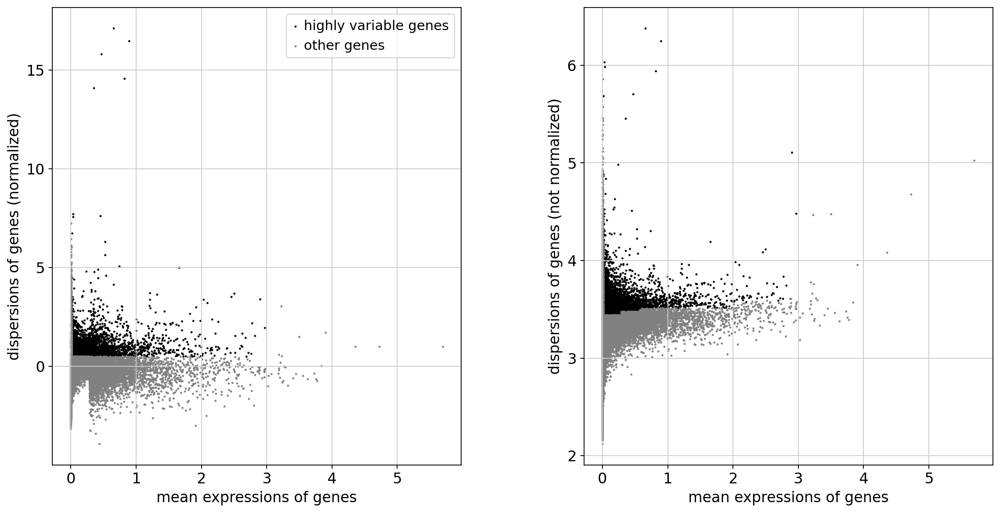

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:20:00)
computing PCA
    with n_comps=50
    finished (0:03:10)


2024-08-27 02:42:13,794 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 02:42:13,794 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 02:43:30,530 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 02:43:30,530 - INFO - sklearn.KMeans initialization complete.
2024-08-27 02:43:32,681 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 02:43:32,681 - INFO - Iteration 1 of 10
2024-08-27 02:47:57,584 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 02:47:57,584 - INFO - Iteration 2 of 10
2024-08-27 02:52:46,618 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 02:52:46,618 - INFO - Iteration 3 of 10
2024-08-27 02:54:54,564 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 02:54:54,564 - INFO - Iteration 4 of 10
2024-08-27 02:55:58,675 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 02:55:58,675 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:47)
Error: HZ12M01-name 'cm' is not defined
Error: HZ12M01-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ12M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


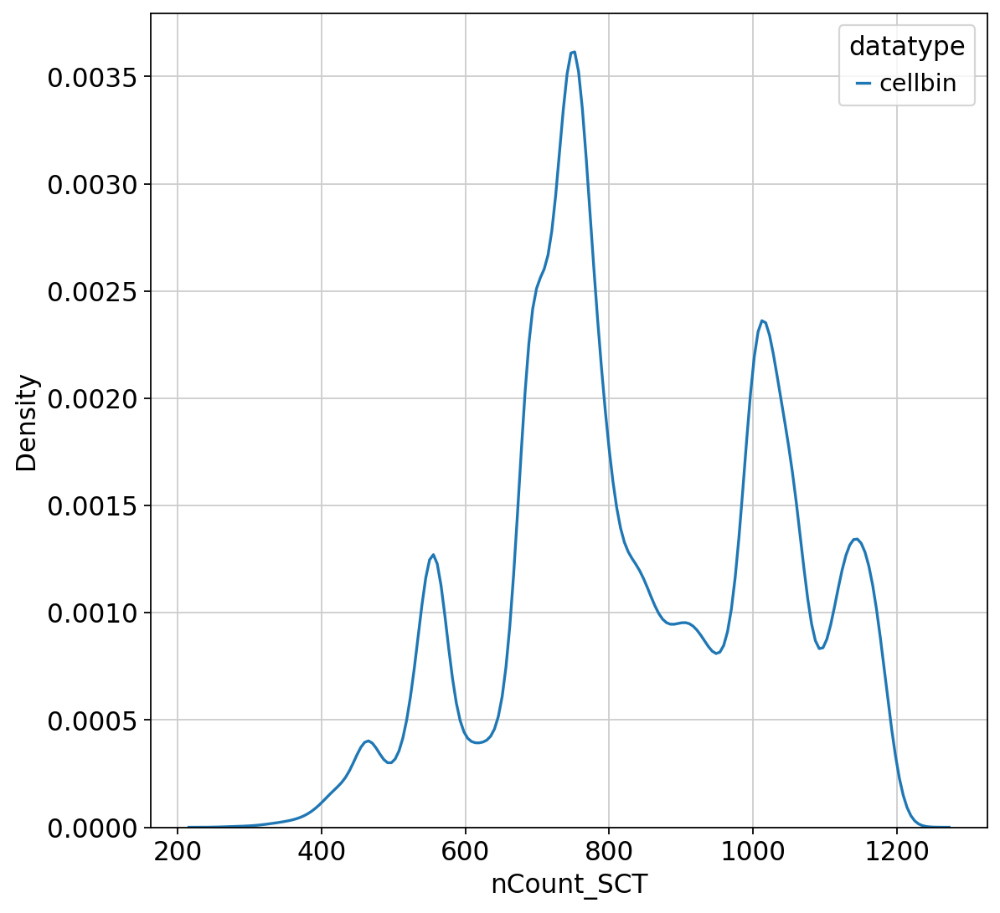

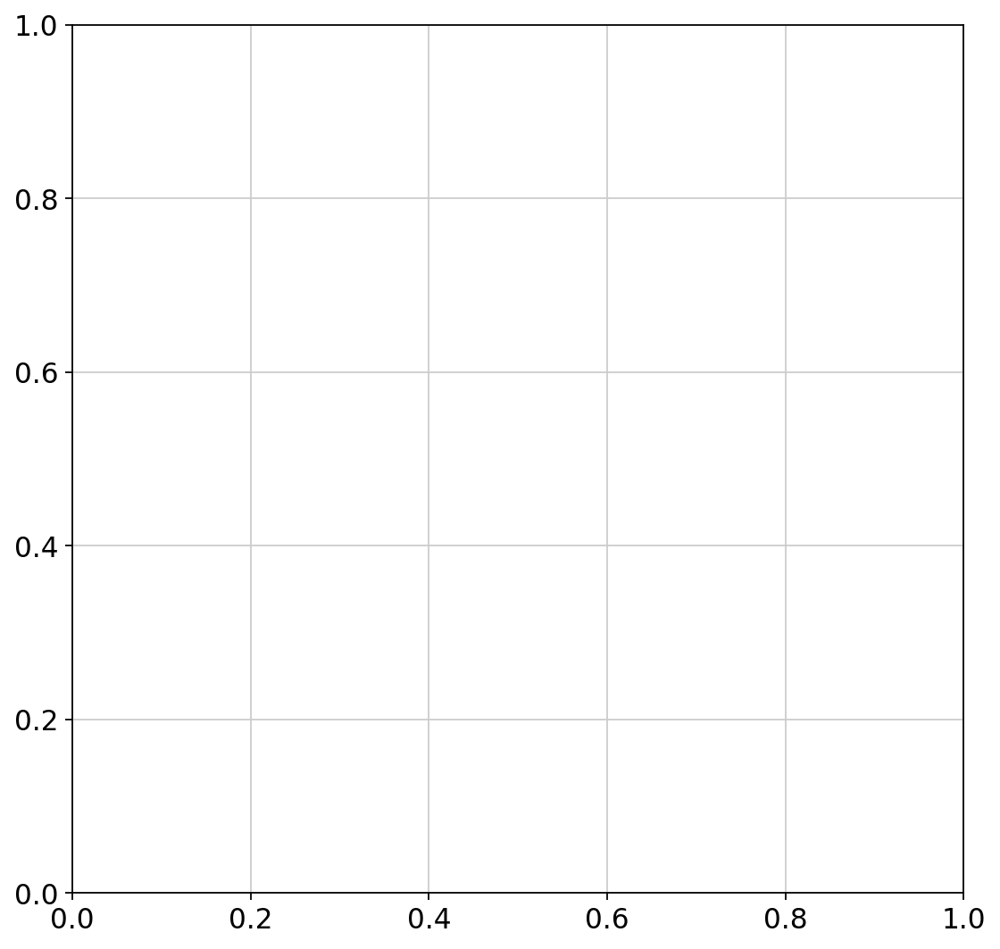

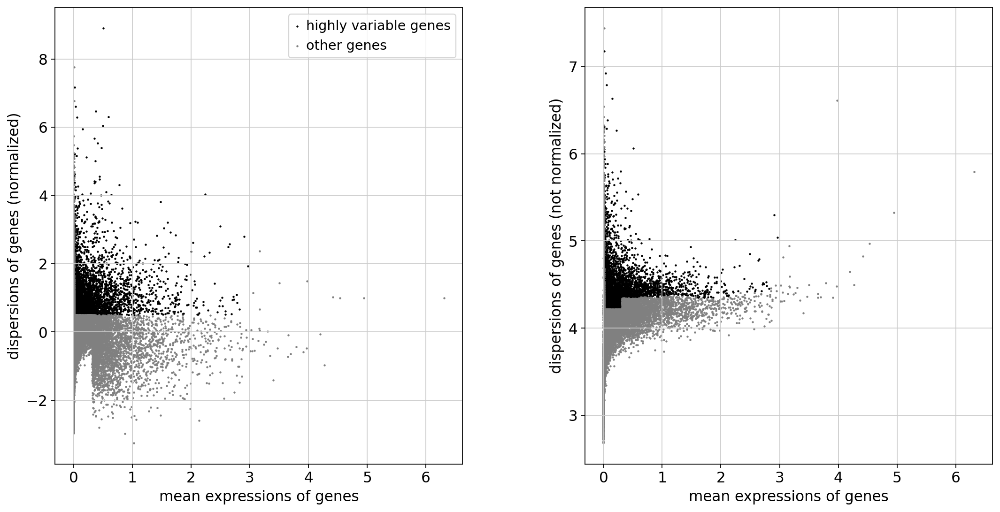

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:46:00)
computing PCA
    with n_comps=50
    finished (0:05:02)


2024-08-27 04:59:30,164 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 04:59:30,164 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 05:00:13,187 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 05:00:13,187 - INFO - sklearn.KMeans initialization complete.
2024-08-27 05:00:17,879 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 05:00:17,879 - INFO - Iteration 1 of 10
2024-08-27 05:05:25,153 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 05:05:25,153 - INFO - Iteration 2 of 10
2024-08-27 05:10:23,170 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 05:10:23,170 - INFO - Iteration 3 of 10
2024-08-27 05:15:29,375 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 05:15:29,375 - INFO - Iteration 4 of 10
2024-08-27 05:17:02,164 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 05:17:02,164 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:10:27)
Error: HZ12M02-name 'cm' is not defined
Error: HZ12M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ12M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


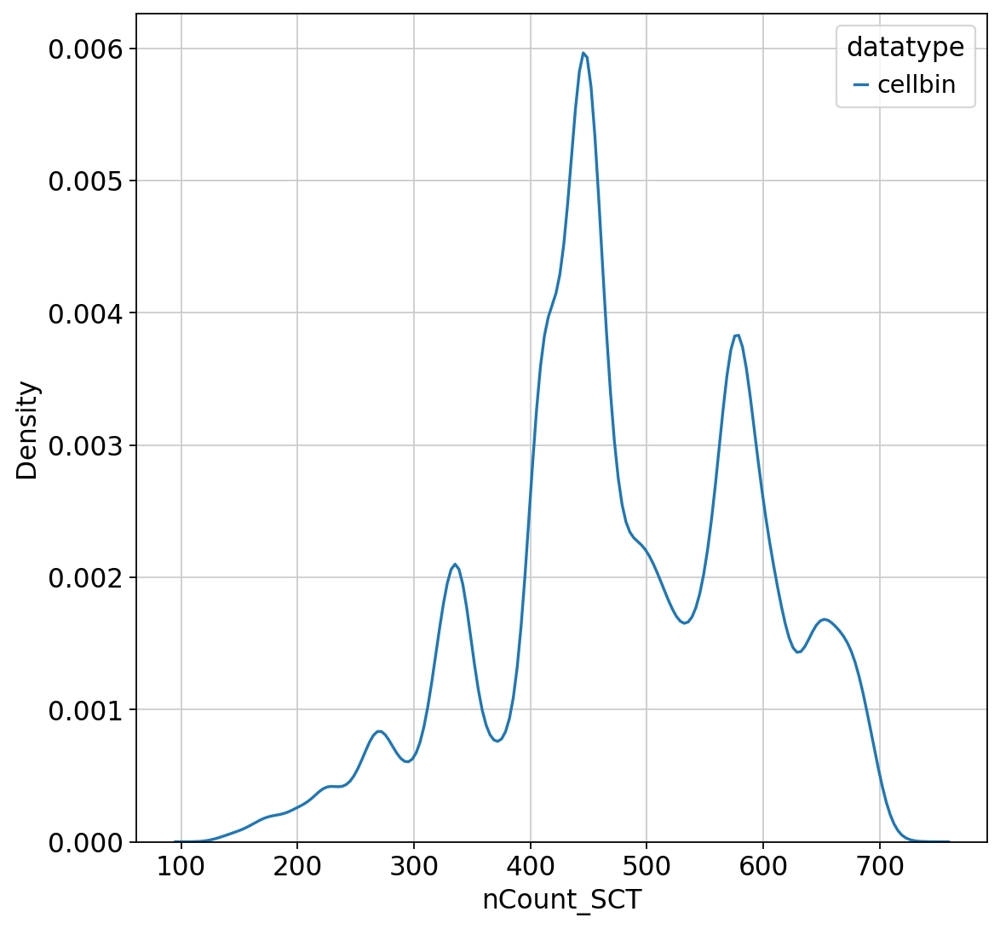

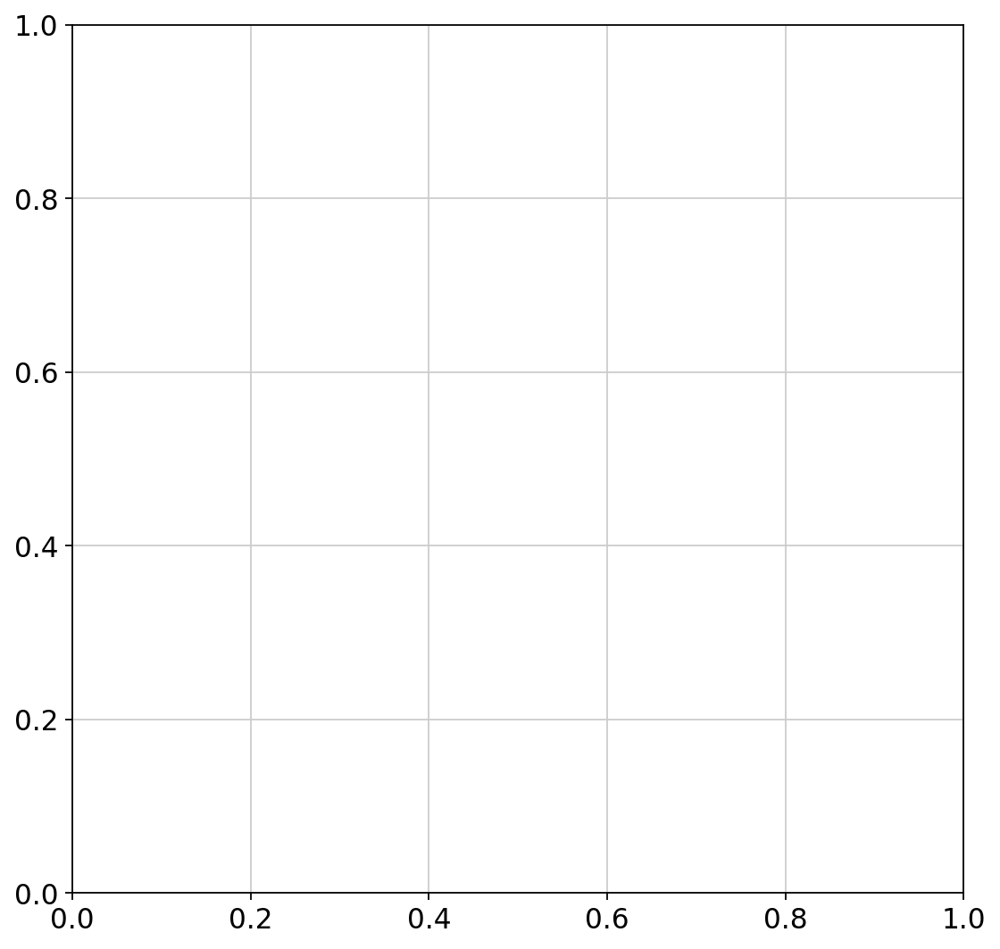

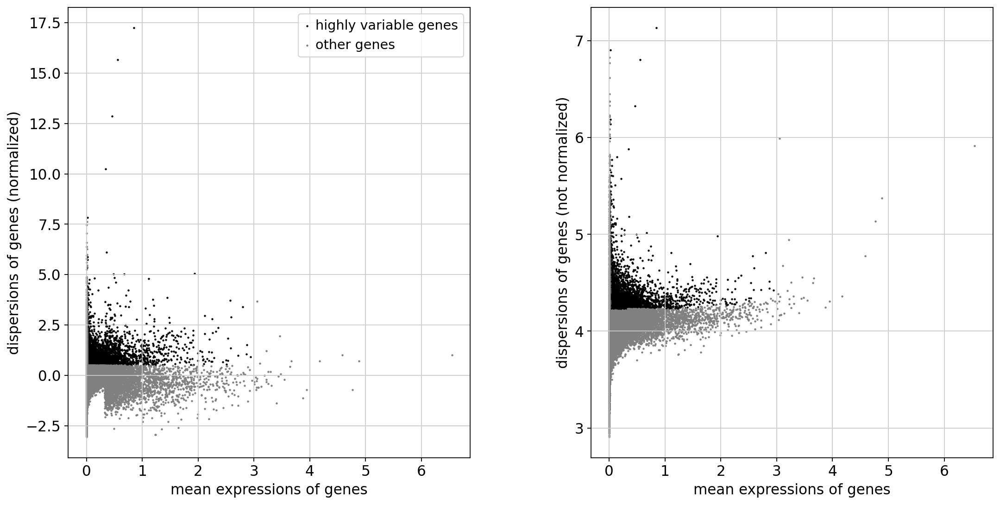

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:52:20)
computing PCA
    with n_comps=50
    finished (0:03:40)


2024-08-27 06:28:06,676 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 06:28:06,676 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 06:28:47,906 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 06:28:47,906 - INFO - sklearn.KMeans initialization complete.
2024-08-27 06:28:51,275 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 06:28:51,275 - INFO - Iteration 1 of 10
2024-08-27 06:33:05,084 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 06:33:05,084 - INFO - Iteration 2 of 10
2024-08-27 06:37:14,560 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 06:37:14,560 - INFO - Iteration 3 of 10
2024-08-27 06:40:08,278 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 06:40:08,278 - INFO - Iteration 4 of 10
2024-08-27 06:41:28,503 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 06:41:28,503 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:32)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:55)
Error: HZ12M03-name 'cm' is not defined
Error: HZ12M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ12M04 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


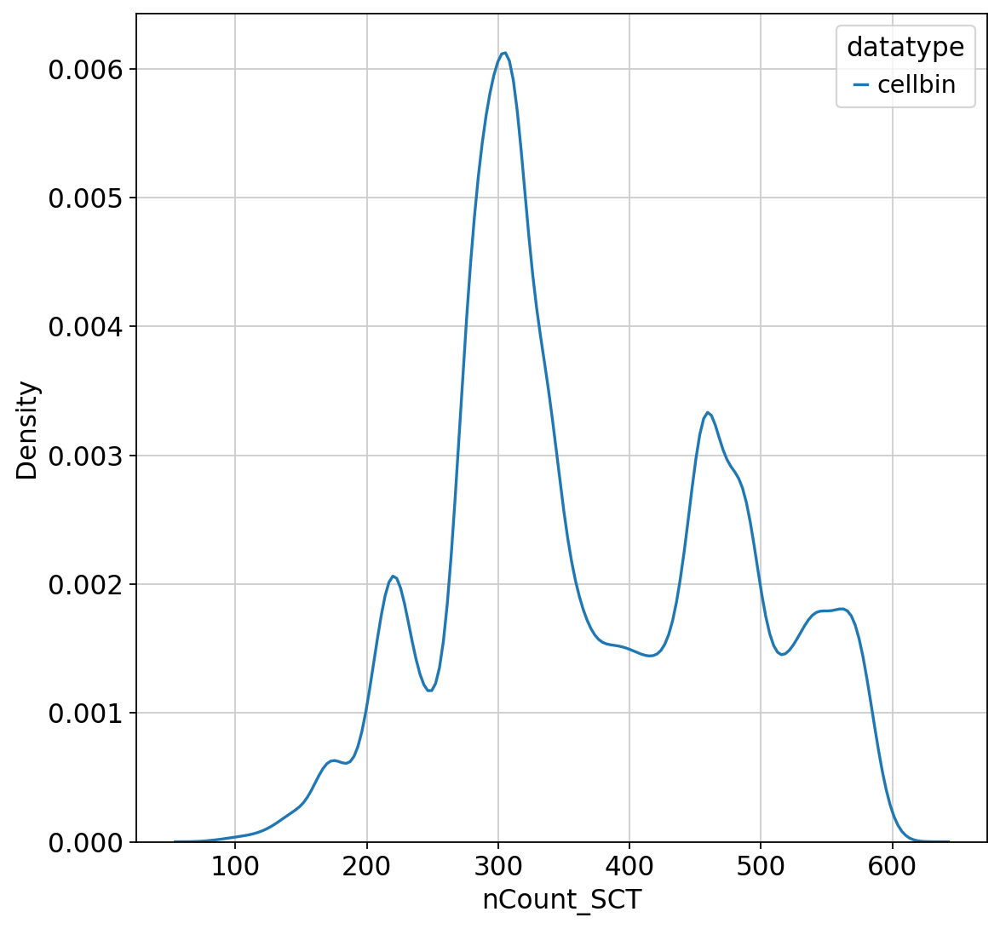

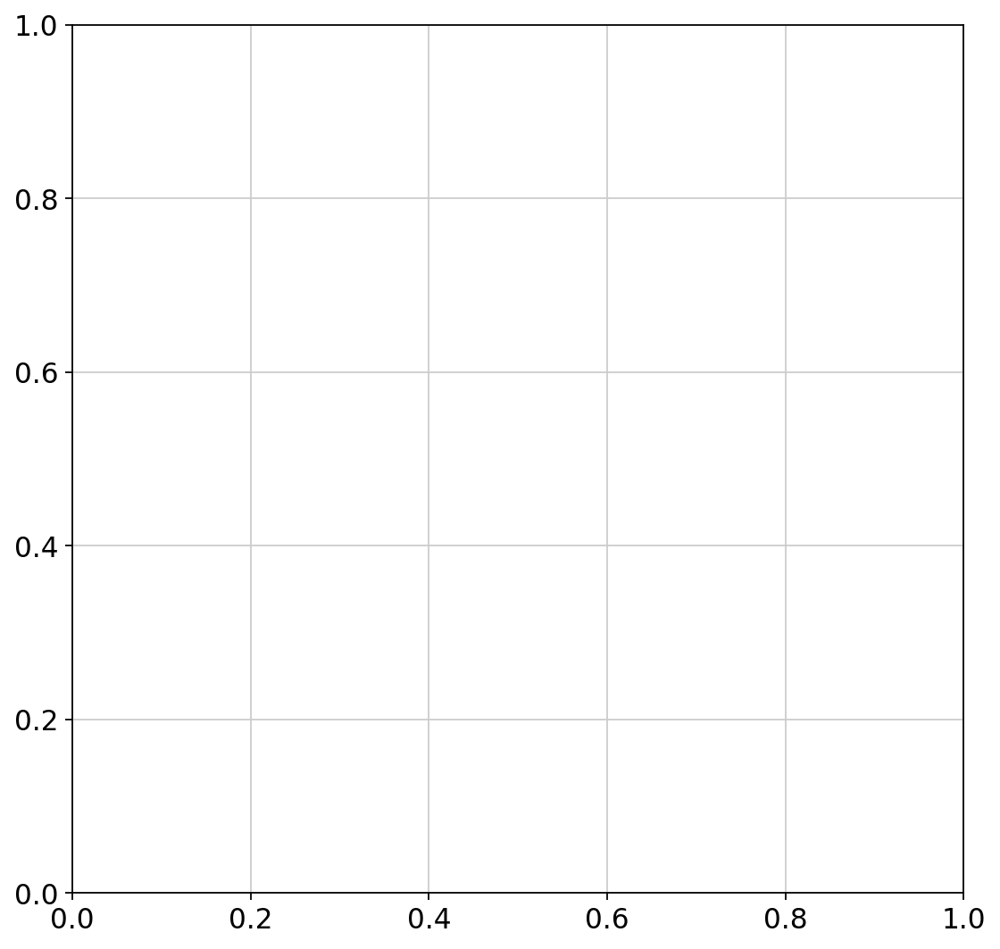

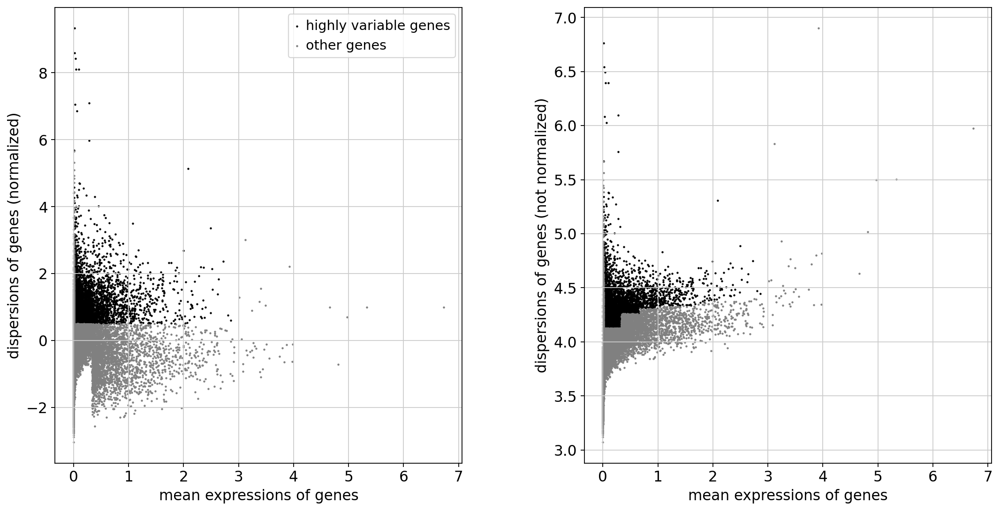

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:29:50)
computing PCA
    with n_comps=50
    finished (0:06:14)


2024-08-27 08:29:15,072 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 08:29:15,072 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 08:30:04,468 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 08:30:04,468 - INFO - sklearn.KMeans initialization complete.
2024-08-27 08:30:08,310 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 08:30:08,310 - INFO - Iteration 1 of 10
2024-08-27 08:34:58,102 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 08:34:58,102 - INFO - Iteration 2 of 10
2024-08-27 08:40:01,086 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 08:40:01,086 - INFO - Iteration 3 of 10
2024-08-27 08:43:10,216 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 08:43:10,216 - INFO - Iteration 4 of 10
2024-08-27 08:44:44,700 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 08:44:44,700 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:39)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:09:27)
Error: HZ12M04-name 'cm' is not defined
Error: HZ12M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ12M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


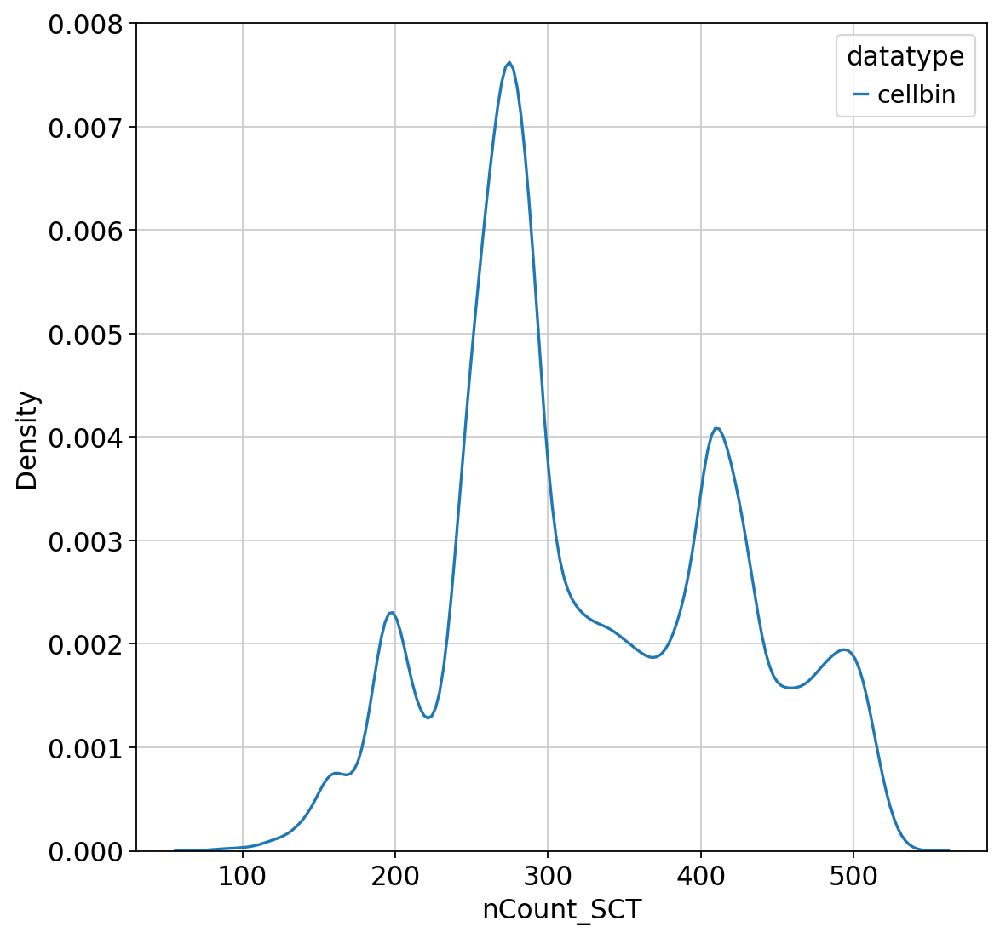

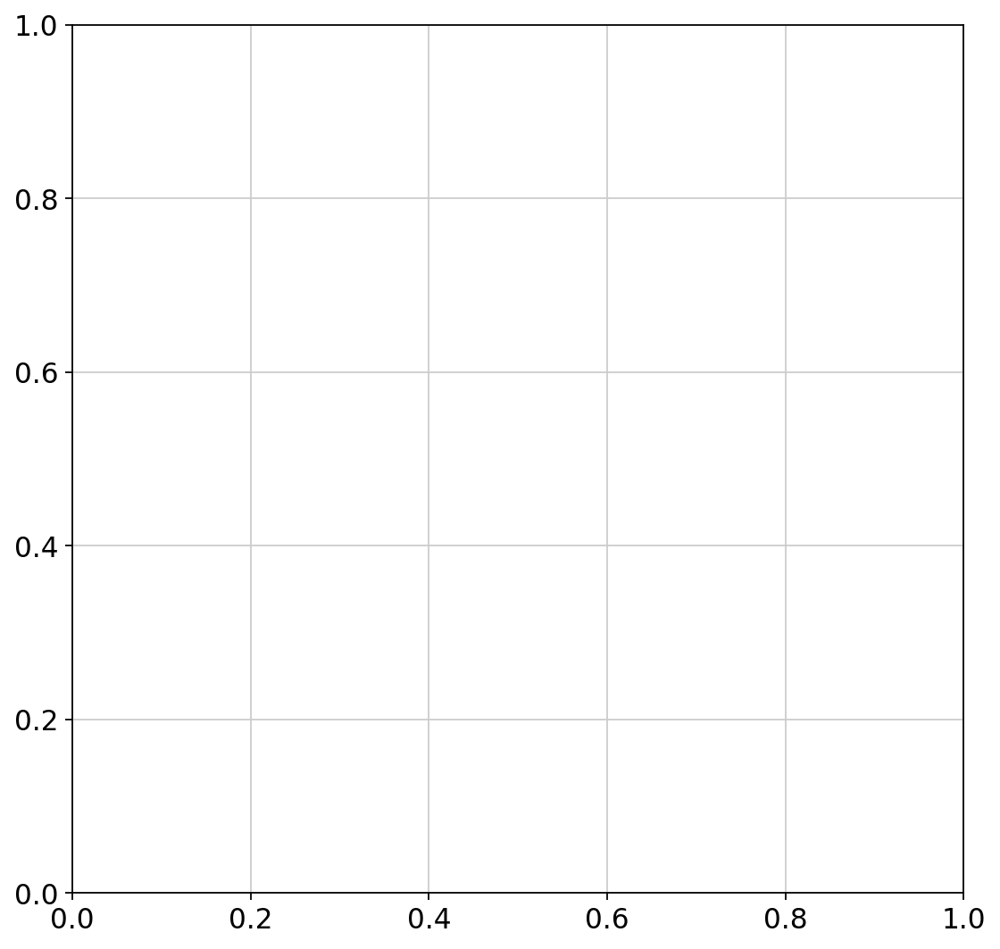

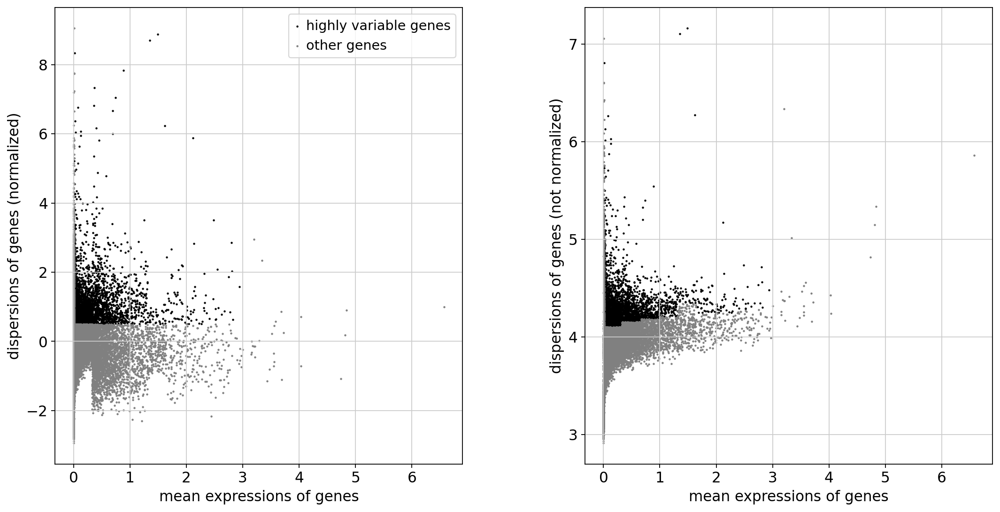

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:51:28)
computing PCA
    with n_comps=50
    finished (0:04:10)


2024-08-27 09:53:49,335 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 09:53:49,335 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 09:54:48,709 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 09:54:48,709 - INFO - sklearn.KMeans initialization complete.
2024-08-27 09:54:51,762 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 09:54:51,762 - INFO - Iteration 1 of 10
2024-08-27 09:58:53,918 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 09:58:53,918 - INFO - Iteration 2 of 10
2024-08-27 10:02:50,319 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 10:02:50,319 - INFO - Iteration 3 of 10
2024-08-27 10:06:47,976 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 10:06:47,976 - INFO - Iteration 4 of 10
2024-08-27 10:08:57,134 - harmonypy - INFO - Iteration 5 of 10
2024-08-27 10:08:57,134 - INFO - Iteration 5 of 10
2024-08-27 10:10:09,456 - harmonypy - INFO - Converged after 5 iterations
2024-08-27 10:10:0

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:28)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:57)
Error: HZ12M05-name 'cm' is not defined
Error: HZ12M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ12M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


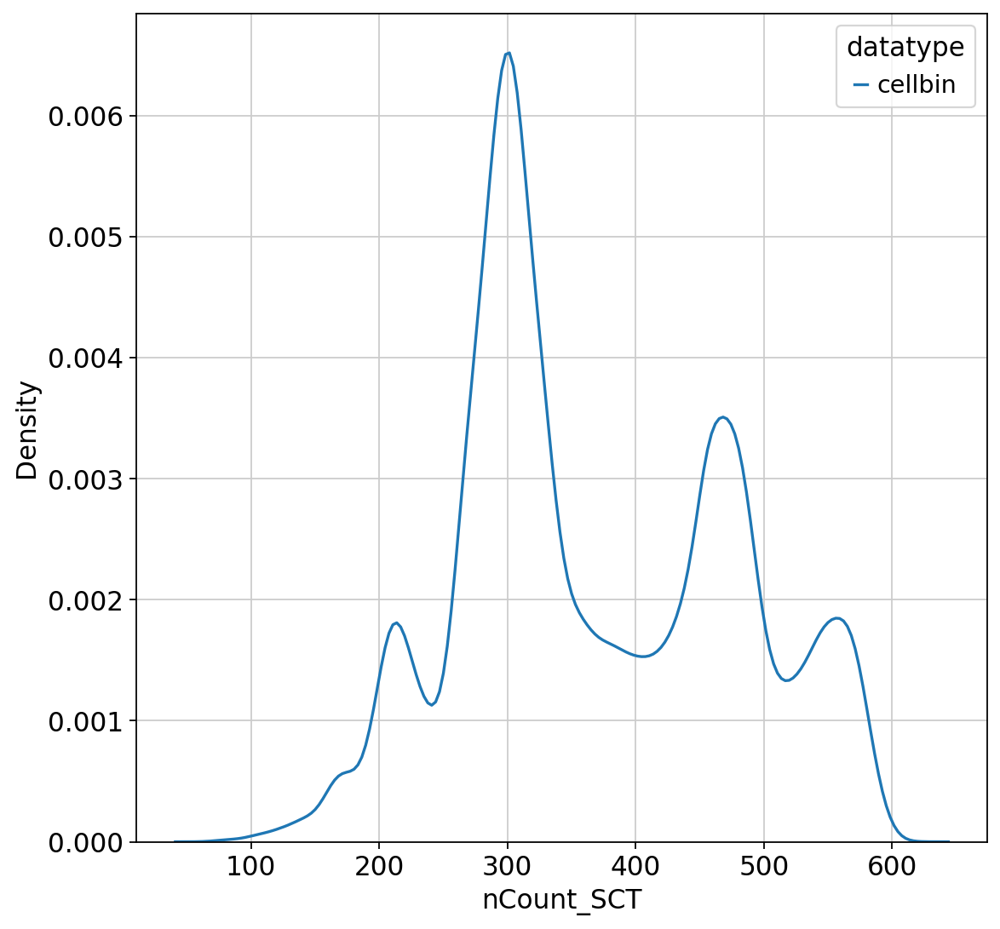

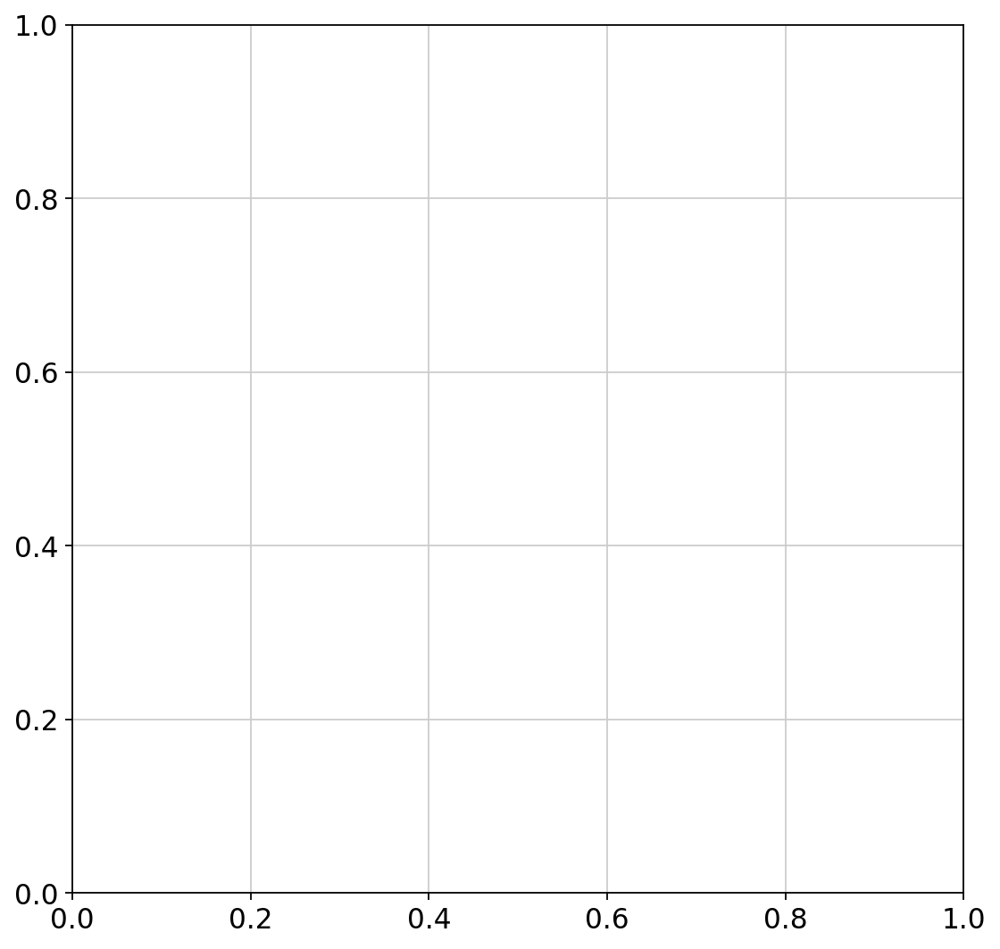

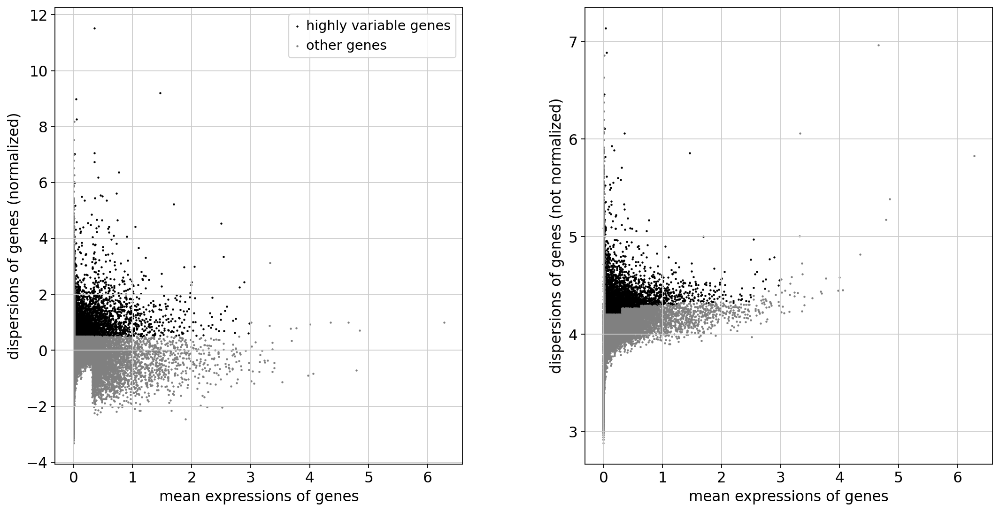

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:22:04)
computing PCA
    with n_comps=50
    finished (0:05:37)


2024-08-27 11:50:30,078 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 11:50:30,078 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 11:51:36,984 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 11:51:36,984 - INFO - sklearn.KMeans initialization complete.
2024-08-27 11:51:42,360 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 11:51:42,360 - INFO - Iteration 1 of 10
2024-08-27 11:59:58,802 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 11:59:58,802 - INFO - Iteration 2 of 10
2024-08-27 12:06:59,160 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 12:06:59,160 - INFO - Iteration 3 of 10
2024-08-27 12:09:04,321 - harmonypy - INFO - Converged after 3 iterations
2024-08-27 12:09:04,321 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:13:07)
Error: HZ12M06-name 'cm' is not defined
Error: HZ12M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


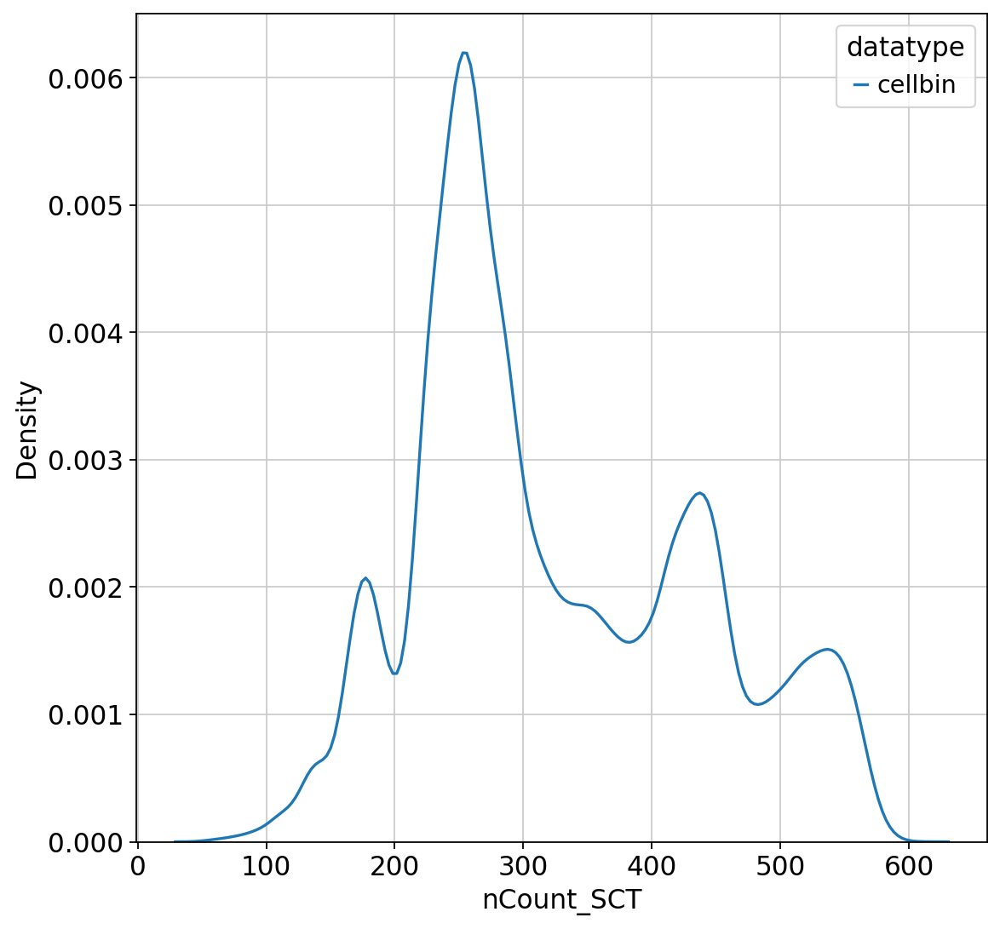

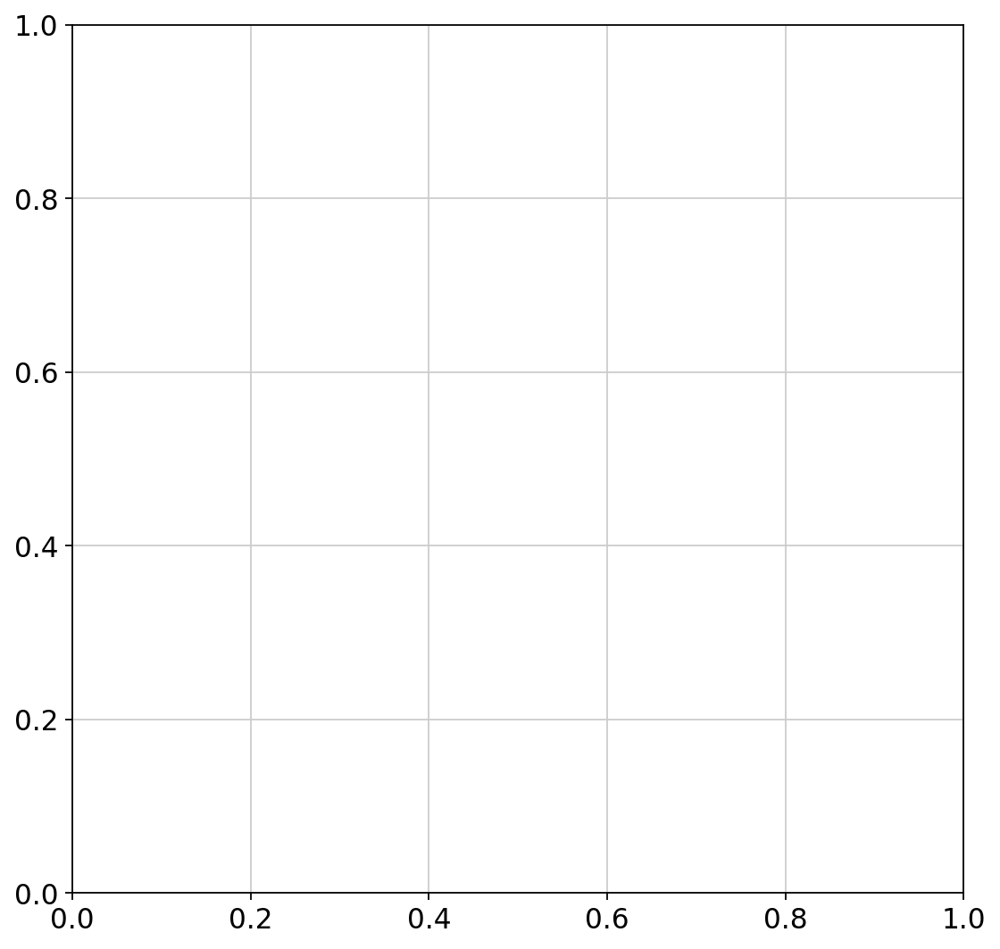

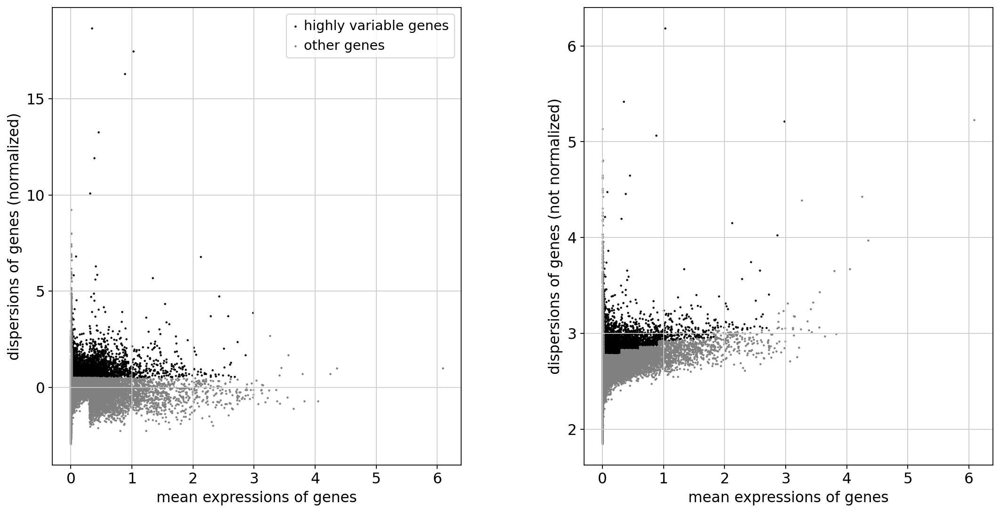

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:49:05)
computing PCA
    with n_comps=50
    finished (0:02:54)


2024-08-27 13:18:39,591 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 13:18:39,591 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 13:19:20,518 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 13:19:20,518 - INFO - sklearn.KMeans initialization complete.
2024-08-27 13:19:21,997 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 13:19:21,997 - INFO - Iteration 1 of 10
2024-08-27 13:22:01,859 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 13:22:01,859 - INFO - Iteration 2 of 10
2024-08-27 13:24:36,028 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 13:24:36,028 - INFO - Iteration 3 of 10
2024-08-27 13:26:11,958 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 13:26:11,958 - INFO - Iteration 4 of 10
2024-08-27 13:26:56,487 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 13:26:56,487 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:51)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:13)
Error: HZ2M01-name 'cm' is not defined
Error: HZ2M01-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


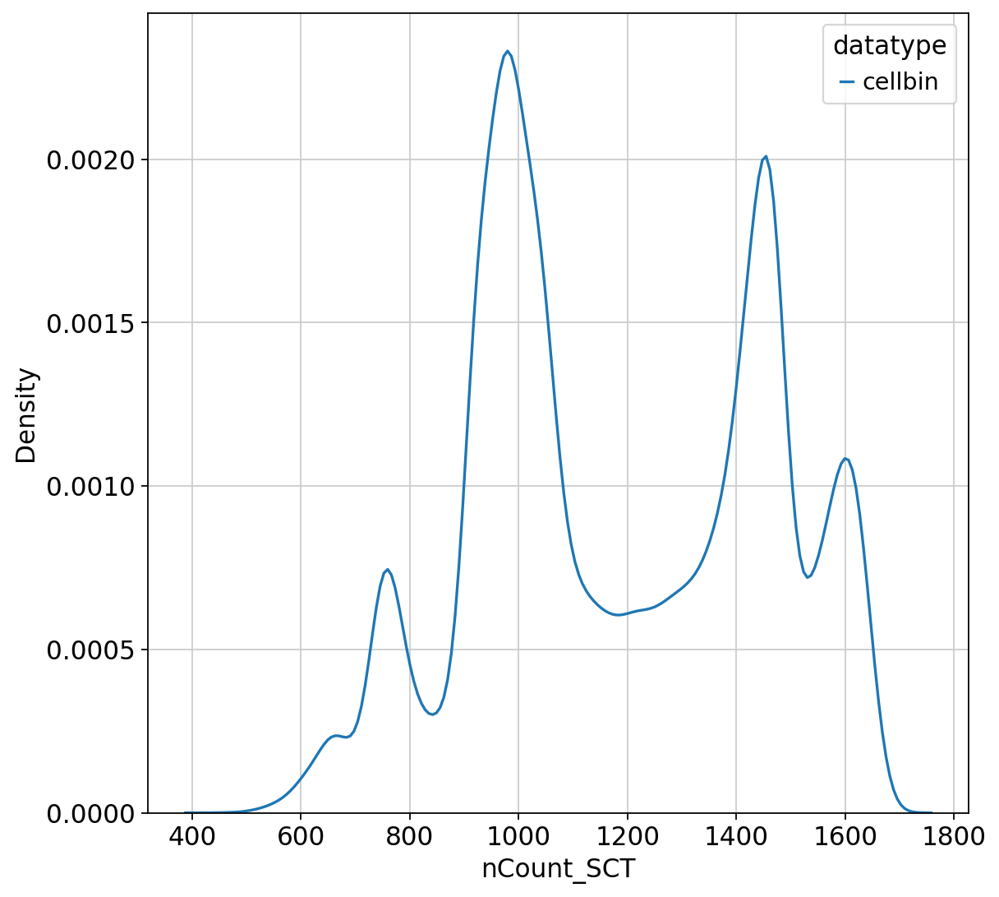

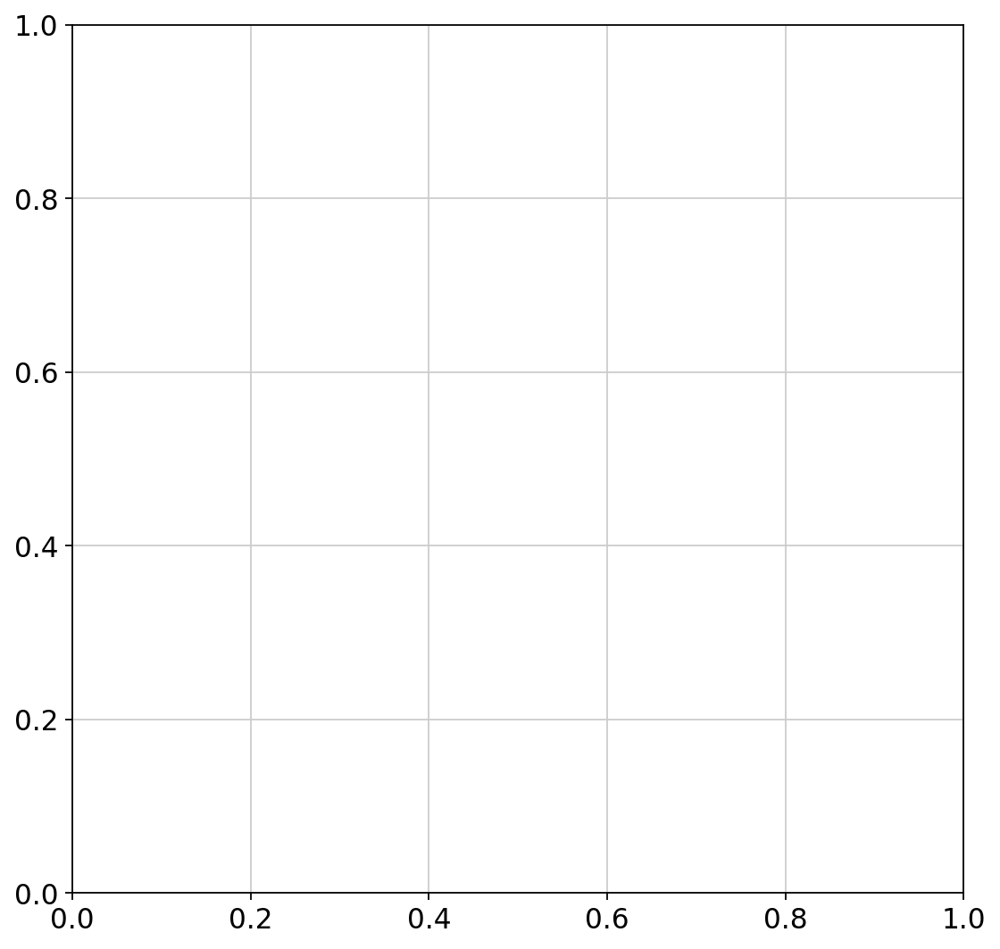

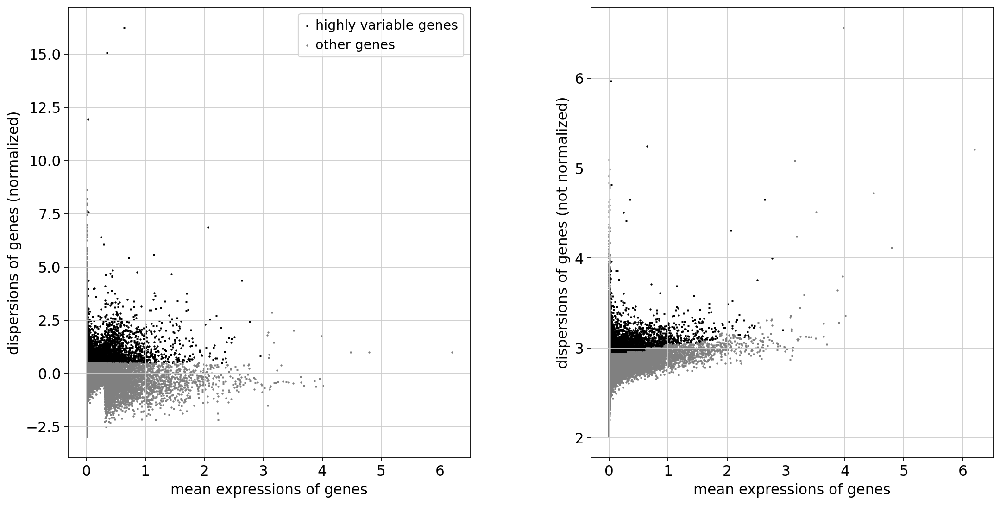

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:49:37)
computing PCA
    with n_comps=50
    finished (0:03:03)


2024-08-27 14:27:34,889 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 14:27:34,889 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 14:28:22,519 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 14:28:22,519 - INFO - sklearn.KMeans initialization complete.
2024-08-27 14:28:24,488 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 14:28:24,488 - INFO - Iteration 1 of 10
2024-08-27 14:31:50,206 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 14:31:50,206 - INFO - Iteration 2 of 10
2024-08-27 14:35:02,544 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 14:35:02,544 - INFO - Iteration 3 of 10
2024-08-27 14:35:57,671 - harmonypy - INFO - Converged after 3 iterations
2024-08-27 14:35:57,671 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:34)
Error: HZ2M02-name 'cm' is not defined
Error: HZ2M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M03 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


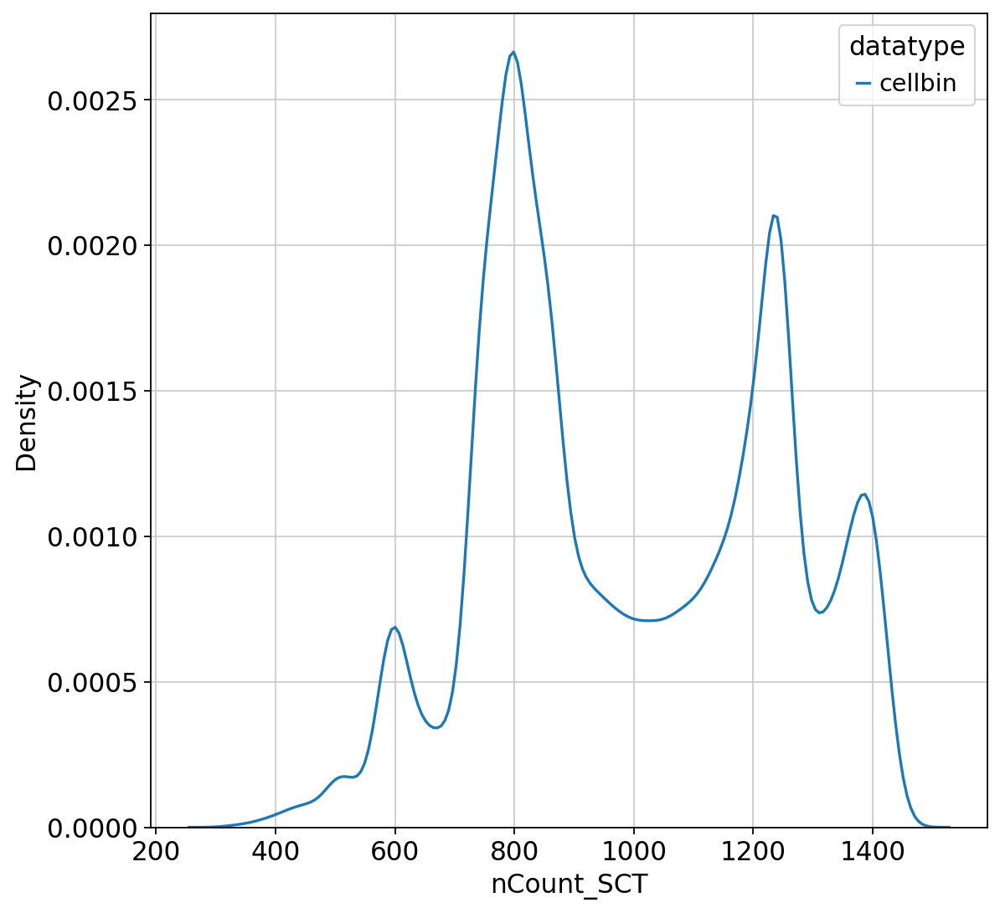

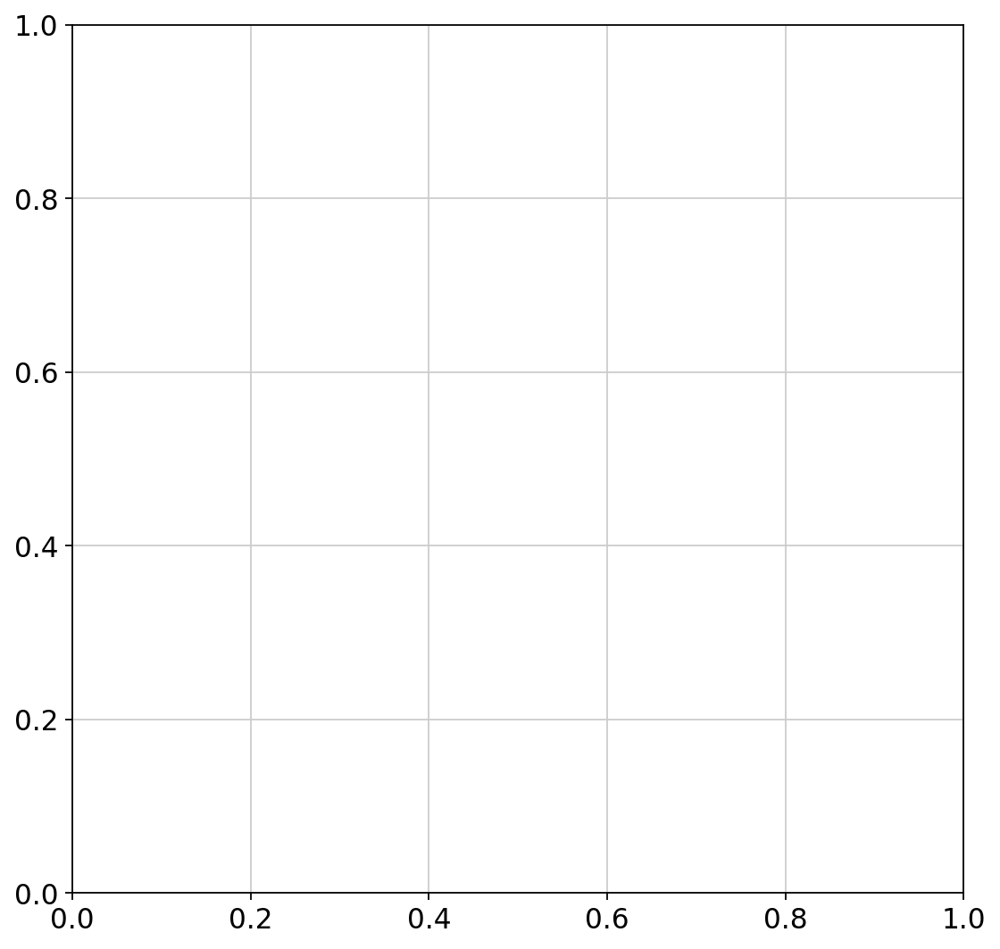

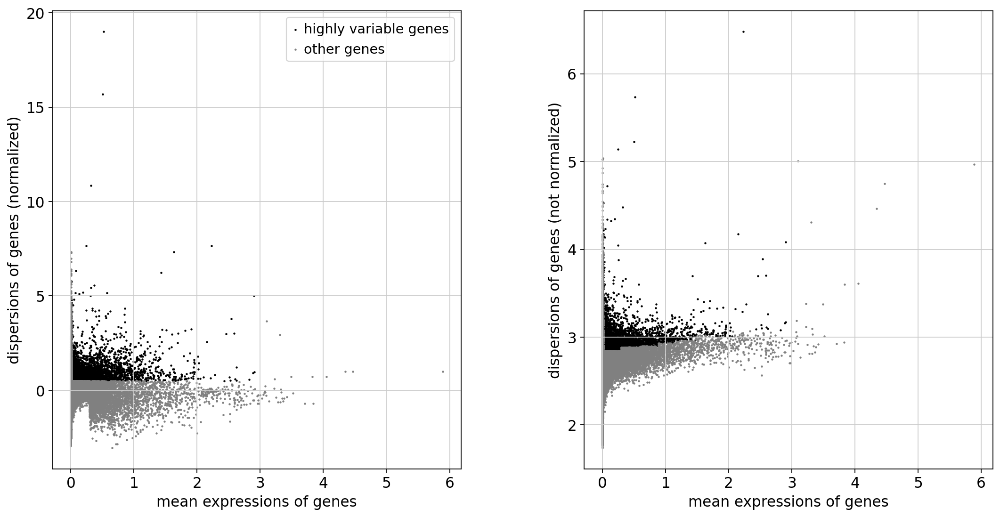

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:31:56)
computing PCA
    with n_comps=50
    finished (0:02:50)


2024-08-27 15:20:24,240 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 15:20:24,240 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 15:21:03,095 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 15:21:03,095 - INFO - sklearn.KMeans initialization complete.
2024-08-27 15:21:04,330 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 15:21:04,330 - INFO - Iteration 1 of 10
2024-08-27 15:23:25,927 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 15:23:25,927 - INFO - Iteration 2 of 10
2024-08-27 15:25:38,698 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 15:25:38,698 - INFO - Iteration 3 of 10
2024-08-27 15:26:26,599 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 15:26:26,599 - INFO - Iteration 4 of 10
2024-08-27 15:27:05,476 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 15:27:05,476 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:46)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:44)
Error: HZ2M03-name 'cm' is not defined
Error: HZ2M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:04)
extracting highly variable genes
    finished (0:00:08)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


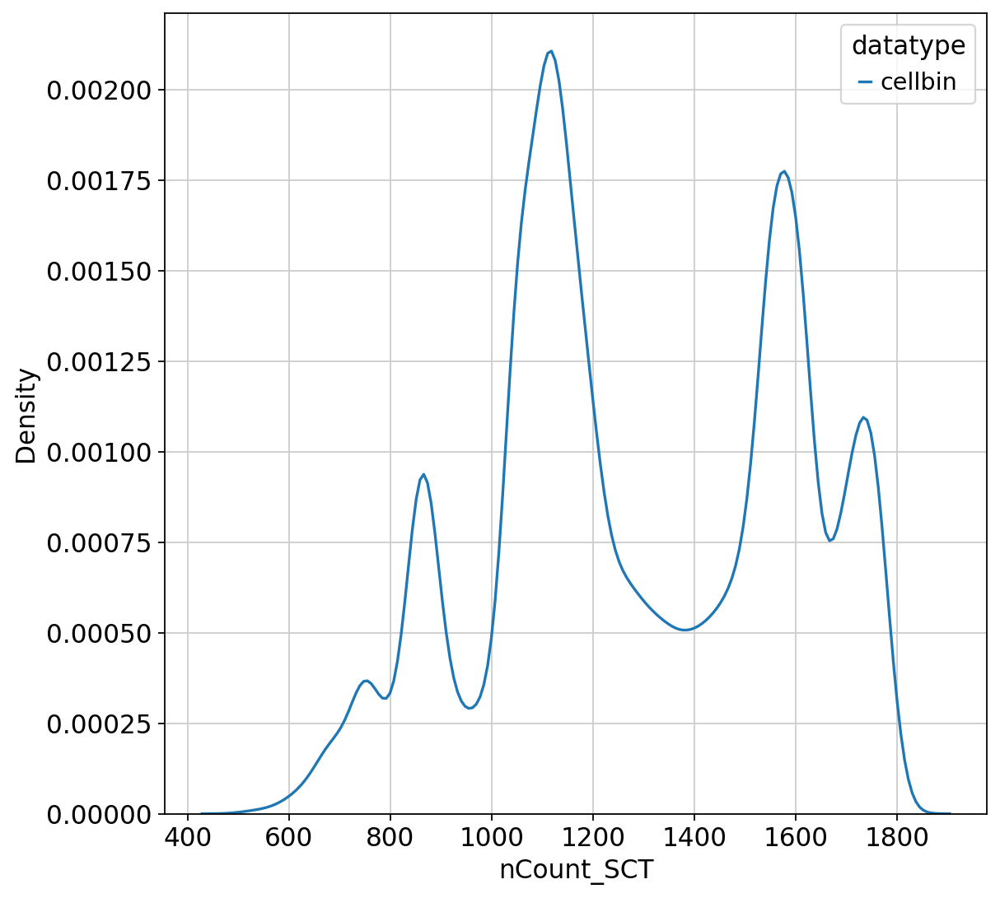

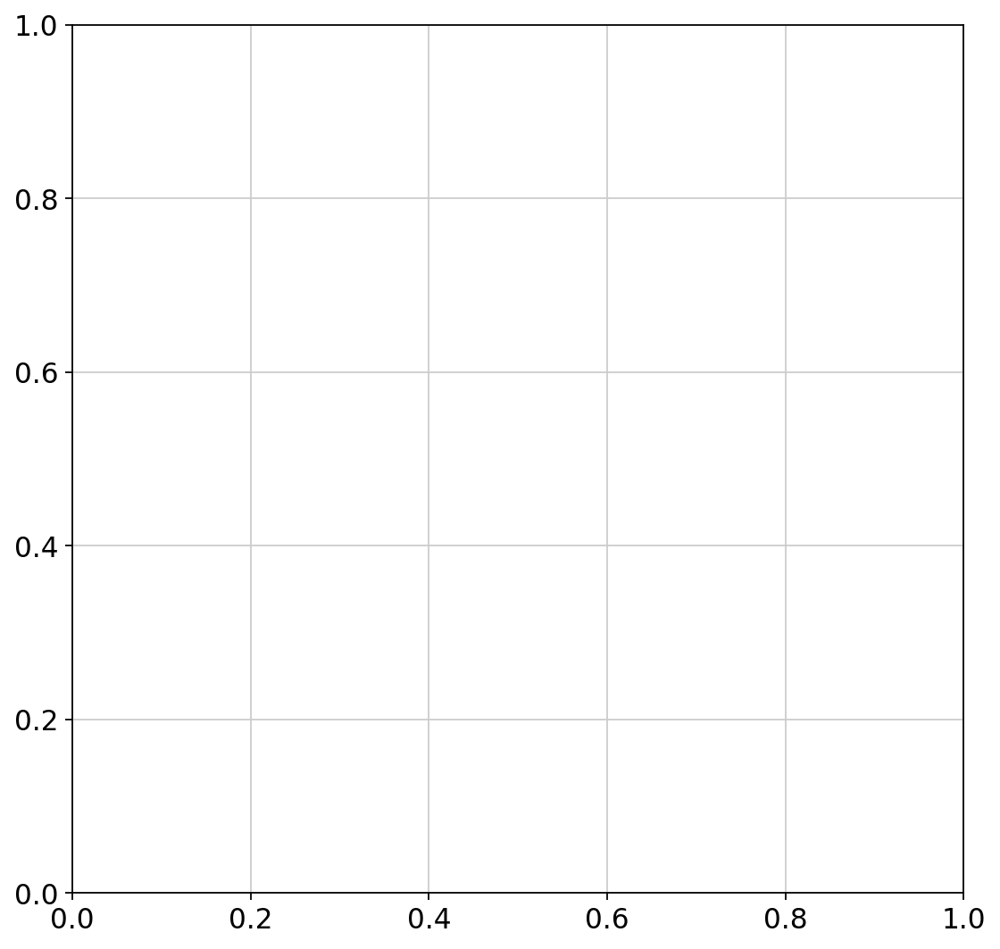

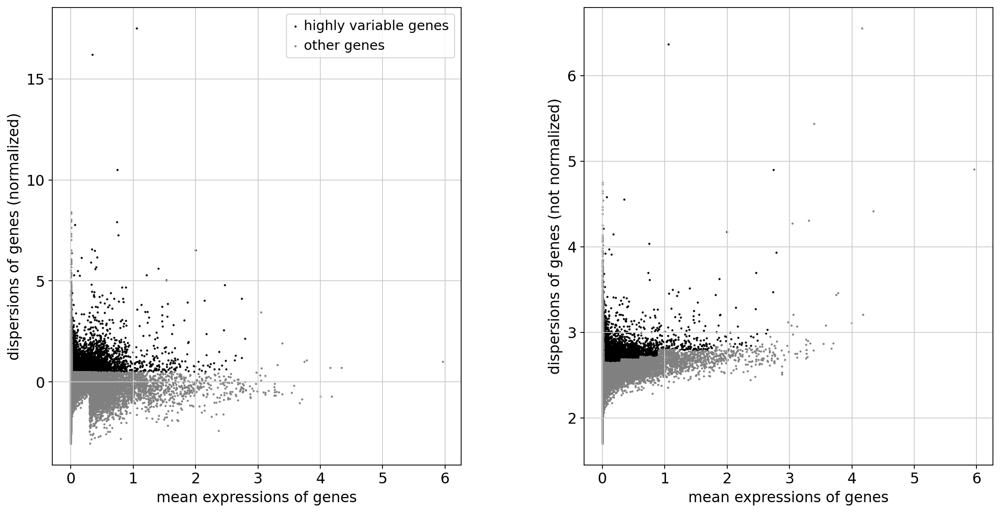

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:57:58)
computing PCA
    with n_comps=50
    finished (0:02:40)


2024-08-27 16:35:21,479 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 16:35:21,479 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 16:36:01,580 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 16:36:01,580 - INFO - sklearn.KMeans initialization complete.
2024-08-27 16:36:04,924 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 16:36:04,924 - INFO - Iteration 1 of 10
2024-08-27 16:40:10,747 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 16:40:10,747 - INFO - Iteration 2 of 10
2024-08-27 16:43:49,307 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 16:43:49,307 - INFO - Iteration 3 of 10
2024-08-27 16:46:27,325 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 16:46:27,325 - INFO - Iteration 4 of 10
2024-08-27 16:47:30,444 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 16:47:30,444 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:01)
Error: HZ2M04-name 'cm' is not defined
Error: HZ2M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


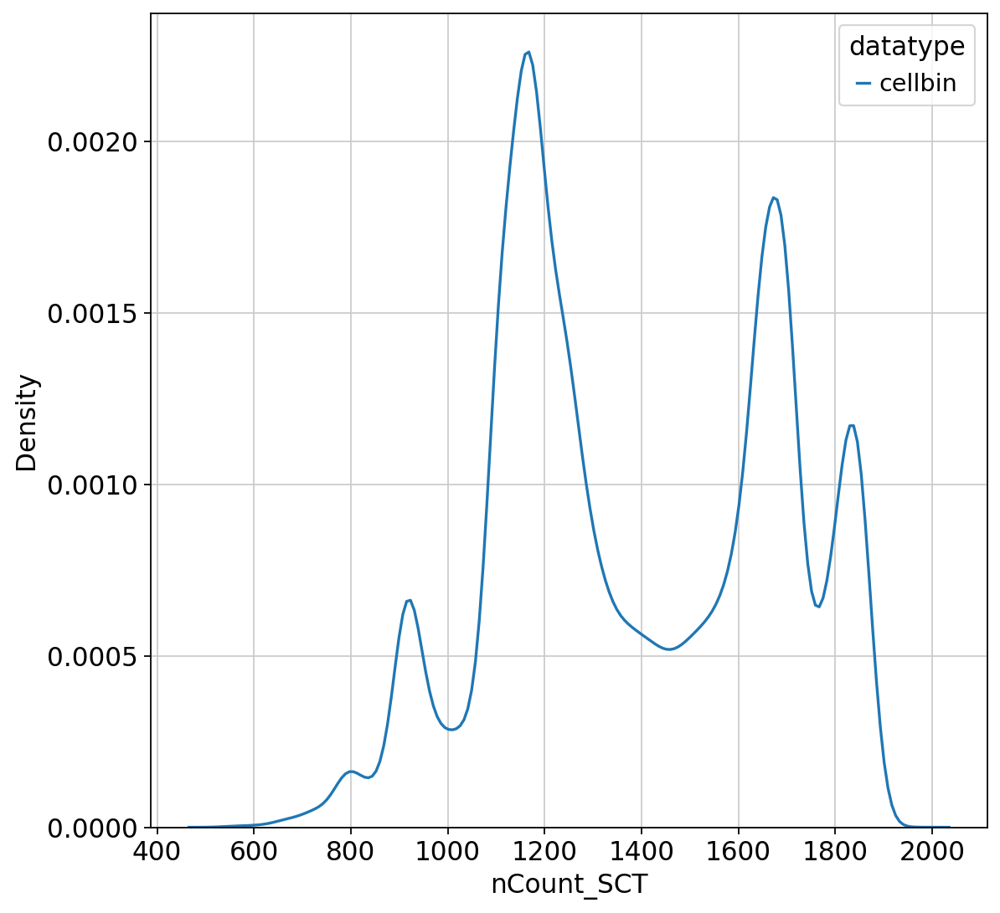

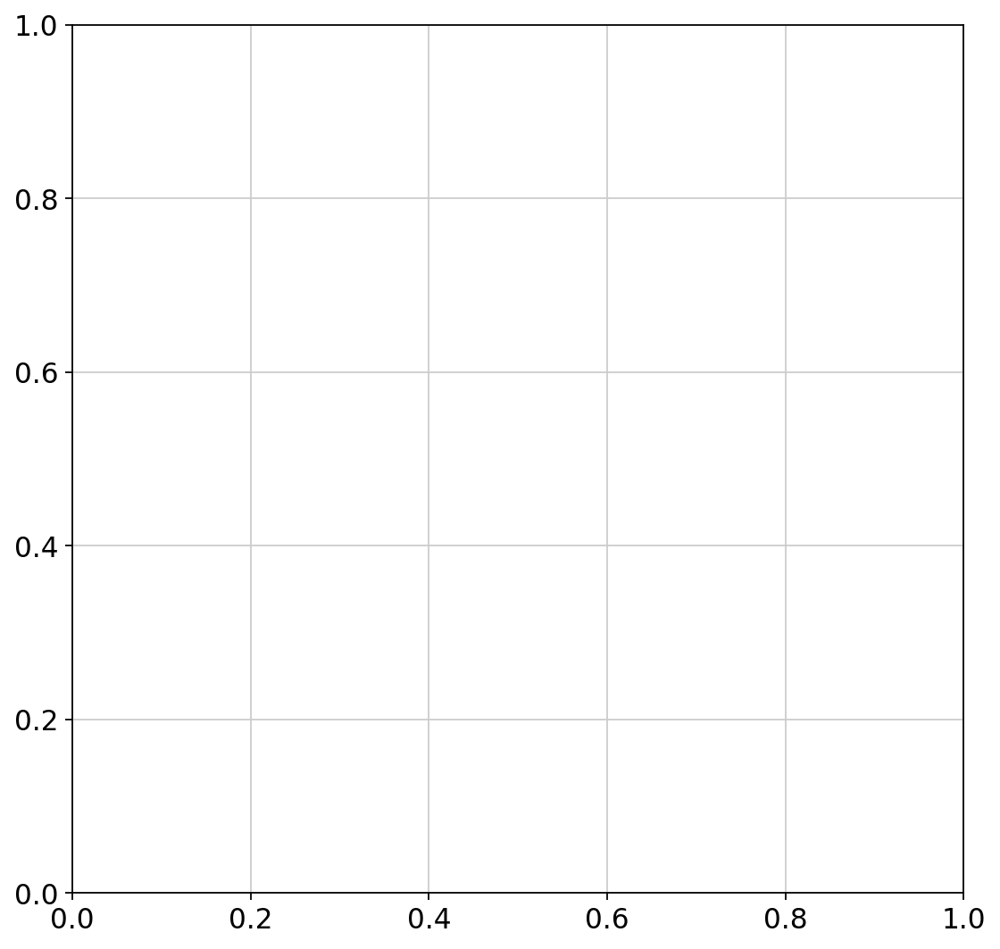

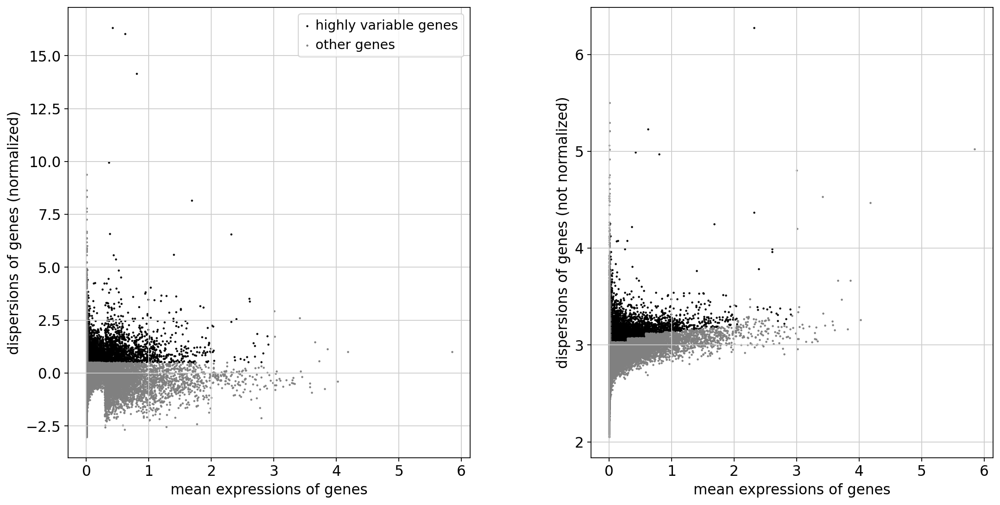

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:33:17)
computing PCA
    with n_comps=50
    finished (0:03:04)


2024-08-27 17:32:52,473 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 17:32:52,473 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 17:33:29,114 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 17:33:29,114 - INFO - sklearn.KMeans initialization complete.
2024-08-27 17:33:30,914 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 17:33:30,914 - INFO - Iteration 1 of 10
2024-08-27 17:36:01,402 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 17:36:01,402 - INFO - Iteration 2 of 10
2024-08-27 17:38:13,580 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 17:38:13,580 - INFO - Iteration 3 of 10
2024-08-27 17:39:28,290 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 17:39:28,290 - INFO - Iteration 4 of 10
2024-08-27 17:40:05,923 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 17:40:05,923 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:46)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:28)
Error: HZ2M05-name 'cm' is not defined
Error: HZ2M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ2M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


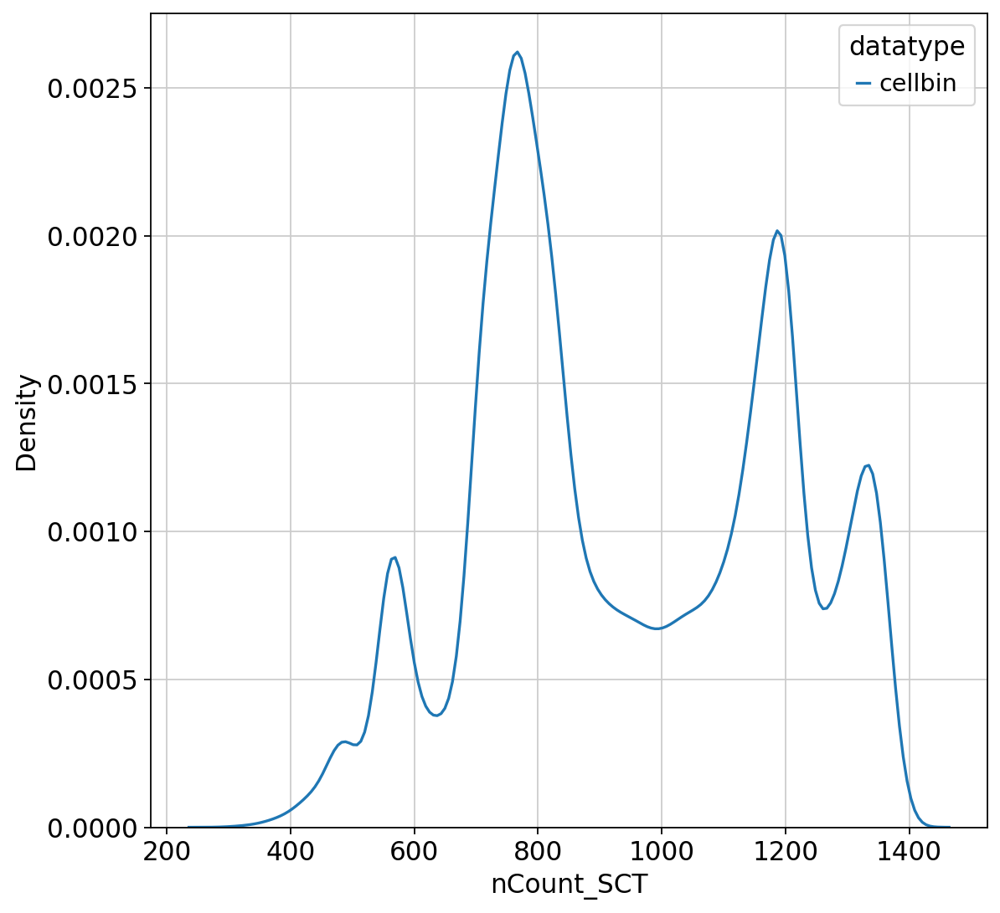

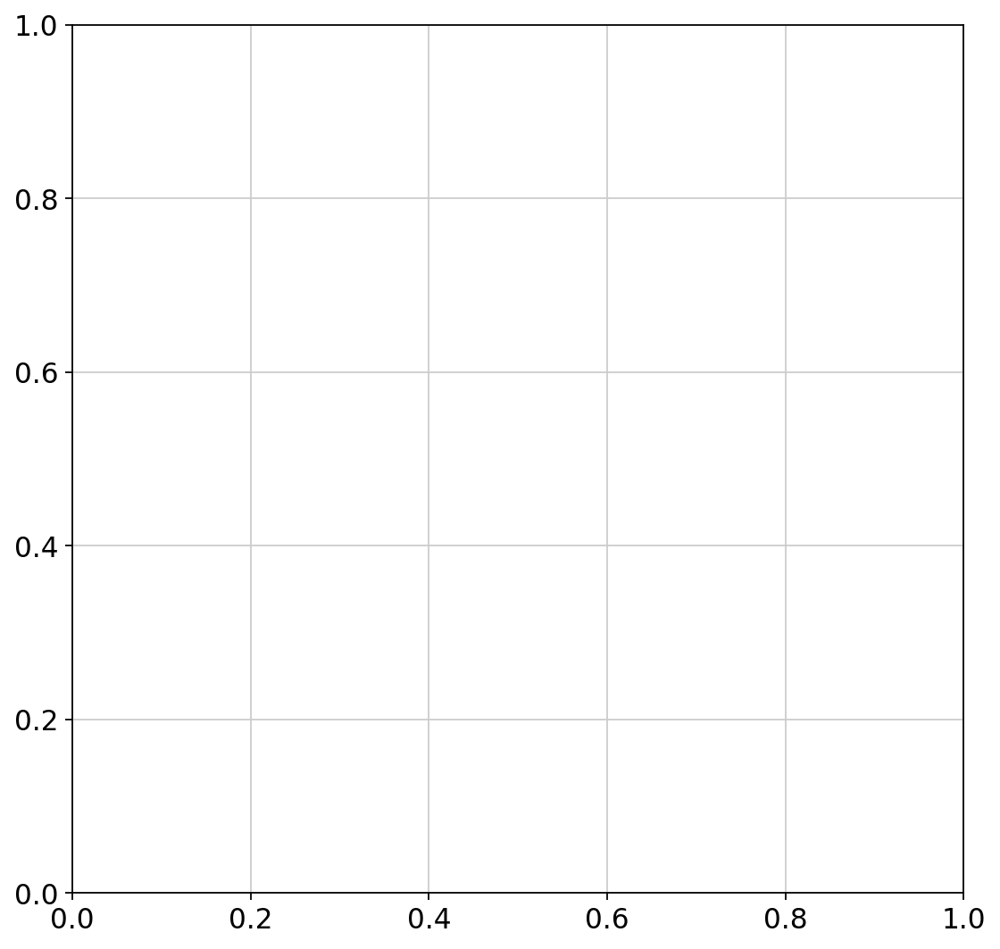

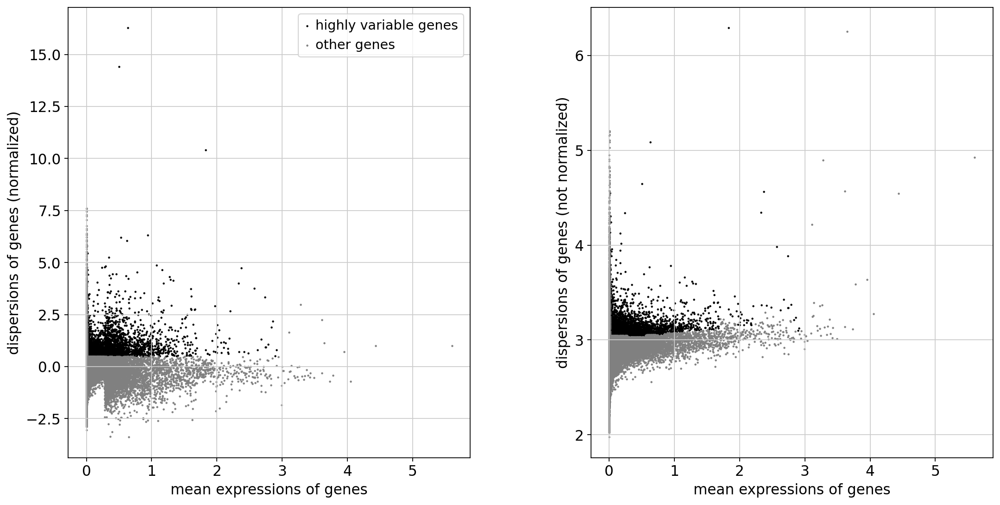

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:45:38)
computing PCA
    with n_comps=50
    finished (0:02:41)


2024-08-27 18:35:32,582 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 18:35:32,582 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 18:36:15,163 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 18:36:15,163 - INFO - sklearn.KMeans initialization complete.
2024-08-27 18:36:16,787 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 18:36:16,787 - INFO - Iteration 1 of 10
2024-08-27 18:39:05,925 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 18:39:05,925 - INFO - Iteration 2 of 10
2024-08-27 18:42:03,387 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 18:42:03,387 - INFO - Iteration 3 of 10
2024-08-27 18:44:48,502 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 18:44:48,502 - INFO - Iteration 4 of 10
2024-08-27 18:46:27,444 - harmonypy - INFO - Iteration 5 of 10
2024-08-27 18:46:27,444 - INFO - Iteration 5 of 10
2024-08-27 18:47:17,035 - harmonypy - INFO - Converged after 5 iterations
2024-08-27 18:47:1

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:54)
Error: HZ2M06-name 'cm' is not defined
Error: HZ2M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ3M01 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


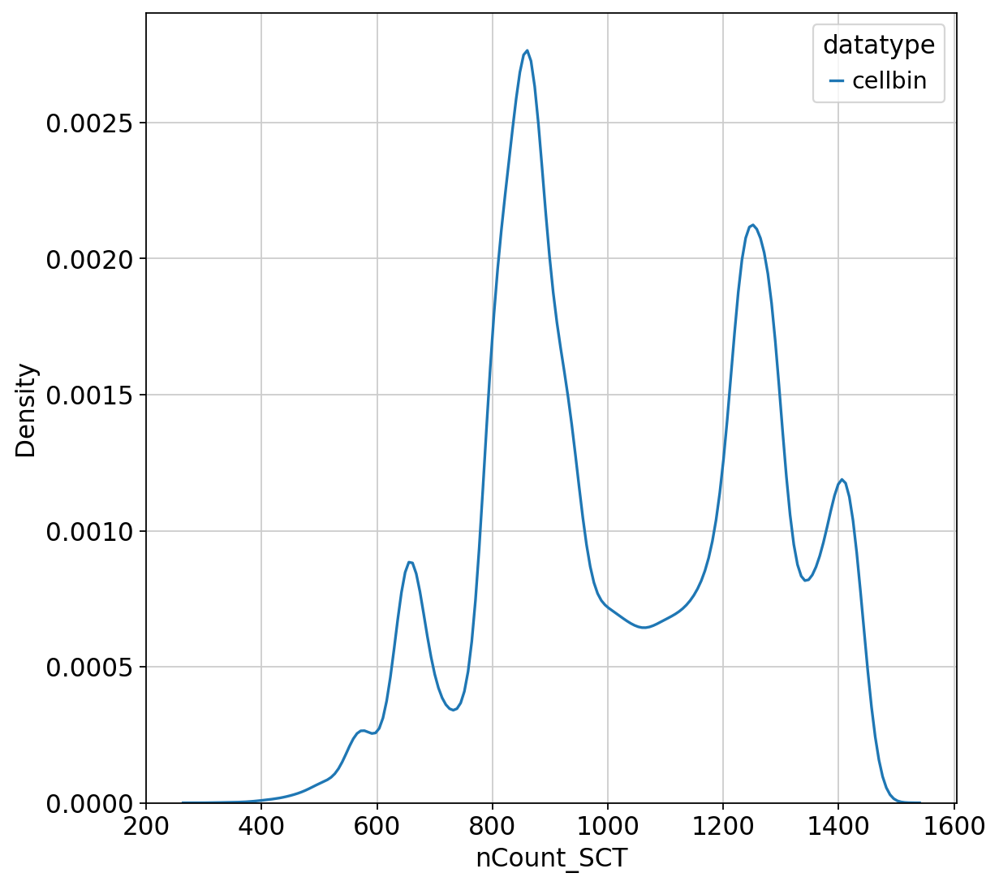

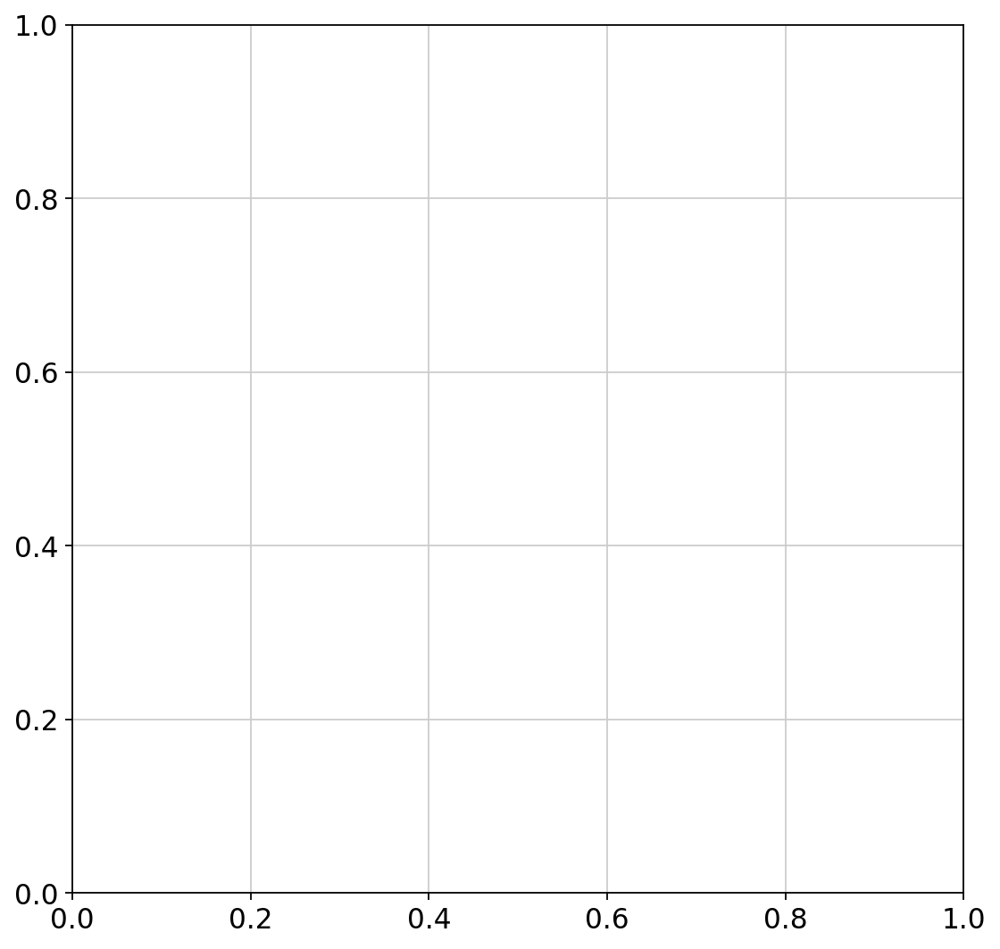

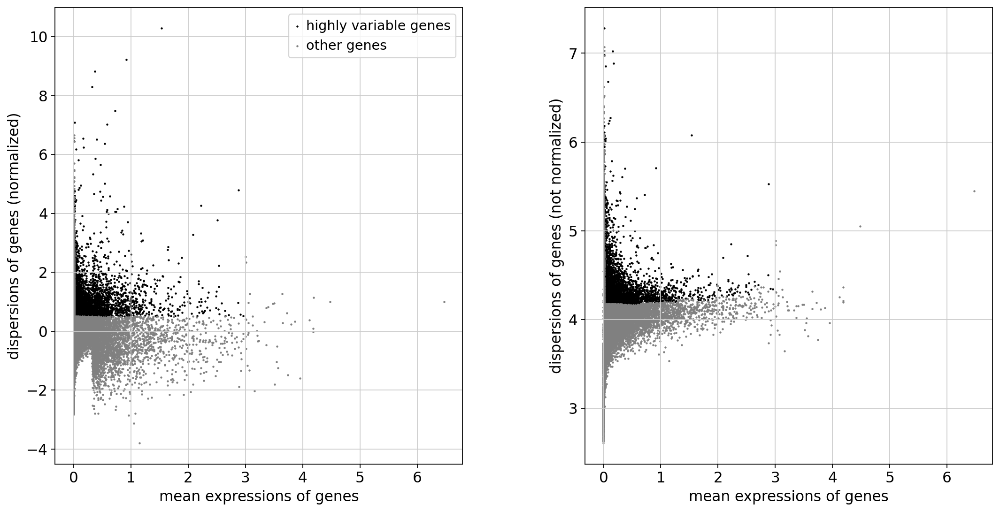

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:31:35)
computing PCA
    with n_comps=50
    finished (0:03:07)


2024-08-27 19:30:25,141 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 19:30:25,141 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 19:31:05,055 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 19:31:05,055 - INFO - sklearn.KMeans initialization complete.
2024-08-27 19:31:07,723 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 19:31:07,723 - INFO - Iteration 1 of 10
2024-08-27 19:34:34,281 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 19:34:34,281 - INFO - Iteration 2 of 10
2024-08-27 19:37:13,900 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 19:37:13,900 - INFO - Iteration 3 of 10
2024-08-27 19:39:57,455 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 19:39:57,455 - INFO - Iteration 4 of 10
2024-08-27 19:40:37,867 - harmonypy - INFO - Converged after 4 iterations
2024-08-27 19:40:37,867 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:55)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:54)
Error: HZ3M01-name 'cm' is not defined
Error: HZ3M01-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ3M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


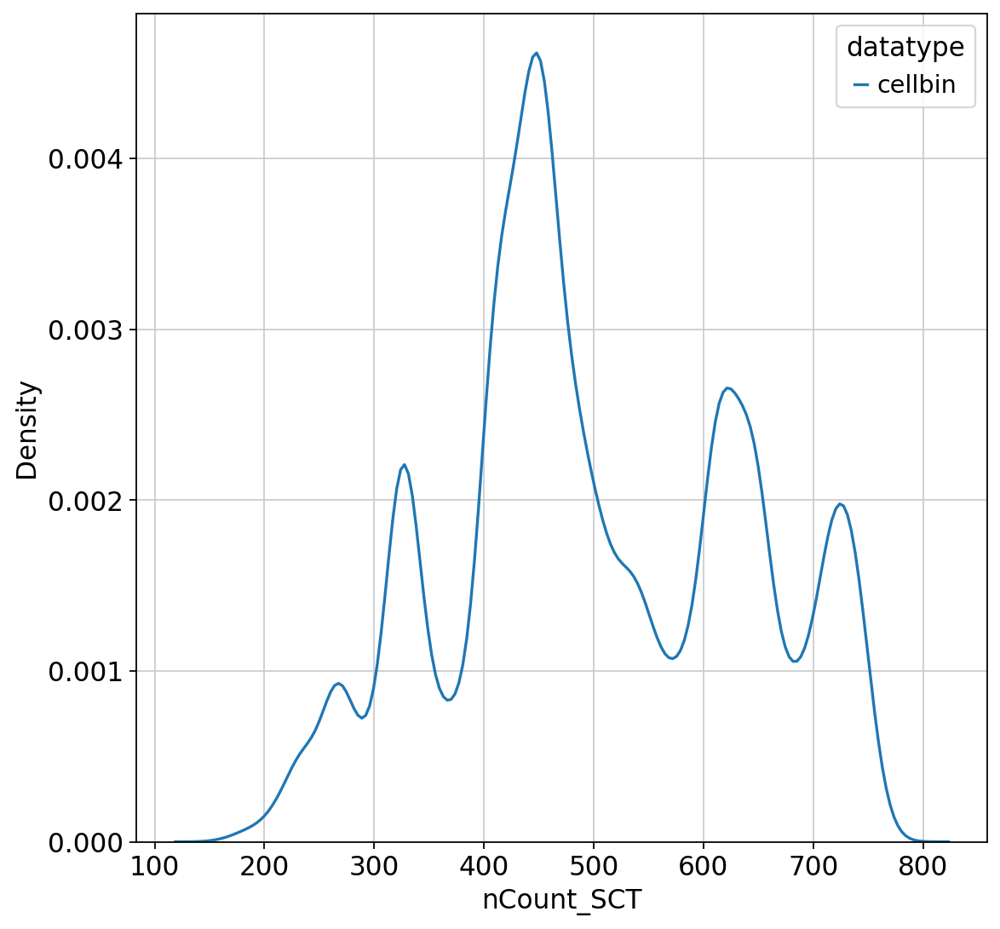

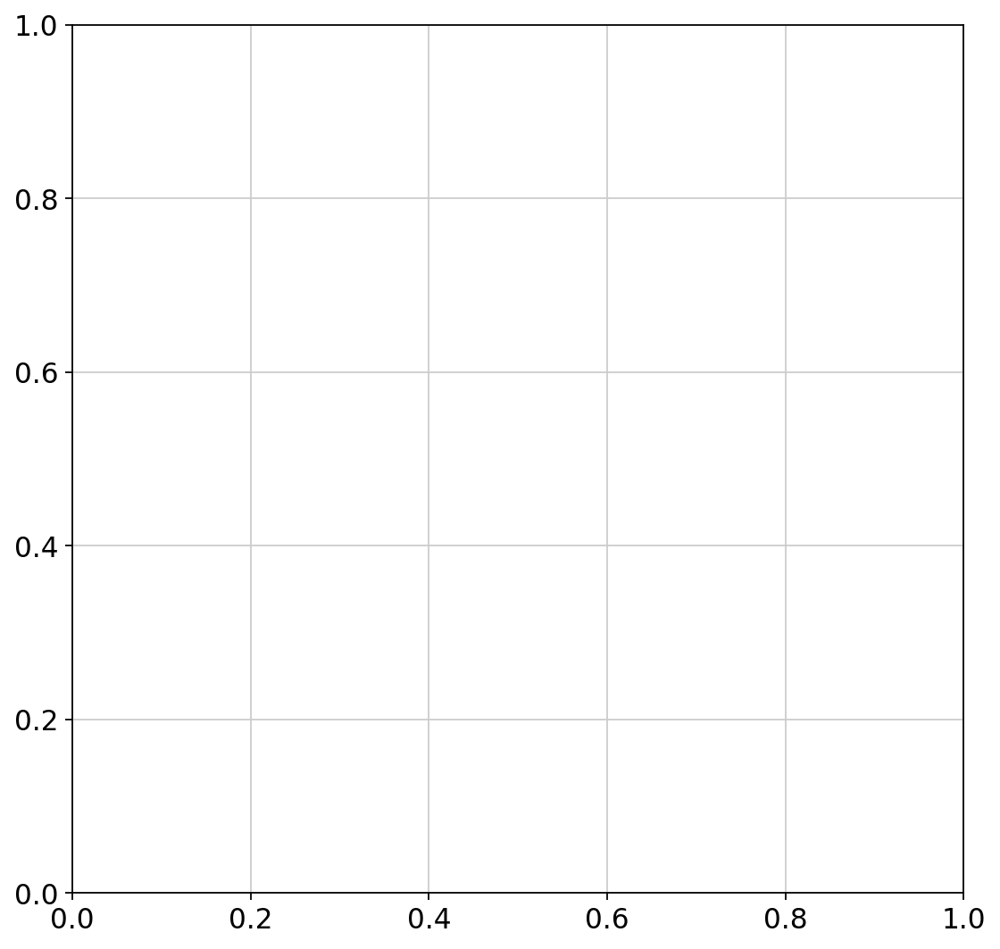

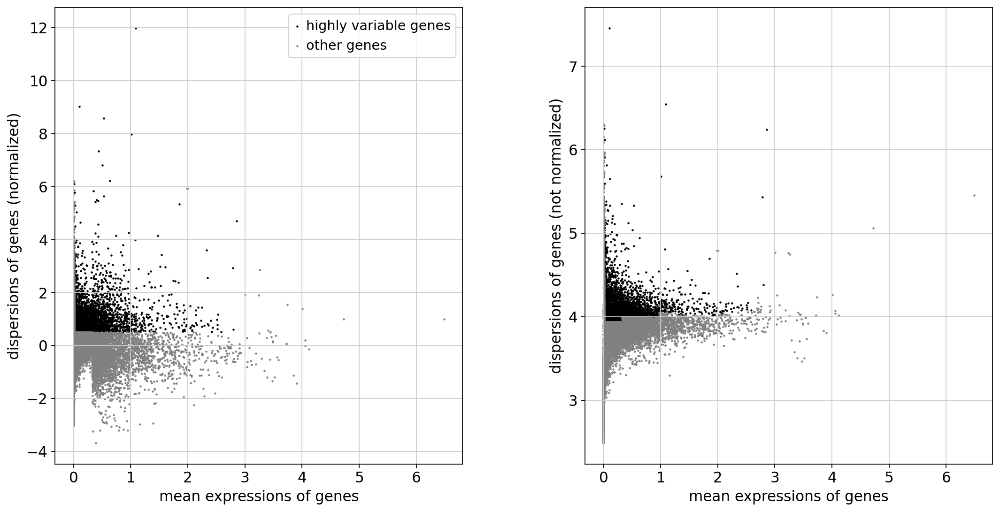

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:06:22)
computing PCA
    with n_comps=50
    finished (0:04:22)


2024-08-27 20:59:02,447 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 20:59:02,447 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 20:59:52,977 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 20:59:52,977 - INFO - sklearn.KMeans initialization complete.
2024-08-27 20:59:55,174 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 20:59:55,174 - INFO - Iteration 1 of 10
2024-08-27 21:03:26,141 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 21:03:26,141 - INFO - Iteration 2 of 10
2024-08-27 21:06:57,024 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 21:06:57,024 - INFO - Iteration 3 of 10
2024-08-27 21:10:17,331 - harmonypy - INFO - Iteration 4 of 10
2024-08-27 21:10:17,331 - INFO - Iteration 4 of 10
2024-08-27 21:11:55,042 - harmonypy - INFO - Iteration 5 of 10
2024-08-27 21:11:55,042 - INFO - Iteration 5 of 10
2024-08-27 21:12:55,491 - harmonypy - INFO - Converged after 5 iterations
2024-08-27 21:12:5

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:21)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:27)
Error: HZ3M02-name 'cm' is not defined
Error: HZ3M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ3M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


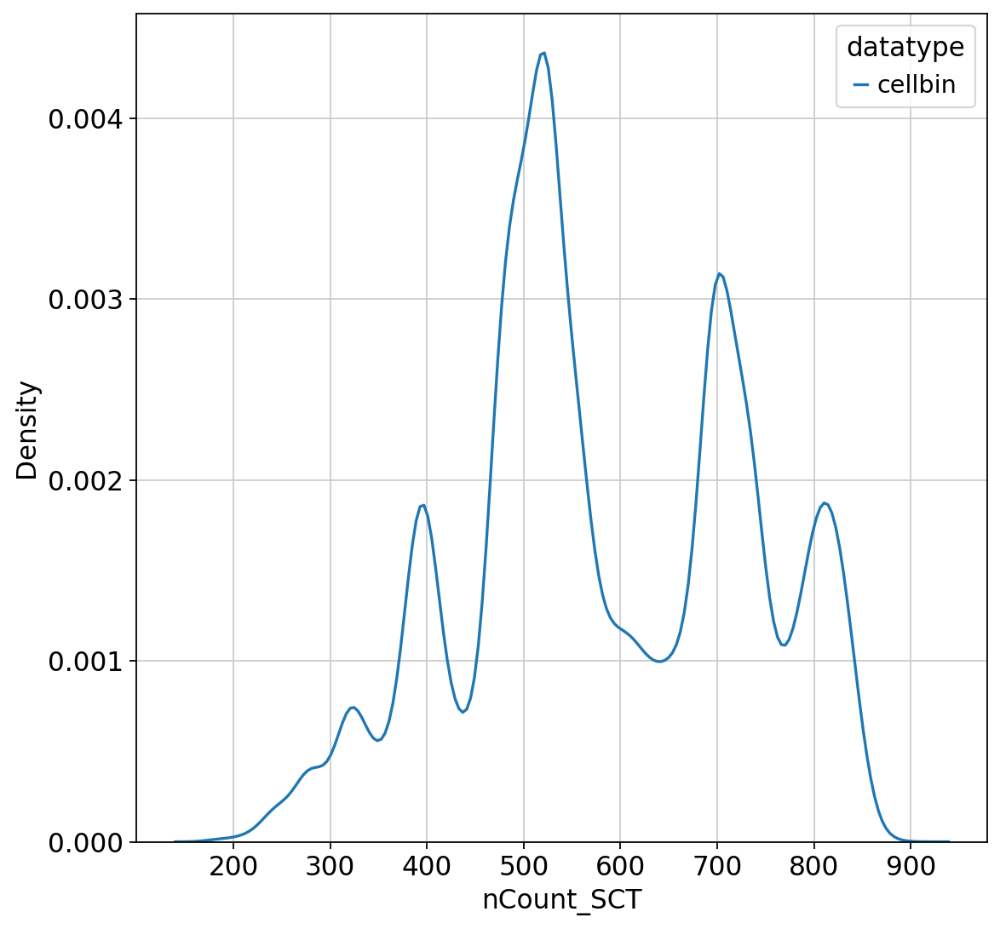

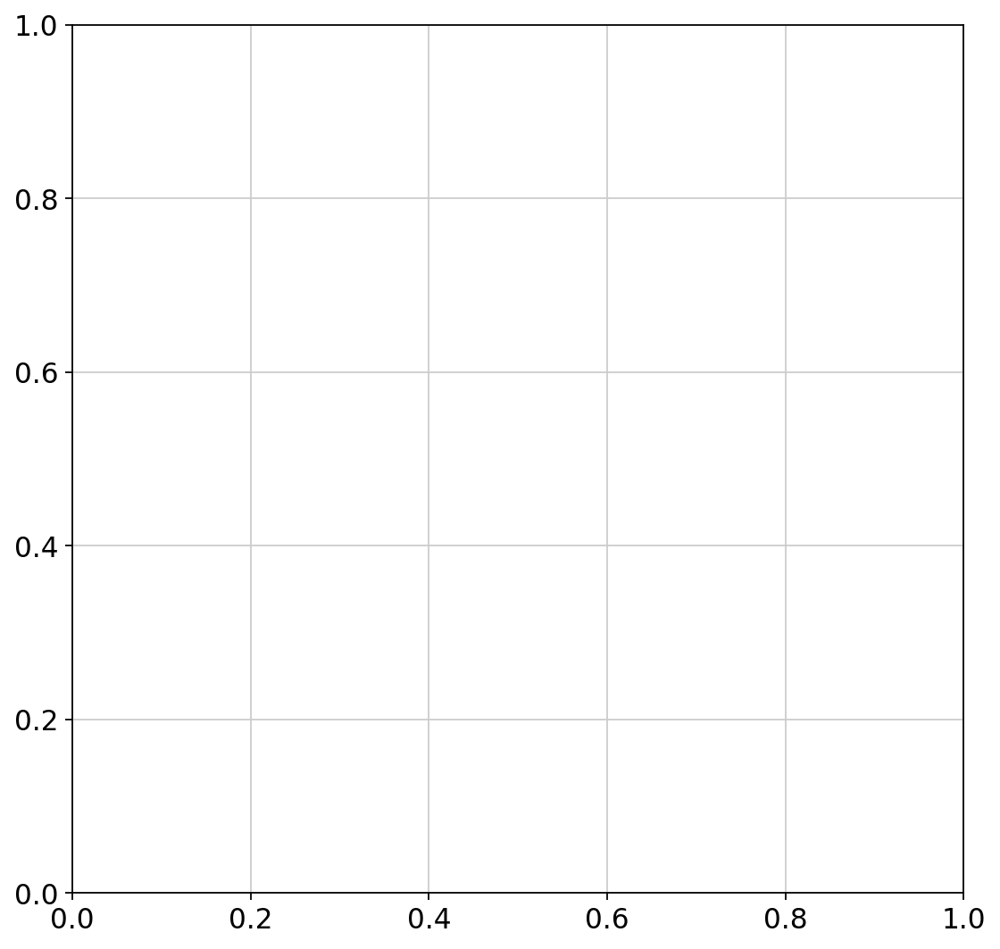

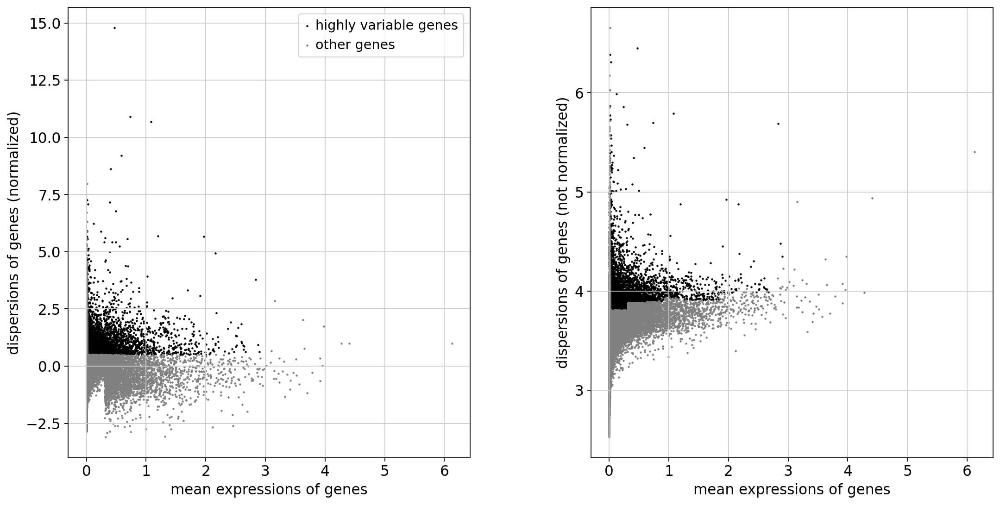

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:55:33)
computing PCA
    with n_comps=50
    finished (0:03:46)


2024-08-27 22:22:57,840 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 22:22:57,840 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 22:23:38,242 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 22:23:38,242 - INFO - sklearn.KMeans initialization complete.
2024-08-27 22:23:40,651 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 22:23:40,651 - INFO - Iteration 1 of 10
2024-08-27 22:27:00,826 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 22:27:00,826 - INFO - Iteration 2 of 10
2024-08-27 22:29:43,852 - harmonypy - INFO - Iteration 3 of 10
2024-08-27 22:29:43,852 - INFO - Iteration 3 of 10
2024-08-27 22:30:51,453 - harmonypy - INFO - Converged after 3 iterations
2024-08-27 22:30:51,453 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:42)
Error: HZ3M03-name 'cm' is not defined
Error: HZ3M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ3M04 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


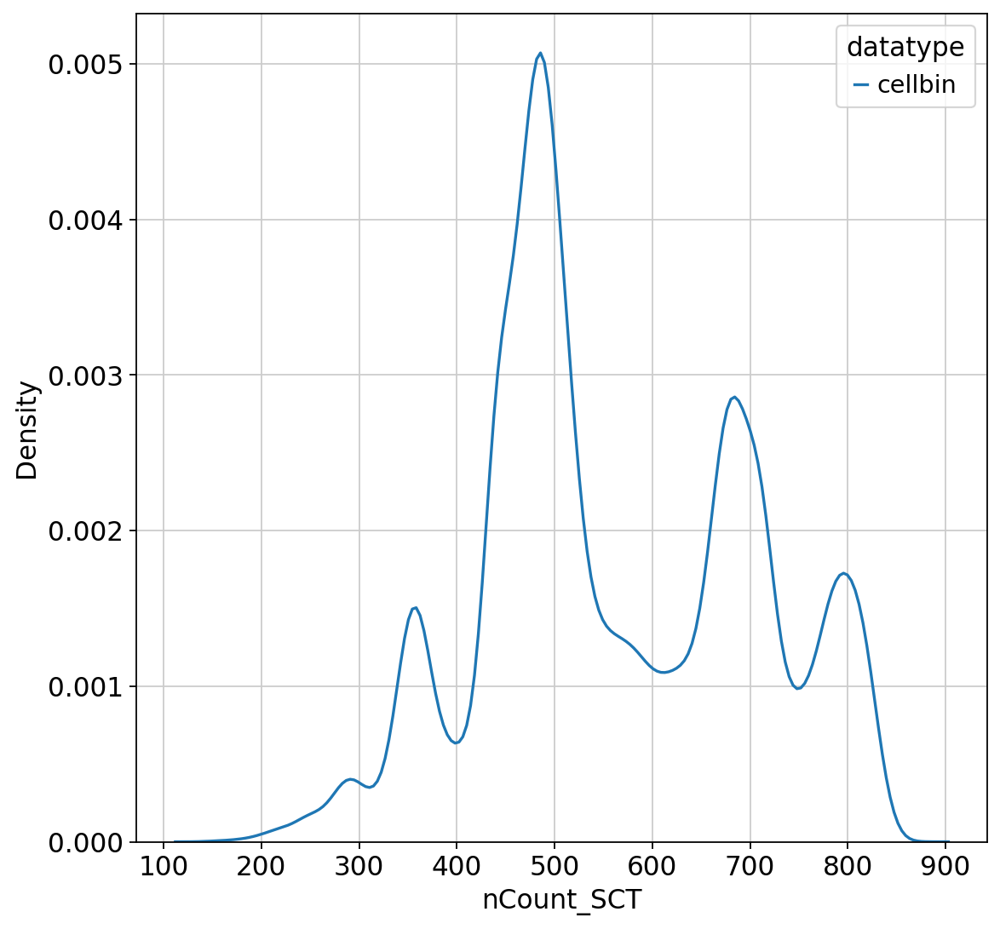

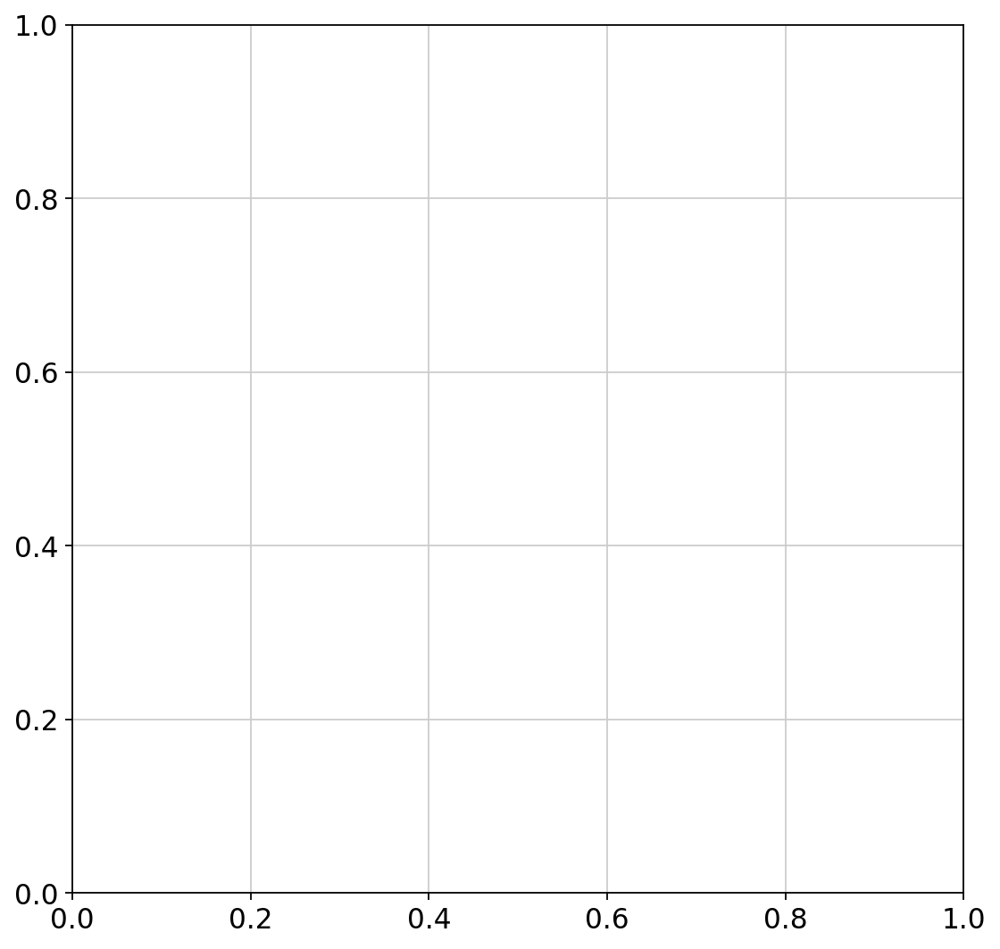

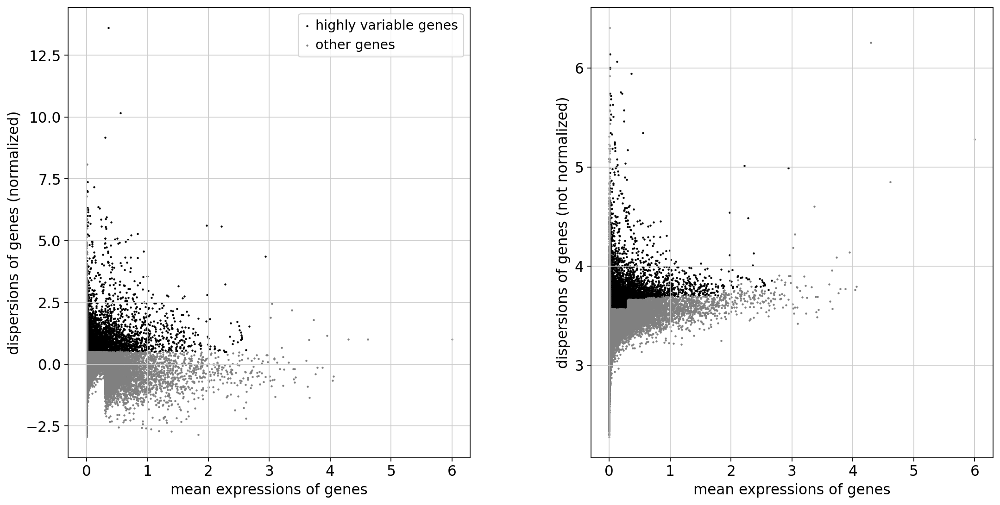

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:07:38)
computing PCA
    with n_comps=50
    finished (0:04:33)


2024-08-27 23:51:59,036 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 23:51:59,036 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-27 23:52:47,066 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-27 23:52:47,066 - INFO - sklearn.KMeans initialization complete.
2024-08-27 23:52:50,586 - harmonypy - INFO - Iteration 1 of 10
2024-08-27 23:52:50,586 - INFO - Iteration 1 of 10
2024-08-27 23:57:12,576 - harmonypy - INFO - Iteration 2 of 10
2024-08-27 23:57:12,576 - INFO - Iteration 2 of 10
2024-08-28 00:00:52,047 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 00:00:52,047 - INFO - Iteration 3 of 10
2024-08-28 00:03:41,956 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 00:03:41,956 - INFO - Iteration 4 of 10
2024-08-28 00:04:47,346 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 00:04:47,346 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:17)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:14)
Error: HZ3M04-name 'cm' is not defined
Error: HZ3M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ3M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


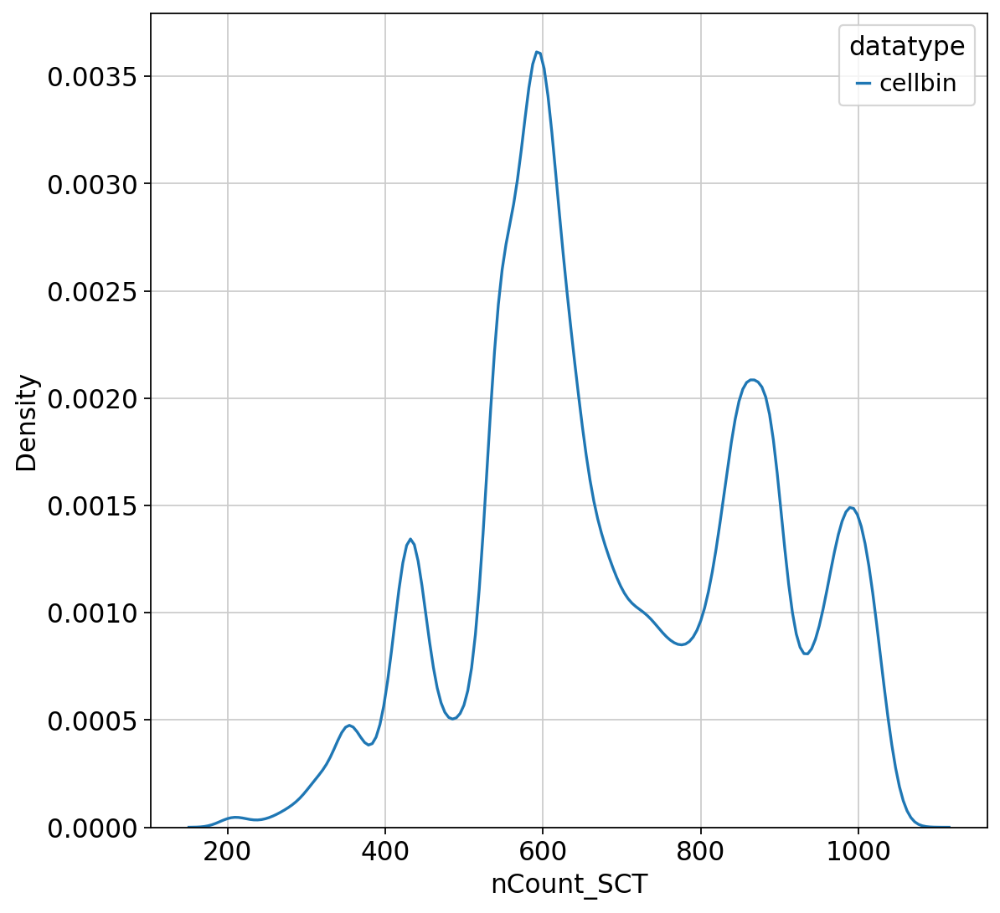

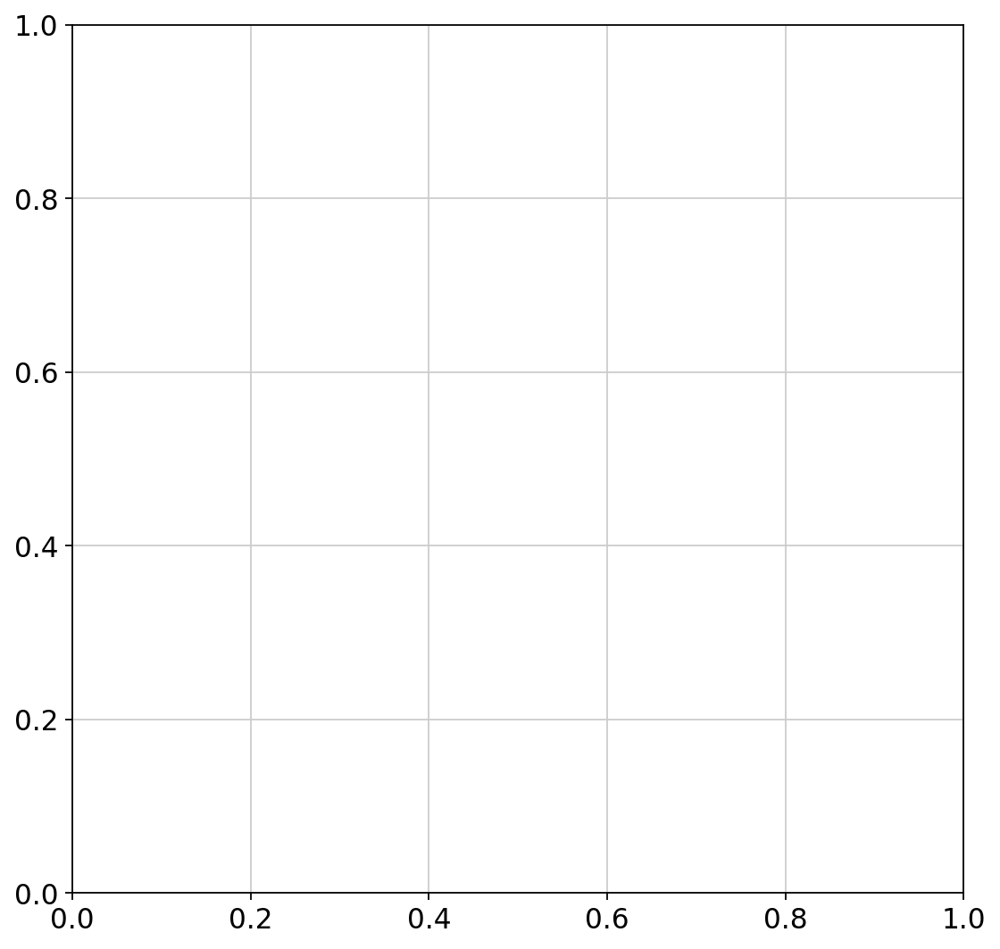

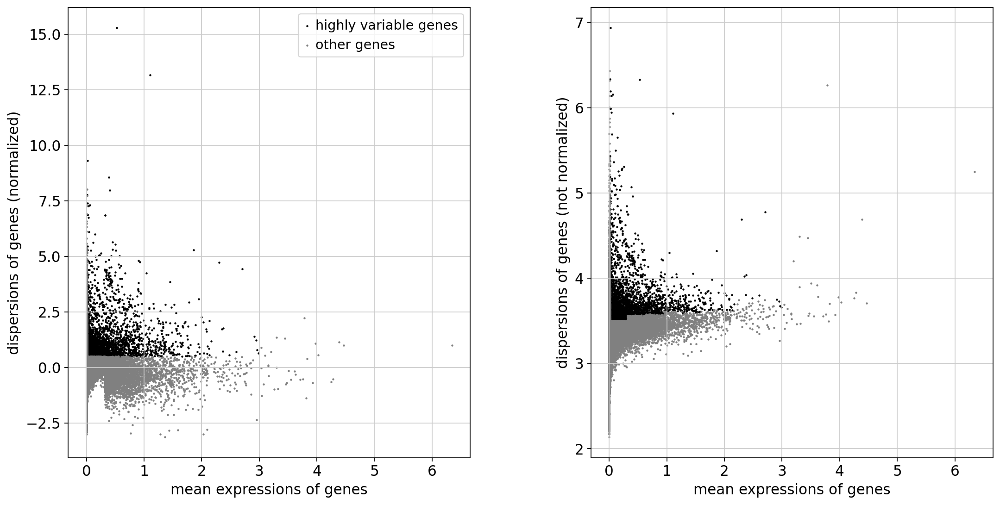

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:53:50)
computing PCA
    with n_comps=50
    finished (0:03:52)


2024-08-28 01:13:16,938 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 01:13:16,938 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 01:14:08,305 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 01:14:08,305 - INFO - sklearn.KMeans initialization complete.
2024-08-28 01:14:11,996 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 01:14:11,996 - INFO - Iteration 1 of 10
2024-08-28 01:18:47,660 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 01:18:47,660 - INFO - Iteration 2 of 10
2024-08-28 01:22:37,258 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 01:22:37,258 - INFO - Iteration 3 of 10
2024-08-28 01:24:40,136 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 01:24:40,136 - INFO - Iteration 4 of 10
2024-08-28 01:25:47,041 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 01:25:47,041 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:52)
Error: HZ3M06-name 'cm' is not defined
Error: HZ3M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ4M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


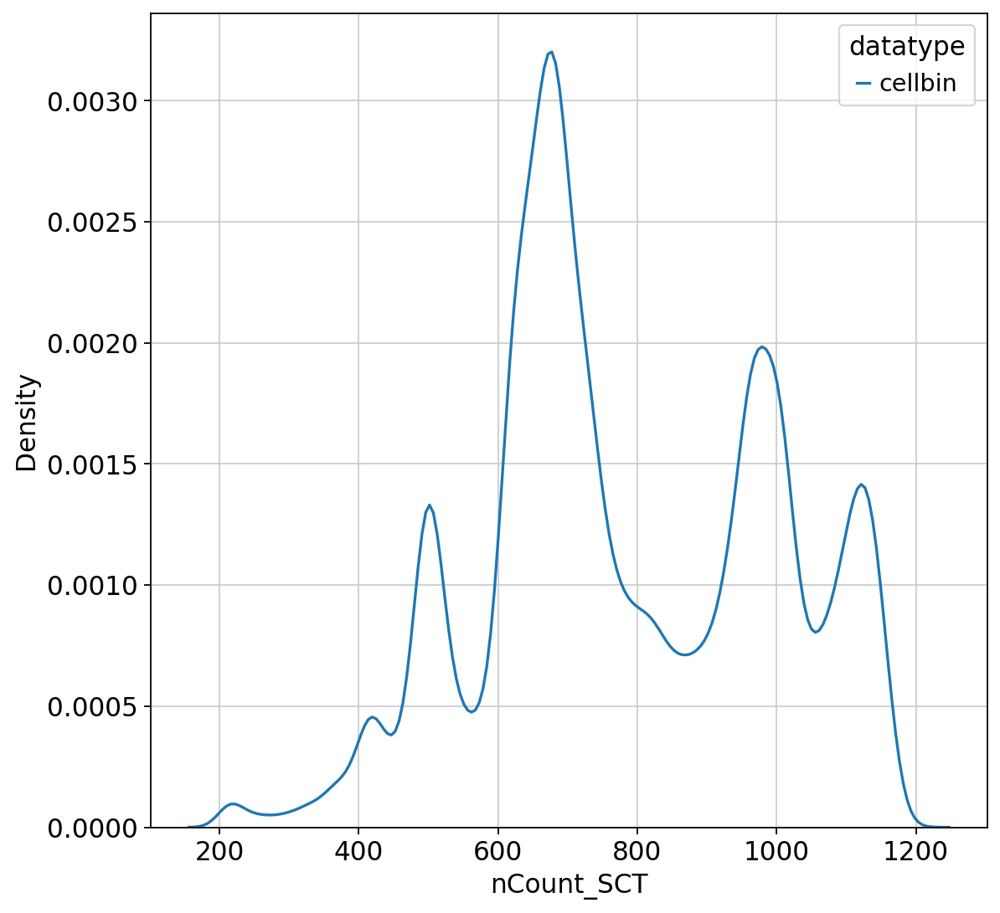

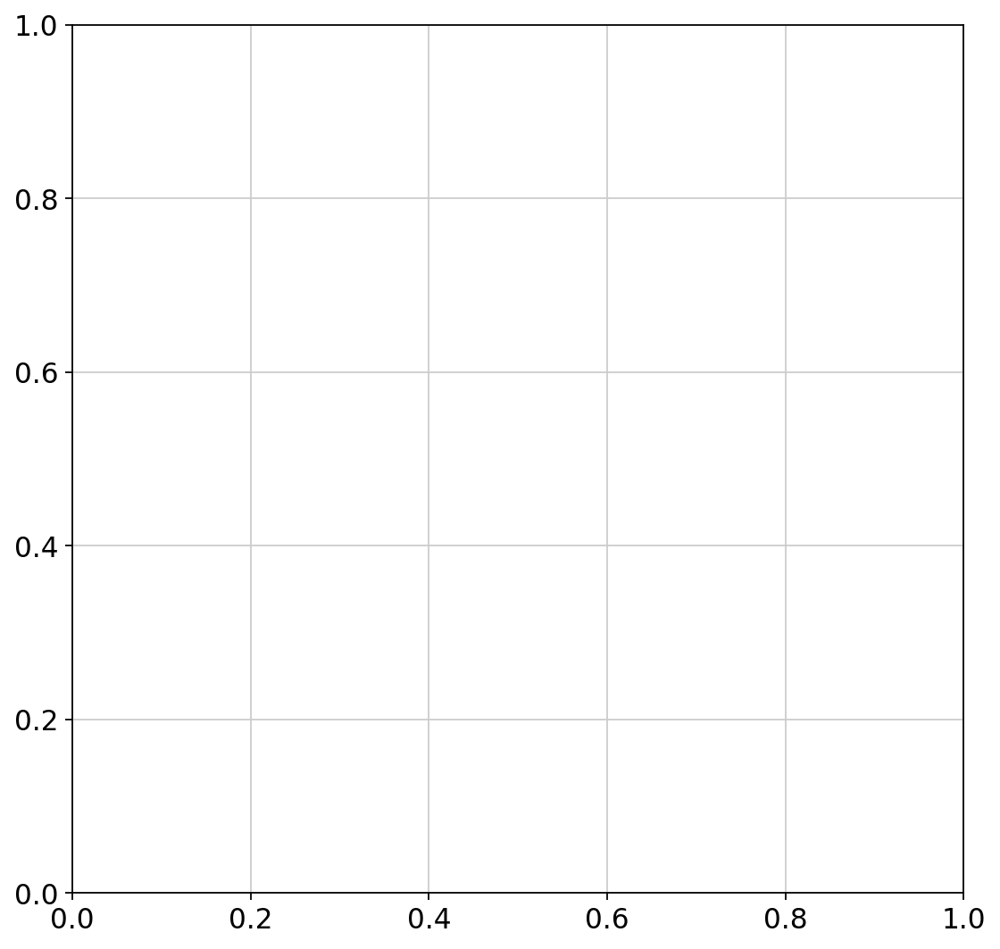

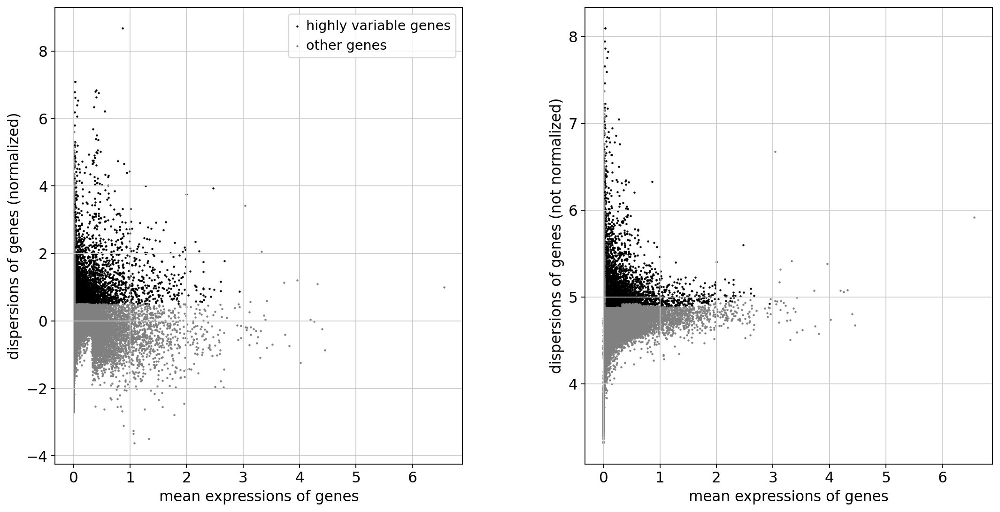

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:55:04)
computing PCA
    with n_comps=50
    finished (0:03:40)


2024-08-28 02:35:31,909 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 02:35:31,909 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 02:36:19,886 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 02:36:19,886 - INFO - sklearn.KMeans initialization complete.
2024-08-28 02:36:22,931 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 02:36:22,931 - INFO - Iteration 1 of 10
2024-08-28 02:40:04,308 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 02:40:04,308 - INFO - Iteration 2 of 10
2024-08-28 02:43:41,023 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 02:43:41,023 - INFO - Iteration 3 of 10
2024-08-28 02:47:17,261 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 02:47:17,261 - INFO - Iteration 4 of 10
2024-08-28 02:49:00,576 - harmonypy - INFO - Iteration 5 of 10
2024-08-28 02:49:00,576 - INFO - Iteration 5 of 10
2024-08-28 02:50:04,635 - harmonypy - INFO - Converged after 5 iterations
2024-08-28 02:50:0

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:37)
Error: HZ4M03-name 'cm' is not defined
Error: HZ4M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ4M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


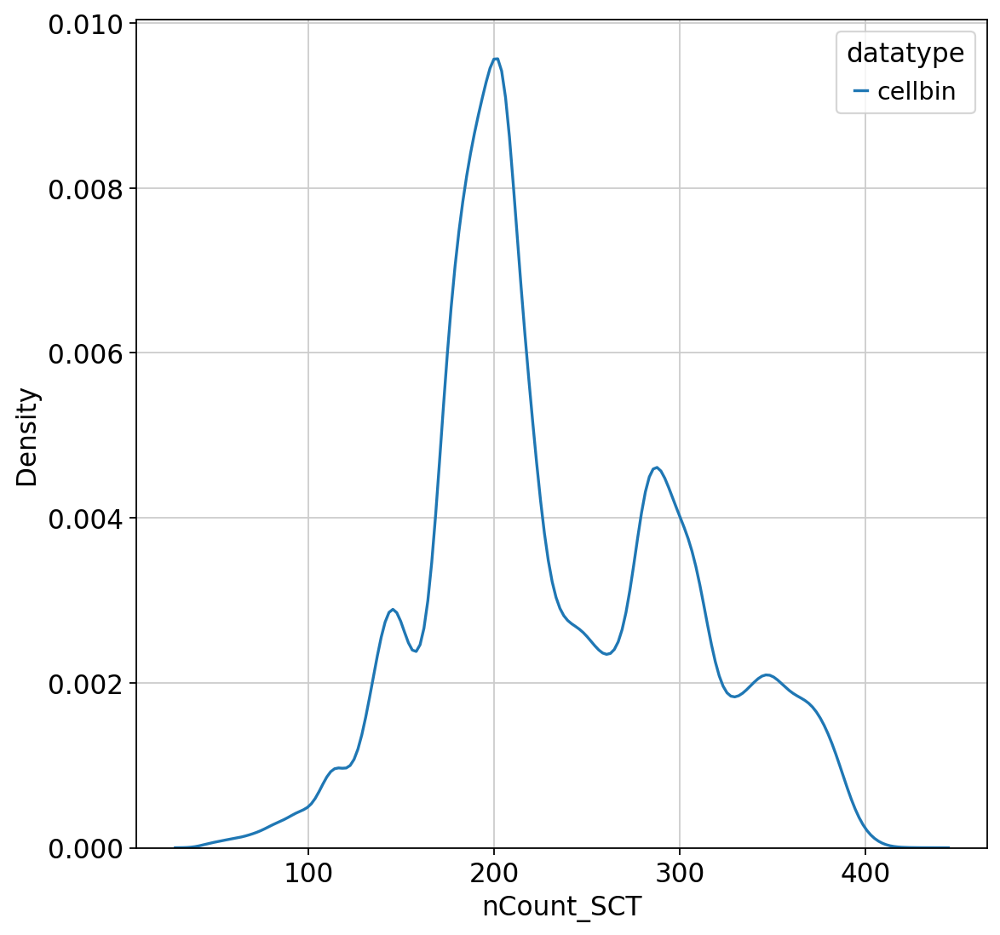

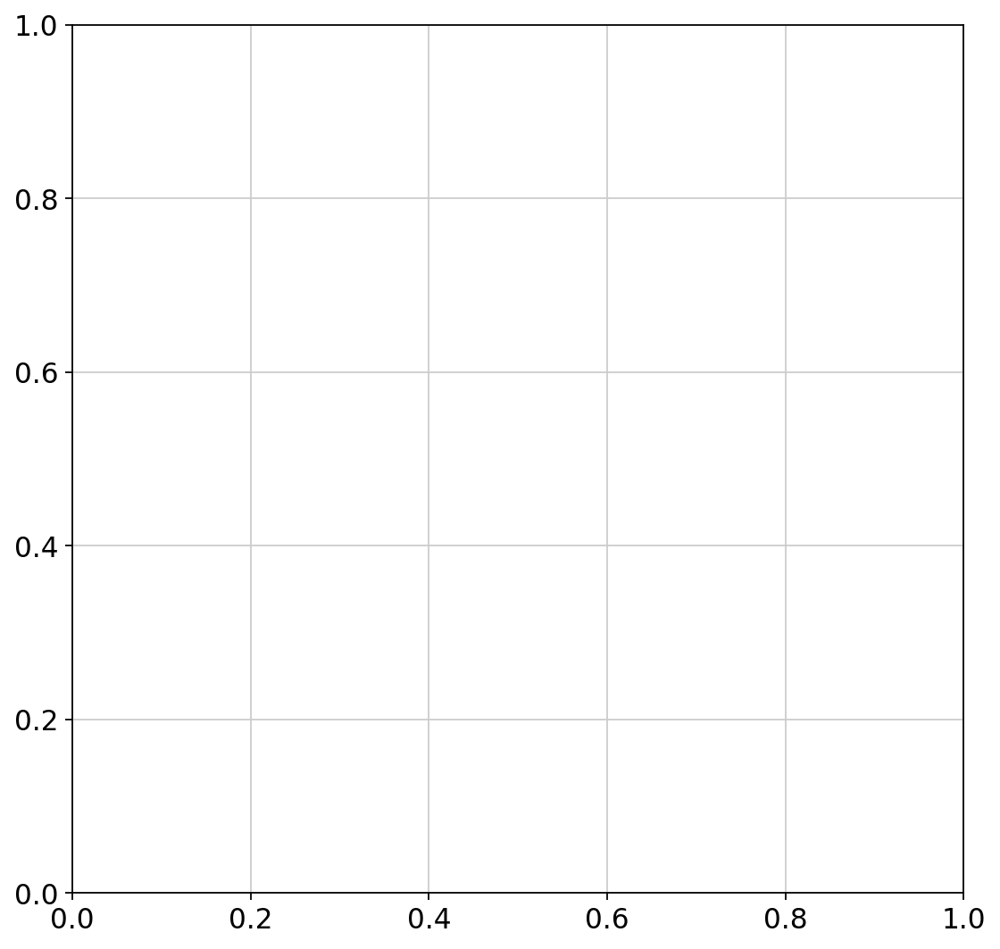

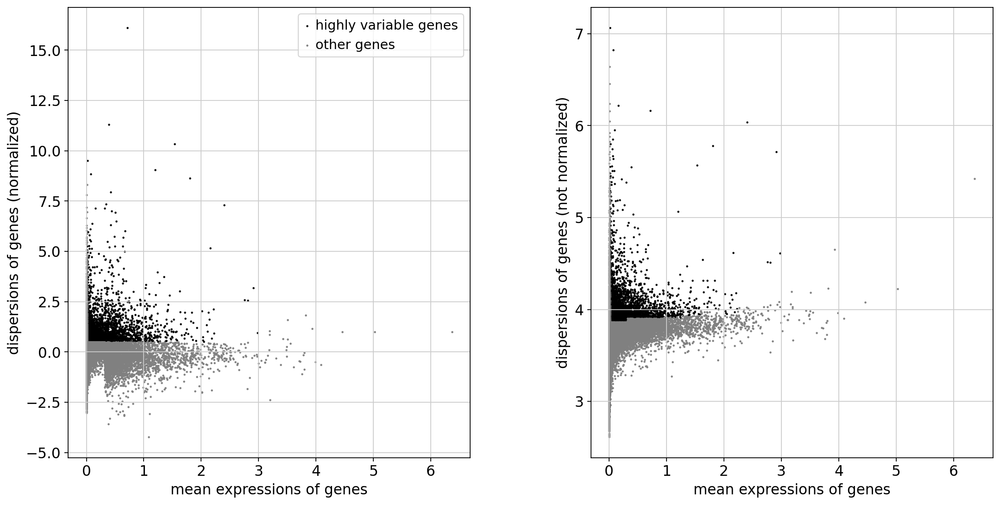

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:44:38)
computing PCA
    with n_comps=50
    finished (0:02:59)


2024-08-28 03:48:20,979 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 03:48:20,979 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 03:49:00,500 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 03:49:00,500 - INFO - sklearn.KMeans initialization complete.
2024-08-28 03:49:02,509 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 03:49:02,509 - INFO - Iteration 1 of 10
2024-08-28 03:51:51,940 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 03:51:51,940 - INFO - Iteration 2 of 10
2024-08-28 03:54:31,826 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 03:54:31,826 - INFO - Iteration 3 of 10
2024-08-28 03:57:08,140 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 03:57:08,140 - INFO - Iteration 4 of 10
2024-08-28 03:58:31,717 - harmonypy - INFO - Iteration 5 of 10
2024-08-28 03:58:31,717 - INFO - Iteration 5 of 10
2024-08-28 03:59:18,594 - harmonypy - INFO - Converged after 5 iterations
2024-08-28 03:59:1

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:14)
Error: HZ4M05-name 'cm' is not defined
Error: HZ4M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ4MP101 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


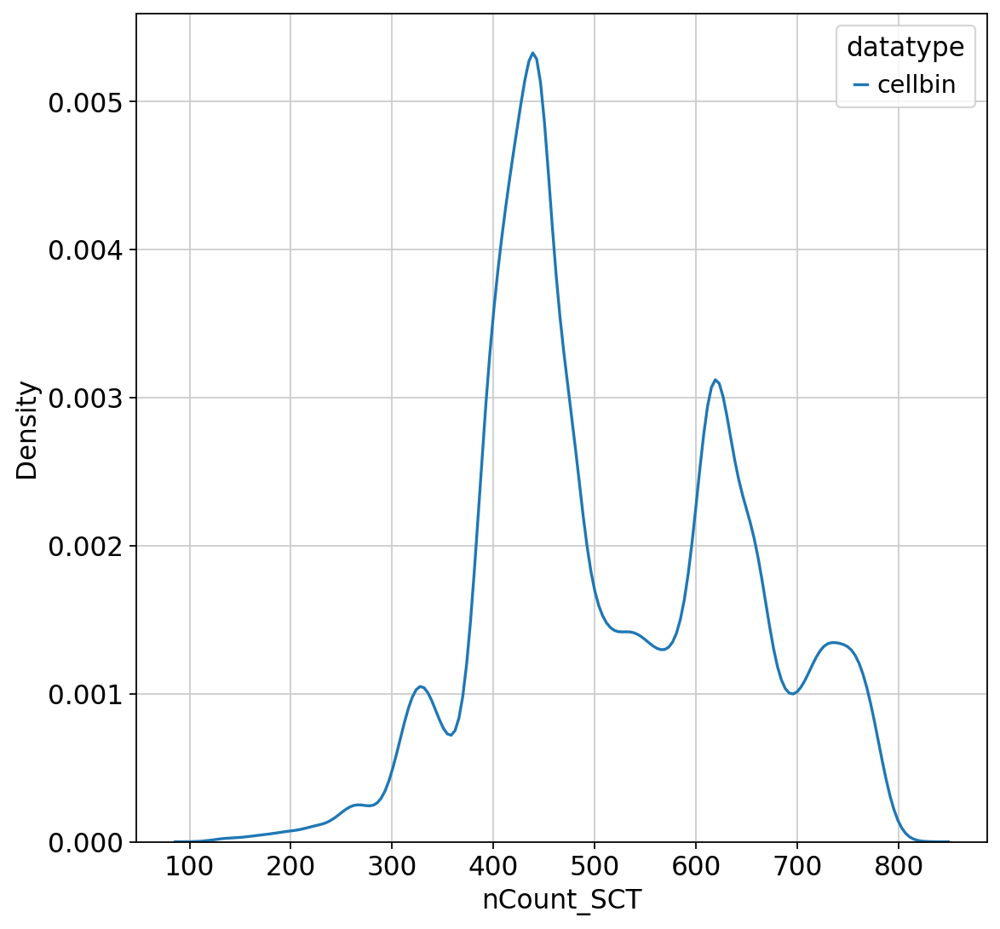

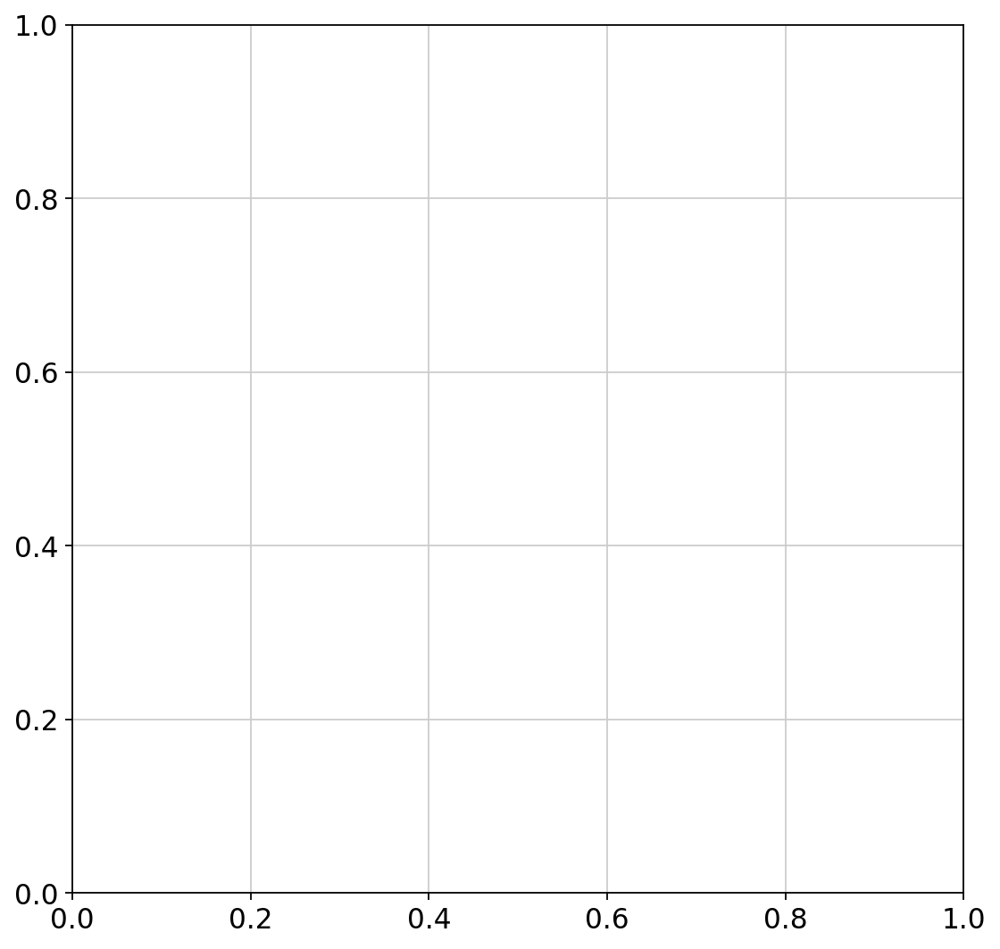

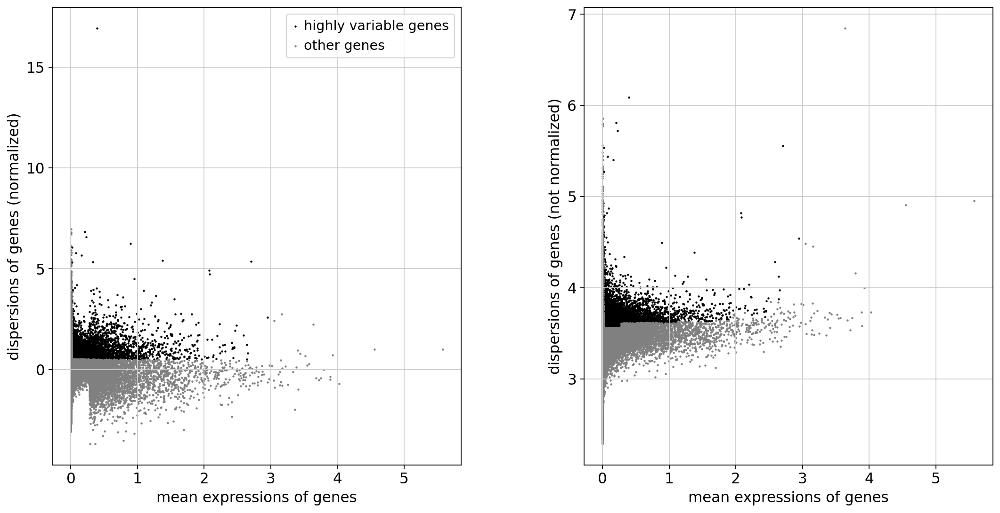

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:12:52)
computing PCA
    with n_comps=50
    finished (0:04:29)


2024-08-28 05:24:51,277 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 05:24:51,277 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 05:25:43,038 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 05:25:43,038 - INFO - sklearn.KMeans initialization complete.
2024-08-28 05:25:45,214 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 05:25:45,214 - INFO - Iteration 1 of 10
2024-08-28 05:29:37,374 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 05:29:37,374 - INFO - Iteration 2 of 10
2024-08-28 05:33:09,471 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 05:33:09,471 - INFO - Iteration 3 of 10
2024-08-28 05:34:11,561 - harmonypy - INFO - Converged after 3 iterations
2024-08-28 05:34:11,561 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:48)
Error: HZ4MP101-name 'cm' is not defined
Error: HZ4MP101-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ4MP102 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


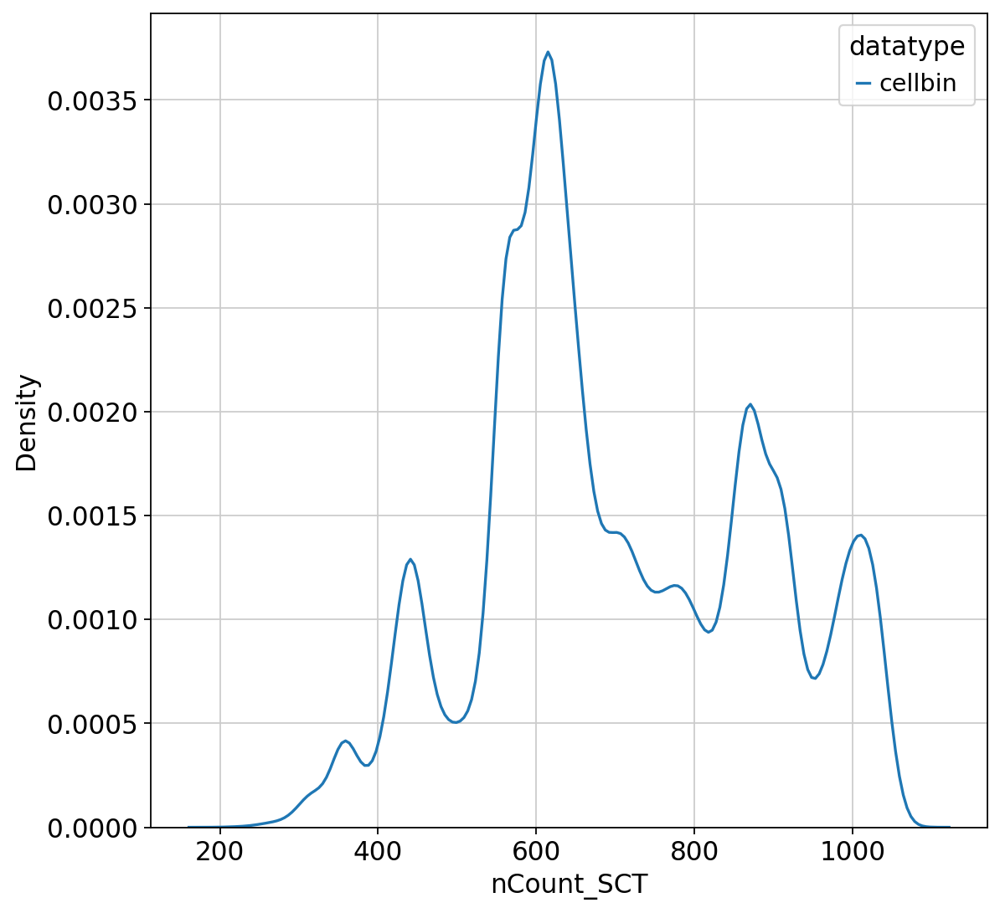

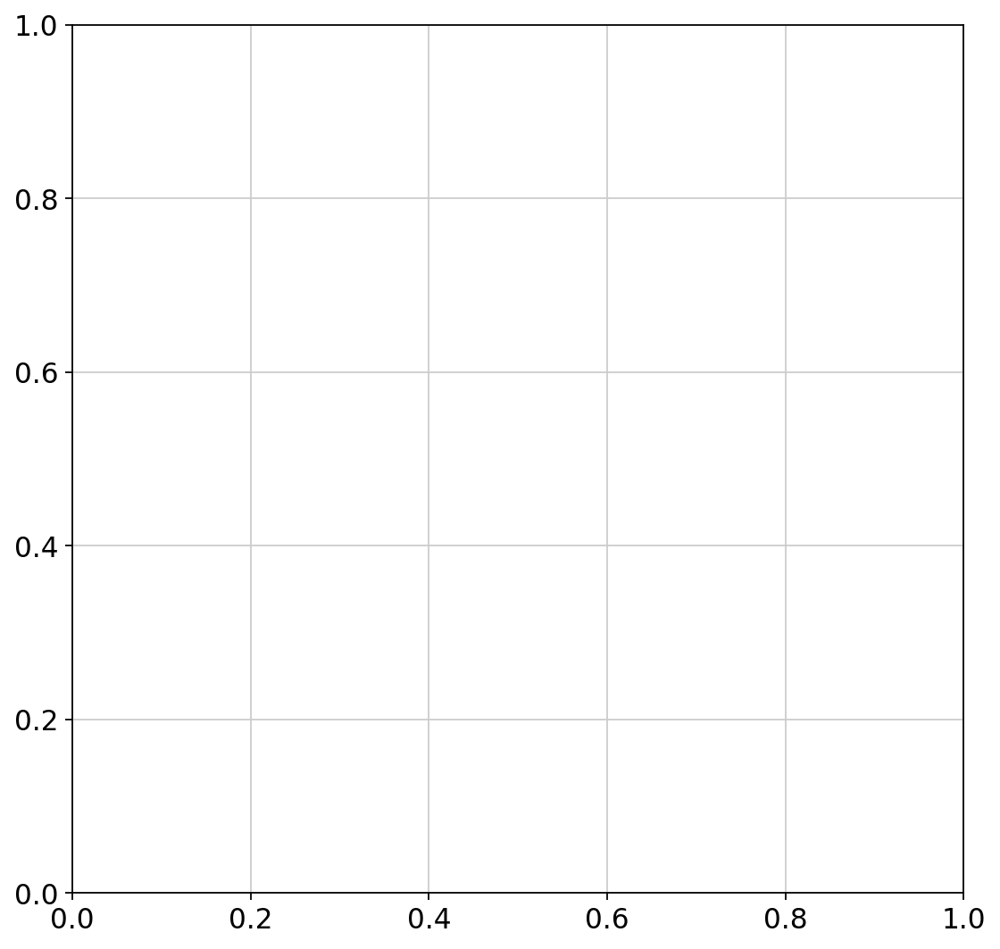

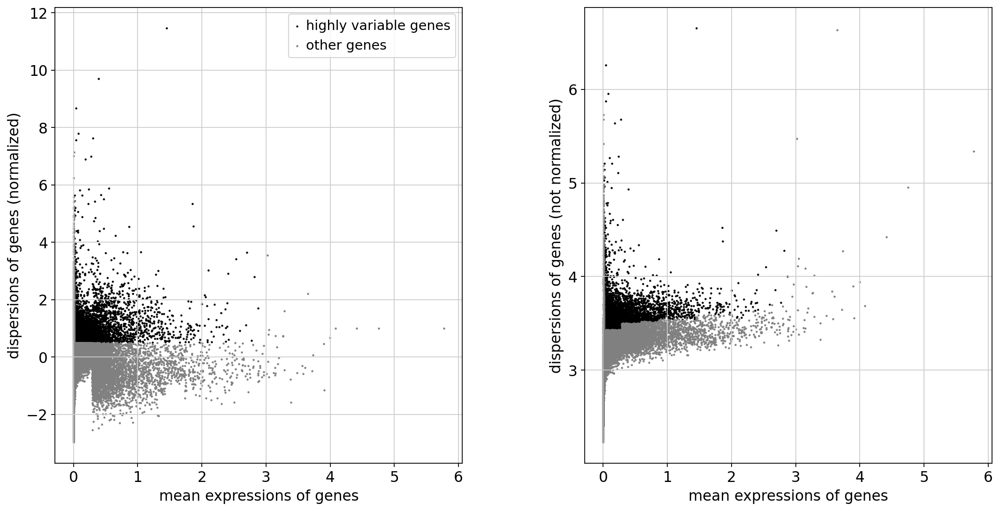

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:07:18)
computing PCA
    with n_comps=50
    finished (0:03:56)


2024-08-28 06:56:57,538 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 06:56:57,538 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 06:57:45,745 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 06:57:45,745 - INFO - sklearn.KMeans initialization complete.
2024-08-28 06:57:47,648 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 06:57:47,648 - INFO - Iteration 1 of 10
2024-08-28 07:01:04,484 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 07:01:04,484 - INFO - Iteration 2 of 10
2024-08-28 07:04:33,412 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 07:04:33,412 - INFO - Iteration 3 of 10
2024-08-28 07:06:34,638 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 07:06:34,638 - INFO - Iteration 4 of 10
2024-08-28 07:07:37,241 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 07:07:37,241 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:13)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:00)
Error: HZ4MP102-name 'cm' is not defined
Error: HZ4MP102-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ4MP202 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:03)
extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


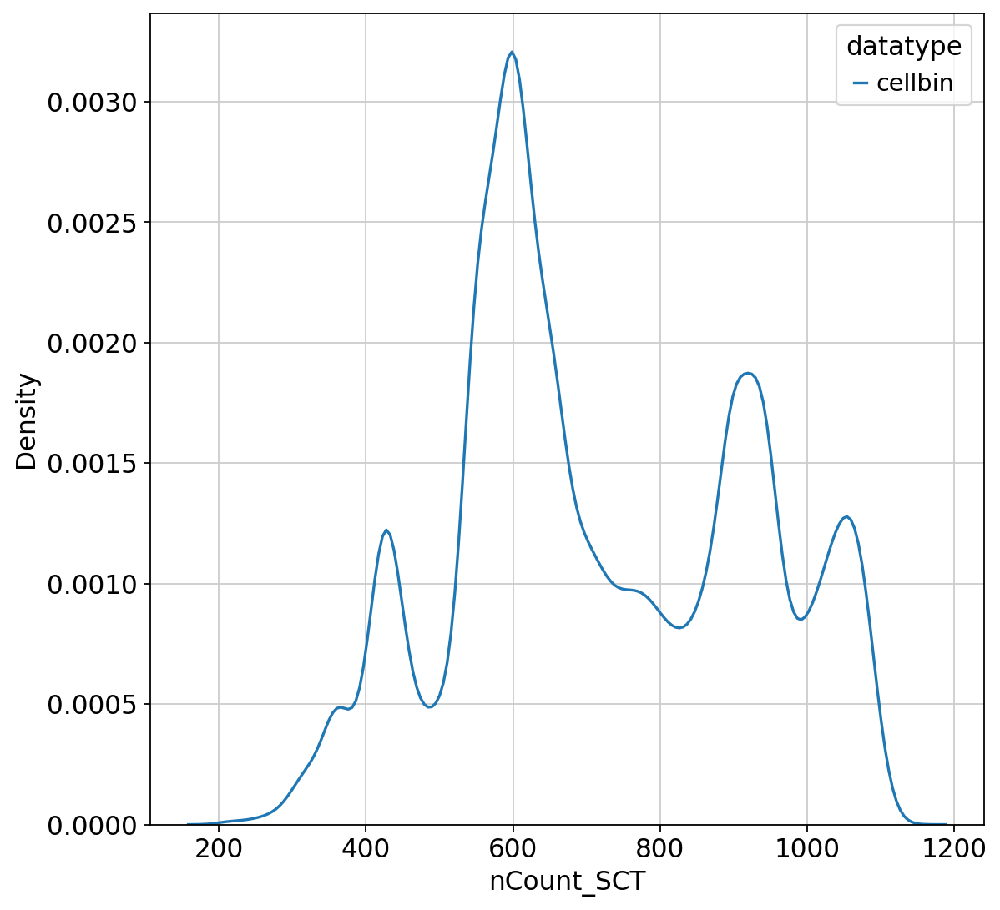

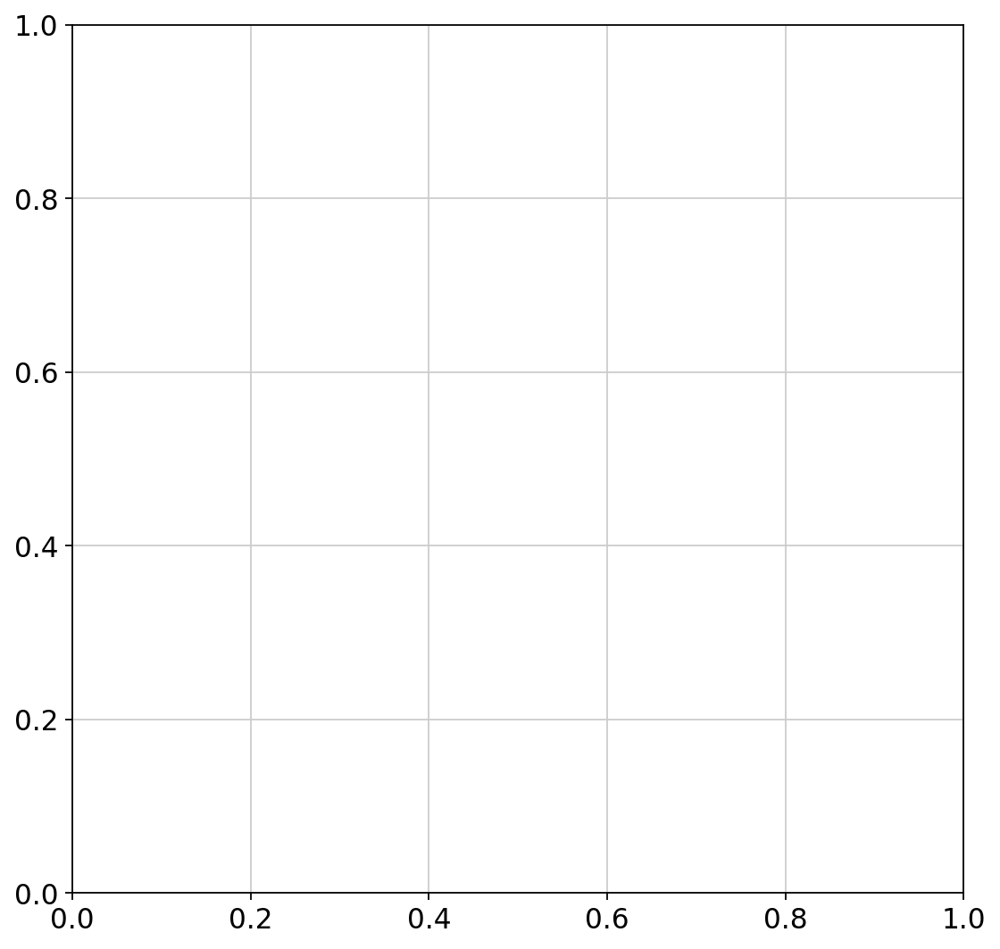

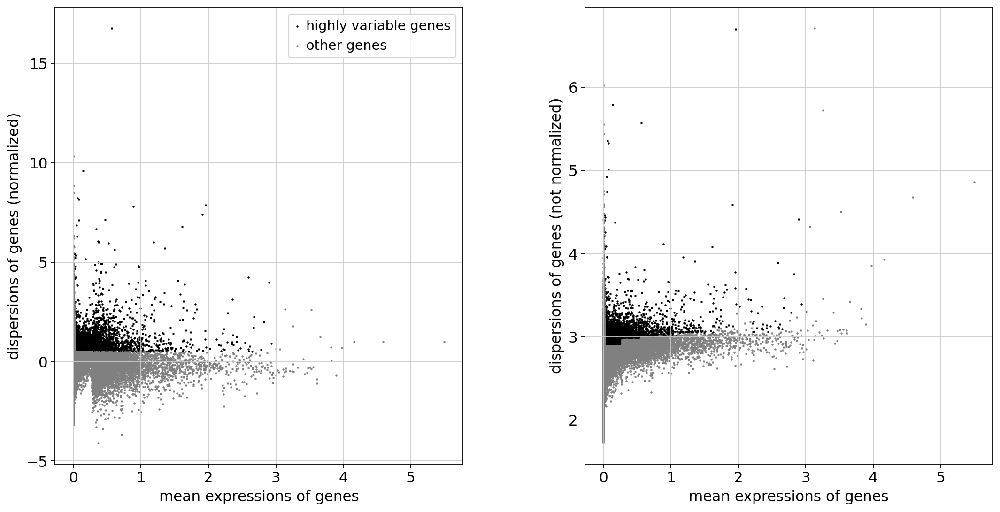

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:10:25)
computing PCA
    with n_comps=50
    finished (0:02:37)


2024-08-28 08:31:27,191 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 08:31:27,191 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 08:32:20,110 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 08:32:20,110 - INFO - sklearn.KMeans initialization complete.
2024-08-28 08:32:23,940 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 08:32:23,940 - INFO - Iteration 1 of 10
2024-08-28 08:37:12,099 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 08:37:12,099 - INFO - Iteration 2 of 10
2024-08-28 08:41:30,607 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 08:41:30,607 - INFO - Iteration 3 of 10
2024-08-28 08:45:47,296 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 08:45:47,296 - INFO - Iteration 4 of 10
2024-08-28 08:49:24,854 - harmonypy - INFO - Iteration 5 of 10
2024-08-28 08:49:24,854 - INFO - Iteration 5 of 10
2024-08-28 08:50:42,179 - harmonypy - INFO - Converged after 5 iterations
2024-08-28 08:50:4

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:19)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:01)
Error: HZ4MP202-name 'cm' is not defined
Error: HZ4MP202-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


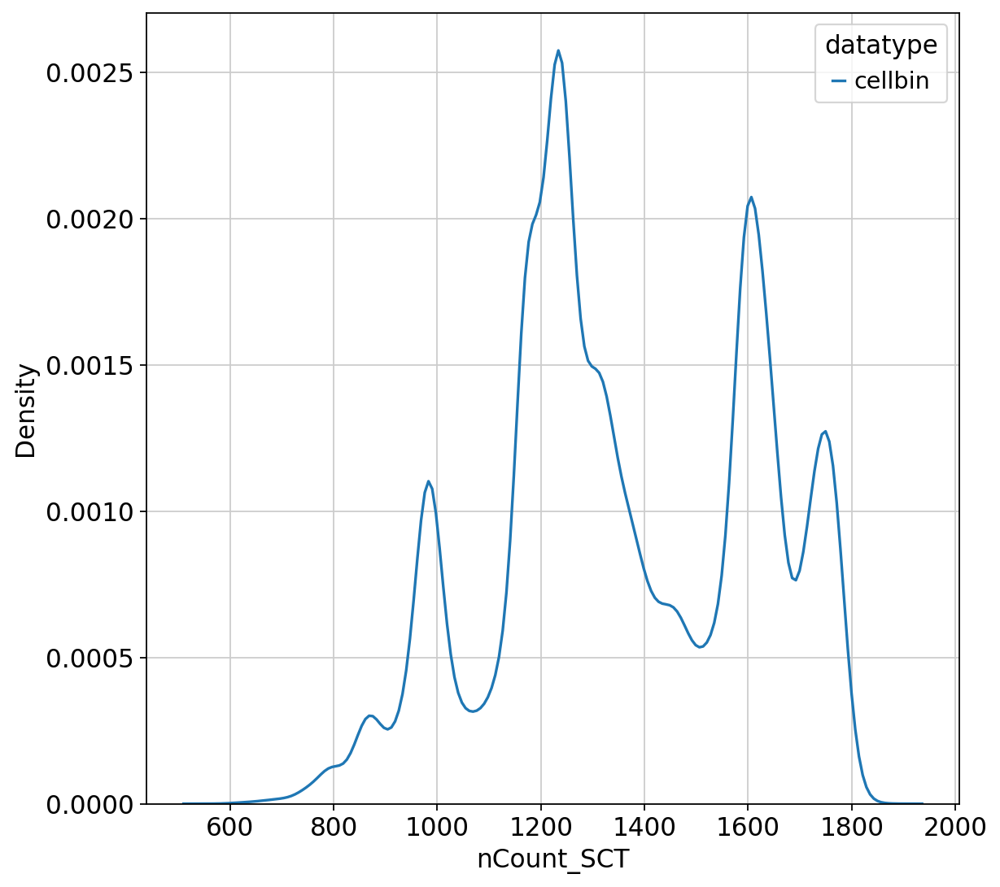

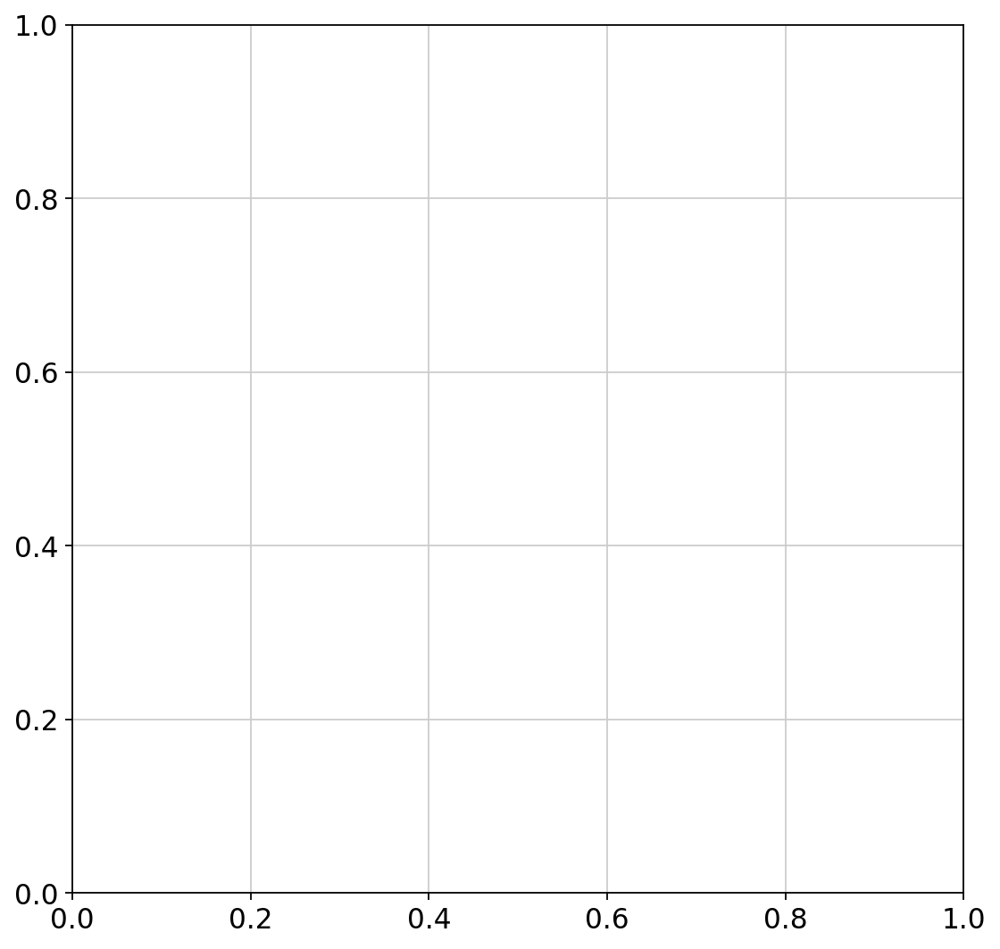

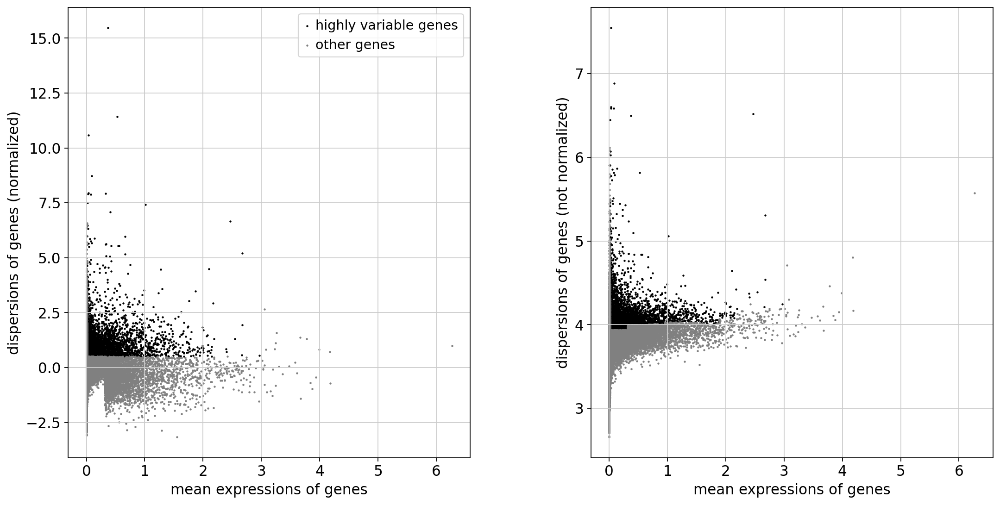

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:02:51)
computing PCA
    with n_comps=50
    finished (0:04:06)


2024-08-28 10:09:19,809 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 10:09:19,809 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 10:10:09,108 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 10:10:09,108 - INFO - sklearn.KMeans initialization complete.
2024-08-28 10:10:11,487 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 10:10:11,487 - INFO - Iteration 1 of 10
2024-08-28 10:13:29,751 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 10:13:29,751 - INFO - Iteration 2 of 10
2024-08-28 10:16:40,788 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 10:16:40,788 - INFO - Iteration 3 of 10
2024-08-28 10:19:49,273 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 10:19:49,273 - INFO - Iteration 4 of 10
2024-08-28 10:21:18,071 - harmonypy - INFO - Iteration 5 of 10
2024-08-28 10:21:18,071 - INFO - Iteration 5 of 10
2024-08-28 10:22:15,090 - harmonypy - INFO - Converged after 5 iterations
2024-08-28 10:22:1

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:13)
Error: HZ5M01-name 'cm' is not defined
Error: HZ5M01-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


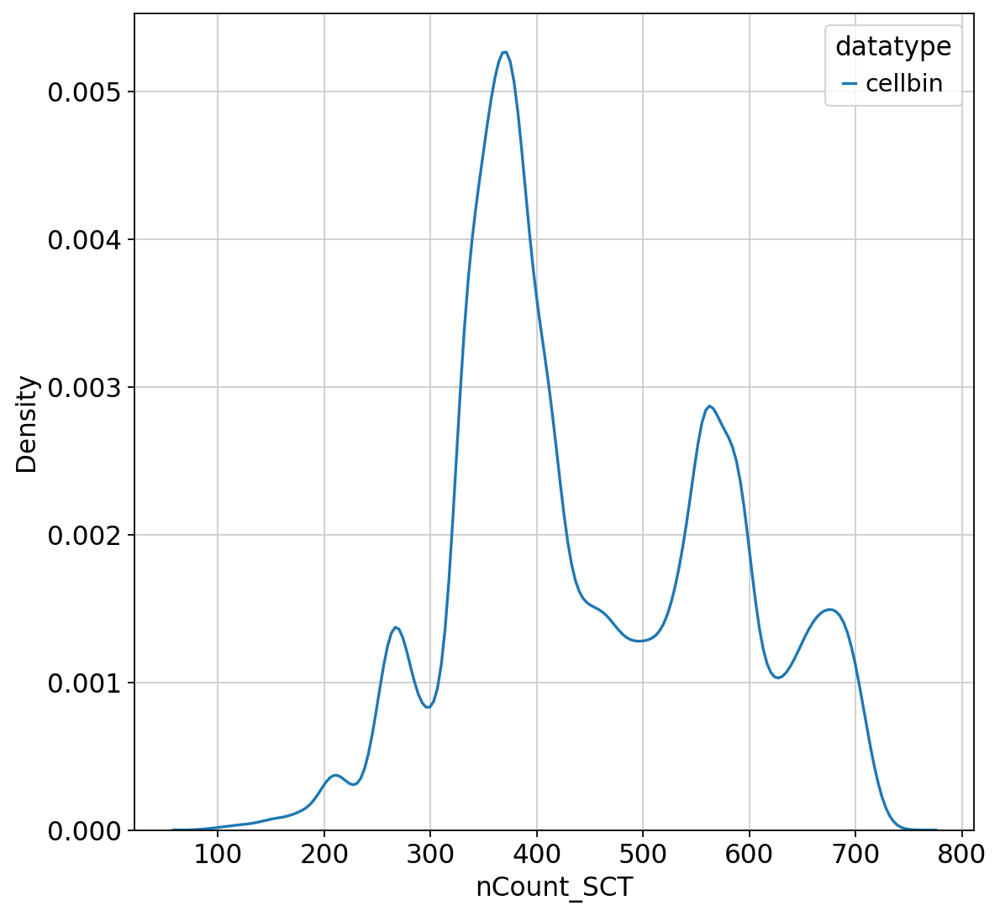

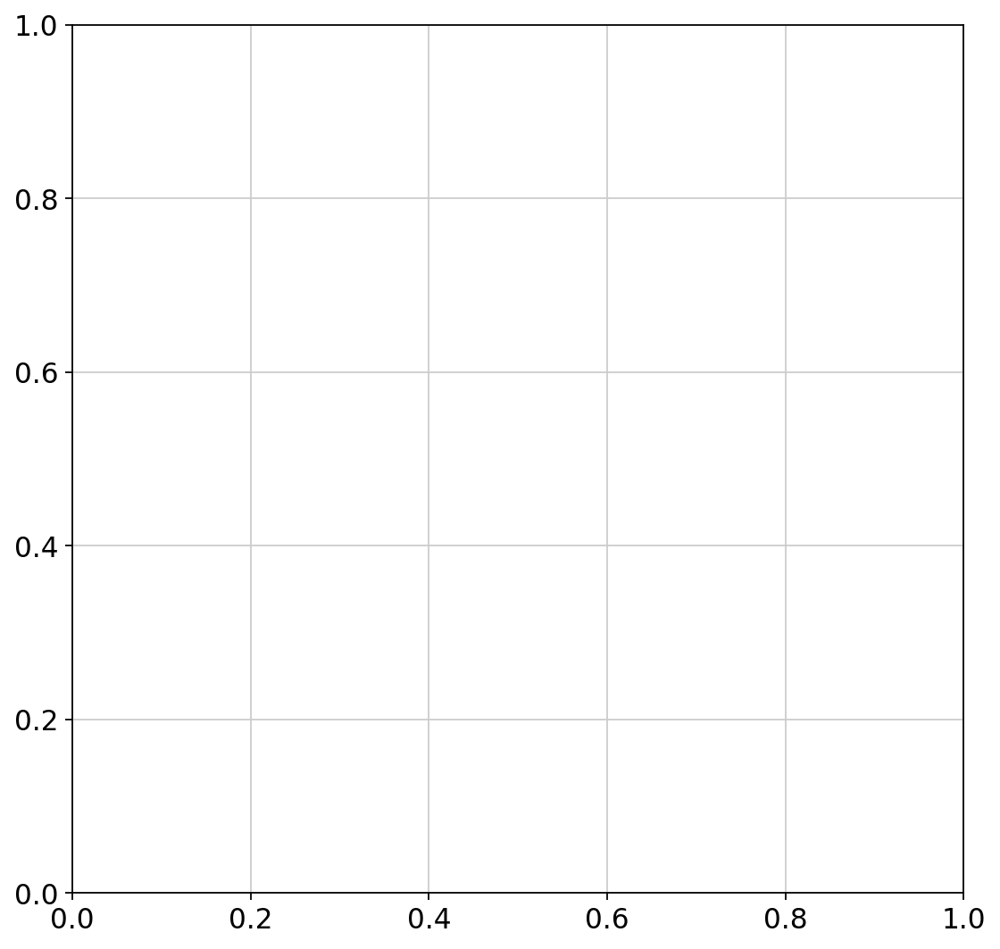

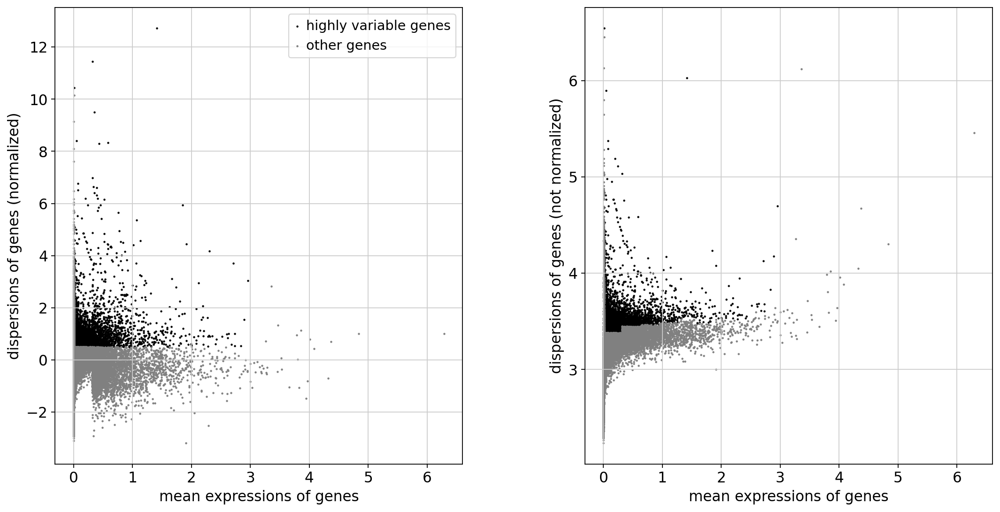

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:59:07)
computing PCA
    with n_comps=50
    finished (0:03:35)


2024-08-28 11:35:21,357 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 11:35:21,357 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 11:36:02,237 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 11:36:02,237 - INFO - sklearn.KMeans initialization complete.
2024-08-28 11:36:05,210 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 11:36:05,210 - INFO - Iteration 1 of 10
2024-08-28 11:39:32,742 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 11:39:32,742 - INFO - Iteration 2 of 10
2024-08-28 11:42:30,477 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 11:42:30,477 - INFO - Iteration 3 of 10
2024-08-28 11:43:58,644 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 11:43:58,644 - INFO - Iteration 4 of 10
2024-08-28 11:44:59,606 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 11:44:59,606 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:05)
Error: HZ5M02-name 'cm' is not defined
Error: HZ5M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


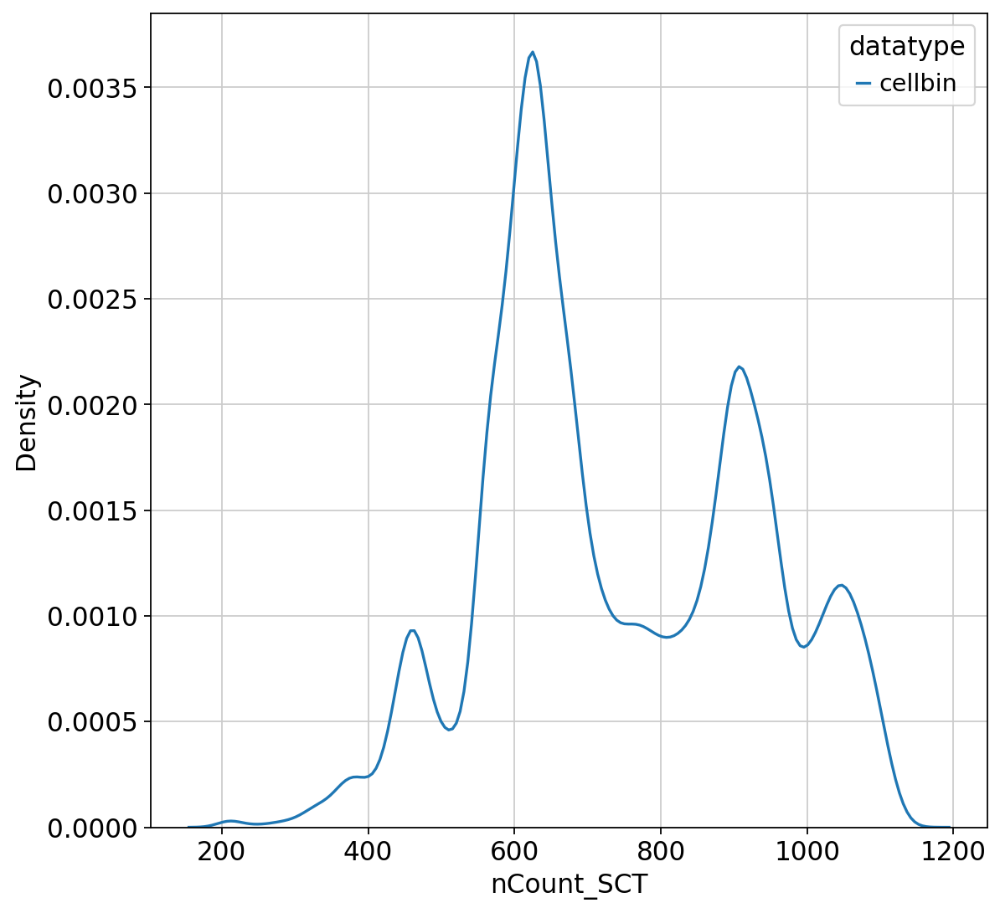

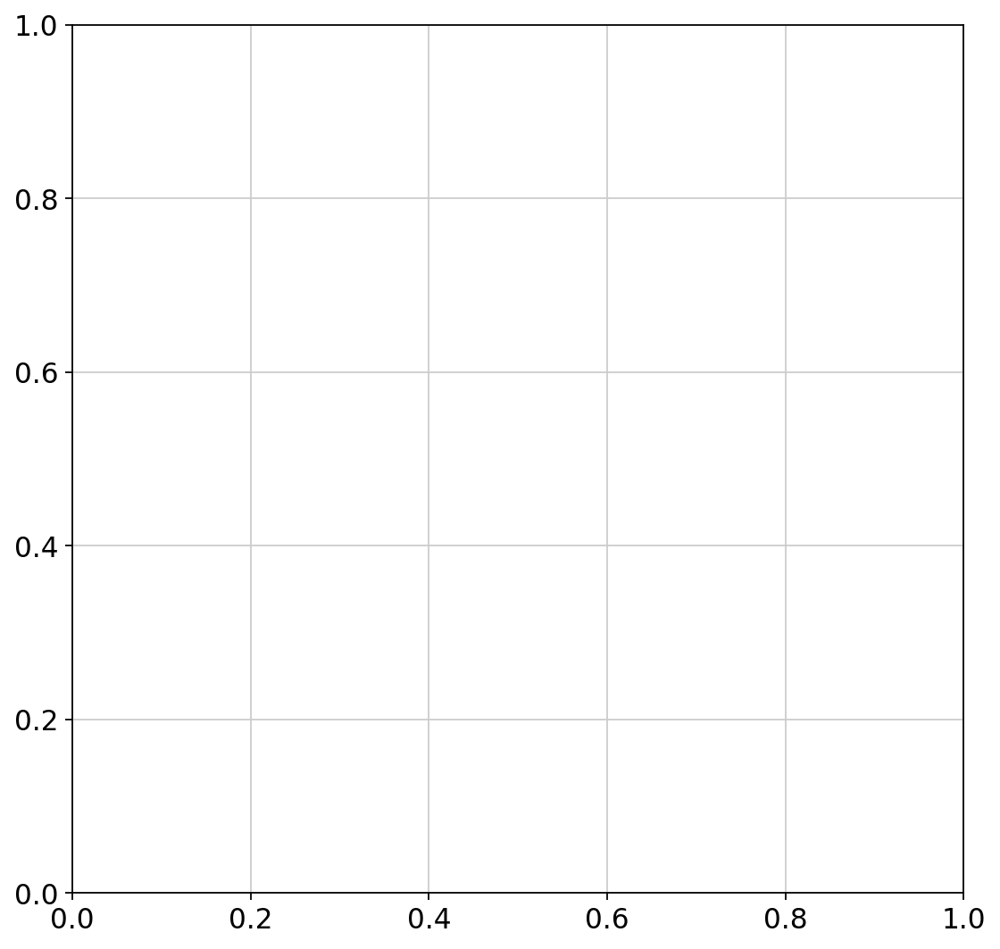

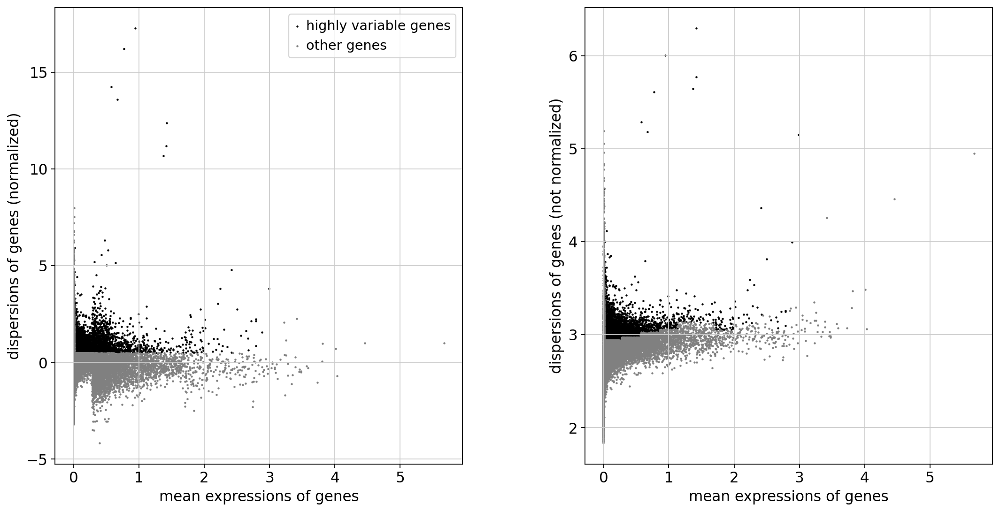

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:56:48)
computing PCA
    with n_comps=50
    finished (0:03:10)


2024-08-28 12:54:01,794 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 12:54:01,794 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 12:54:37,258 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 12:54:37,258 - INFO - sklearn.KMeans initialization complete.
2024-08-28 12:54:39,877 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 12:54:39,877 - INFO - Iteration 1 of 10
2024-08-28 12:57:45,525 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 12:57:45,525 - INFO - Iteration 2 of 10
2024-08-28 13:00:29,801 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 13:00:29,801 - INFO - Iteration 3 of 10
2024-08-28 13:02:04,245 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 13:02:04,245 - INFO - Iteration 4 of 10
2024-08-28 13:03:09,772 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 13:03:09,772 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:58)
computing UMAP


IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:05)
Error: HZ5M03-name 'cm' is not defined
Error: HZ5M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


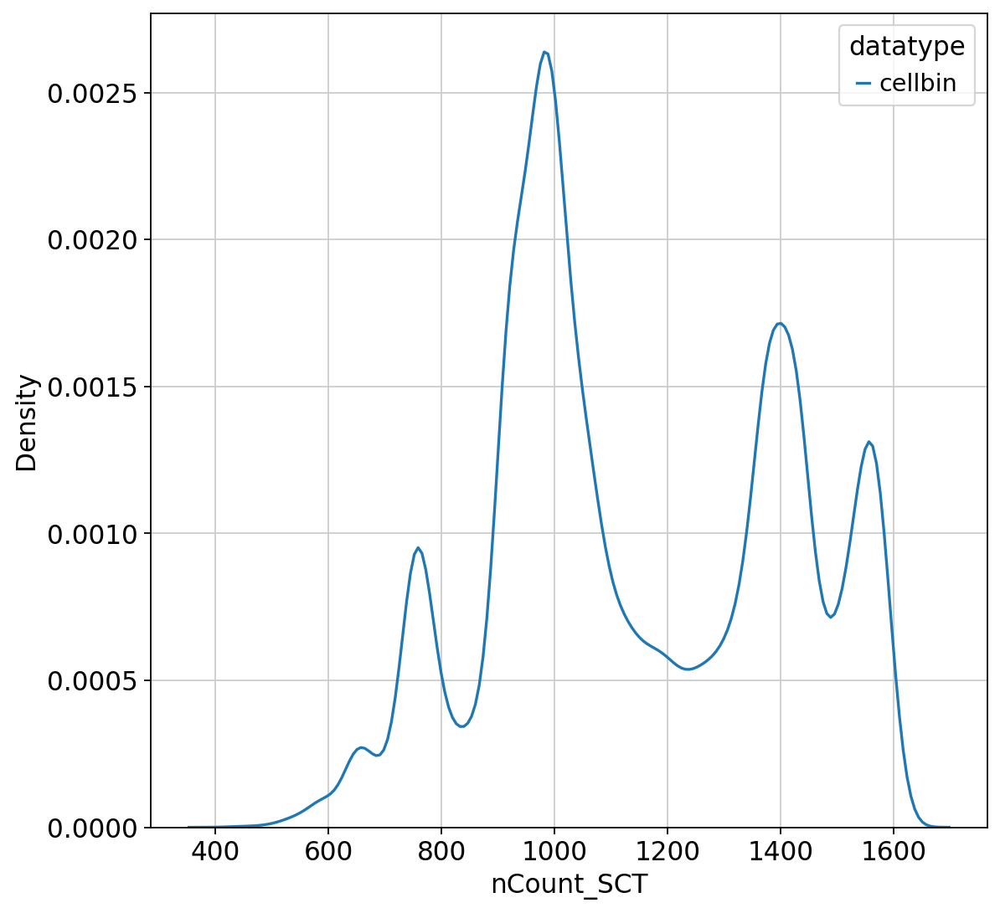

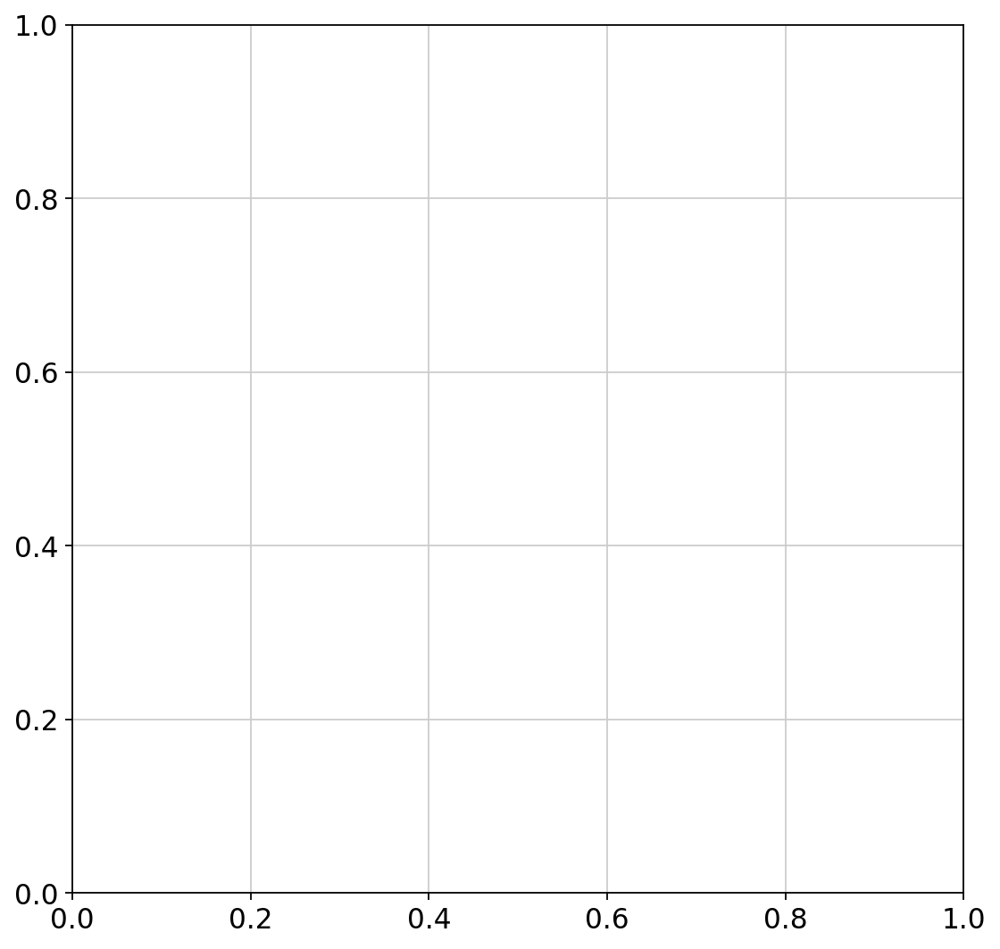

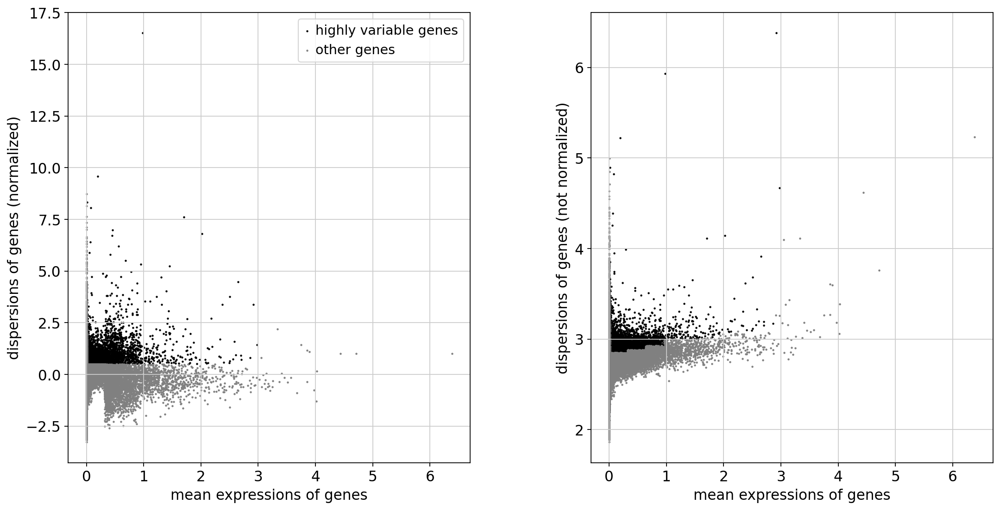

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:46:27)
computing PCA
    with n_comps=50
    finished (0:02:46)


2024-08-28 14:00:30,119 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 14:00:30,119 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 14:01:11,436 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 14:01:11,436 - INFO - sklearn.KMeans initialization complete.
2024-08-28 14:01:13,086 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 14:01:13,086 - INFO - Iteration 1 of 10
2024-08-28 14:04:01,141 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 14:04:01,141 - INFO - Iteration 2 of 10
2024-08-28 14:05:49,014 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 14:05:49,014 - INFO - Iteration 3 of 10
2024-08-28 14:06:36,580 - harmonypy - INFO - Converged after 3 iterations
2024-08-28 14:06:36,580 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:57)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:34)
Error: HZ5M04-name 'cm' is not defined
Error: HZ5M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M05 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


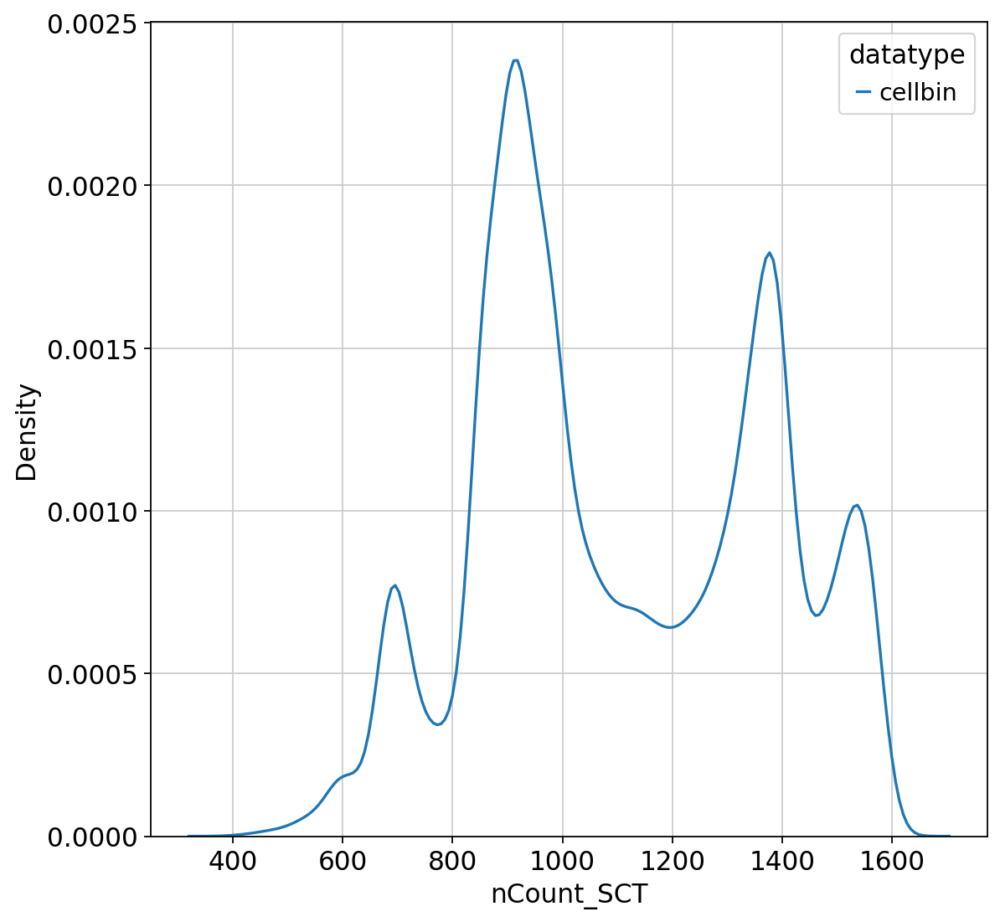

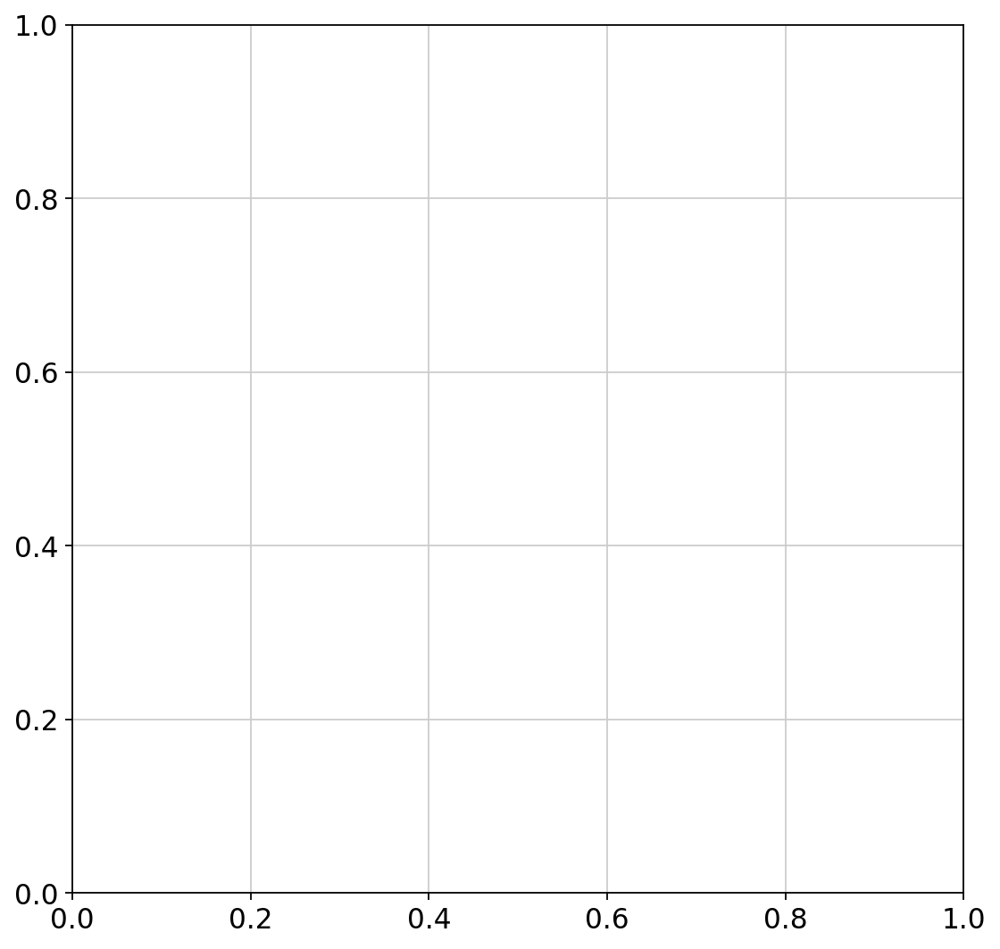

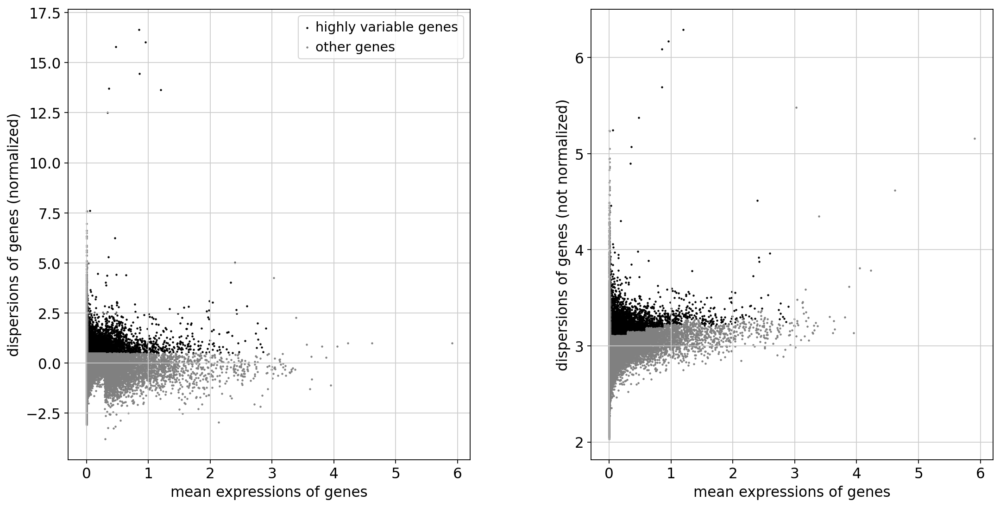

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:49:18)
computing PCA
    with n_comps=50
    finished (0:03:24)


2024-08-28 15:07:36,292 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 15:07:36,292 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 15:08:09,680 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 15:08:09,680 - INFO - sklearn.KMeans initialization complete.
2024-08-28 15:08:12,437 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 15:08:12,437 - INFO - Iteration 1 of 10
2024-08-28 15:11:55,998 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 15:11:55,998 - INFO - Iteration 2 of 10


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:56)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:16)
Error: HZ5M05-name 'cm' is not defined
Error: HZ5M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ5M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


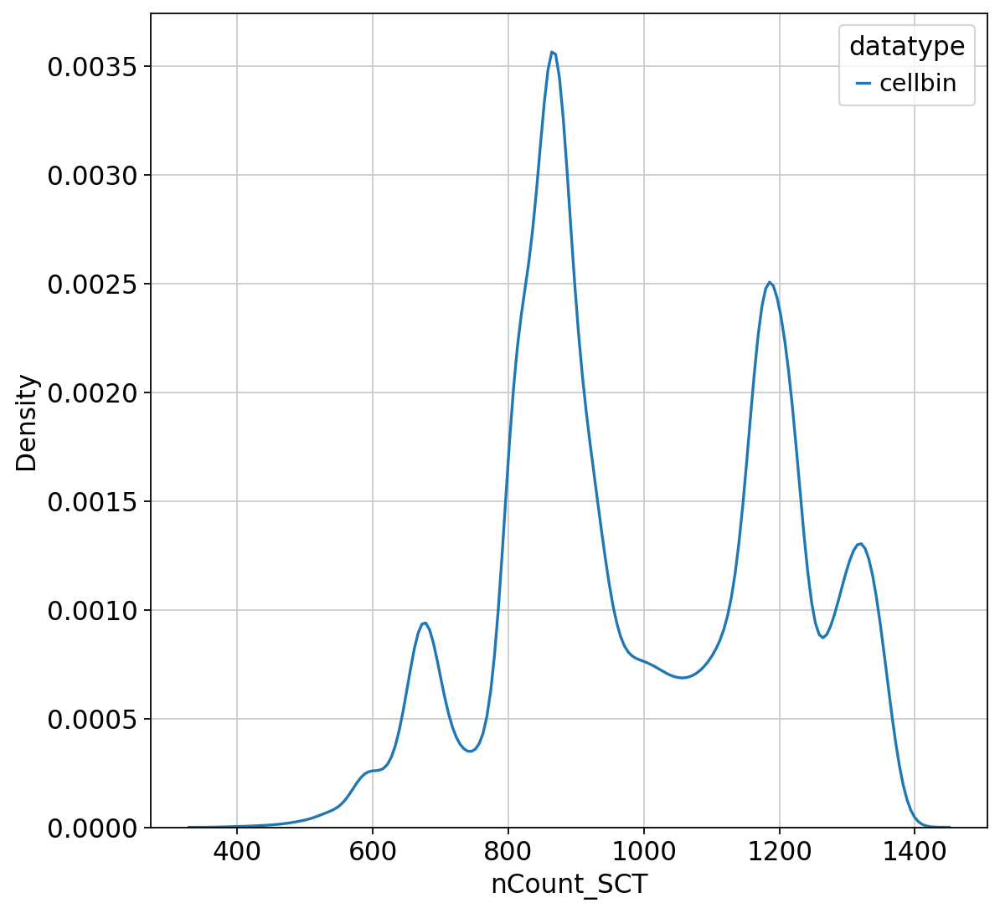

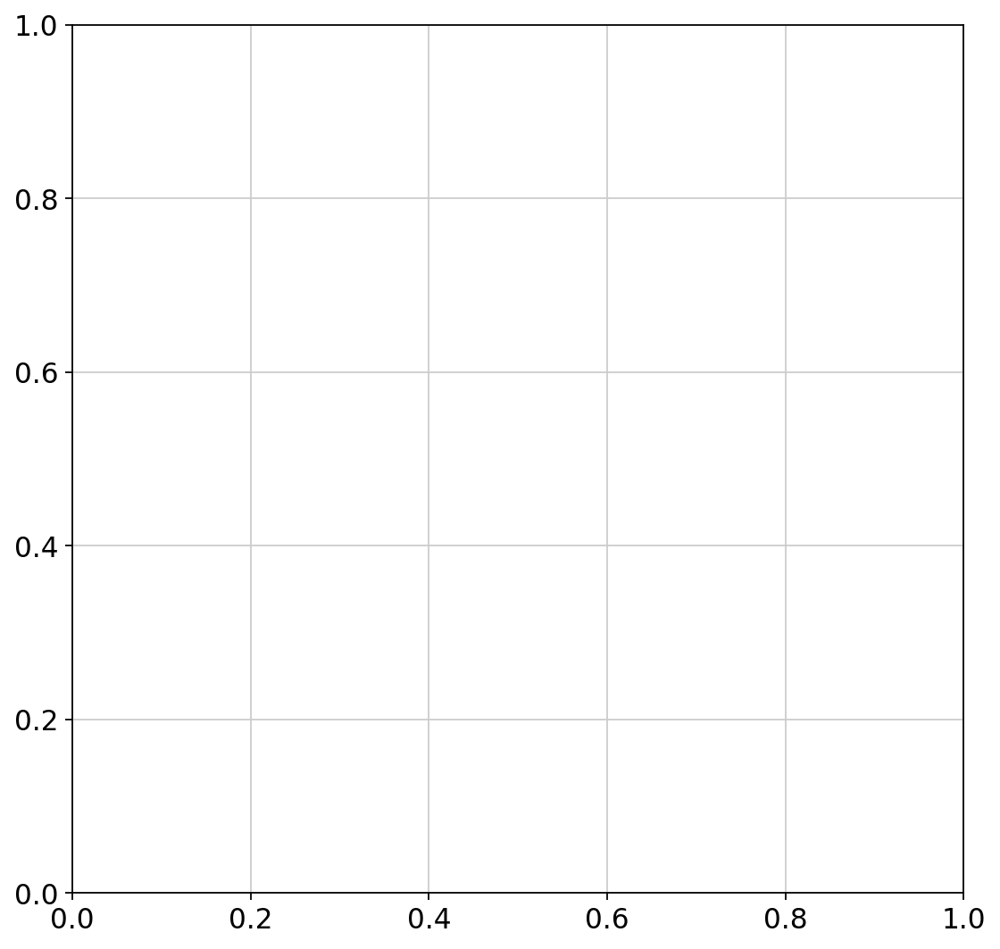

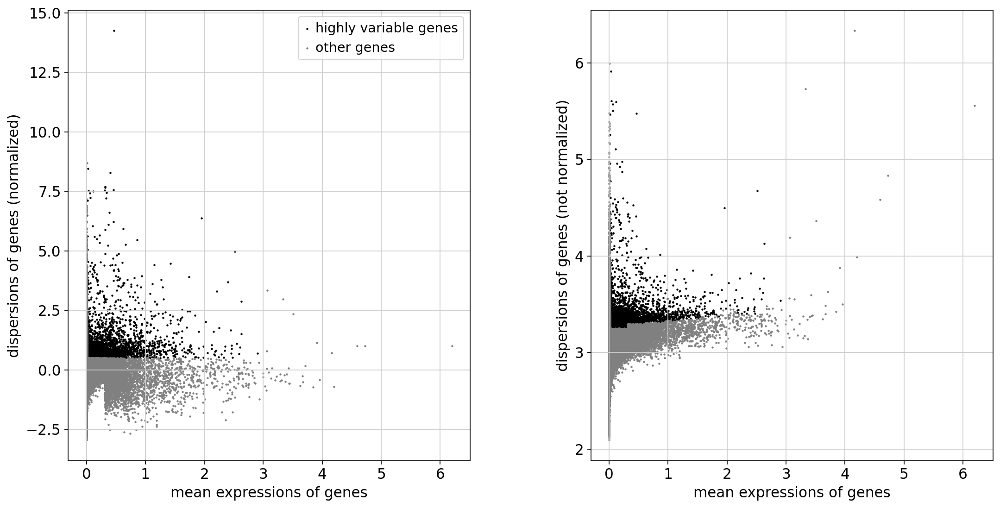

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:42:12)
computing PCA
    with n_comps=50
    finished (0:02:57)


2024-08-28 16:09:01,128 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 16:09:01,128 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 16:09:40,667 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 16:09:40,667 - INFO - sklearn.KMeans initialization complete.
2024-08-28 16:09:43,267 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 16:09:43,267 - INFO - Iteration 1 of 10
2024-08-28 16:13:10,034 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 16:13:10,034 - INFO - Iteration 2 of 10
2024-08-28 16:16:19,698 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 16:16:19,698 - INFO - Iteration 3 of 10
2024-08-28 16:18:15,436 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 16:18:15,436 - INFO - Iteration 4 of 10
2024-08-28 16:19:10,830 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 16:19:10,830 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:11)
Error: HZ5M06-name 'cm' is not defined
Error: HZ5M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


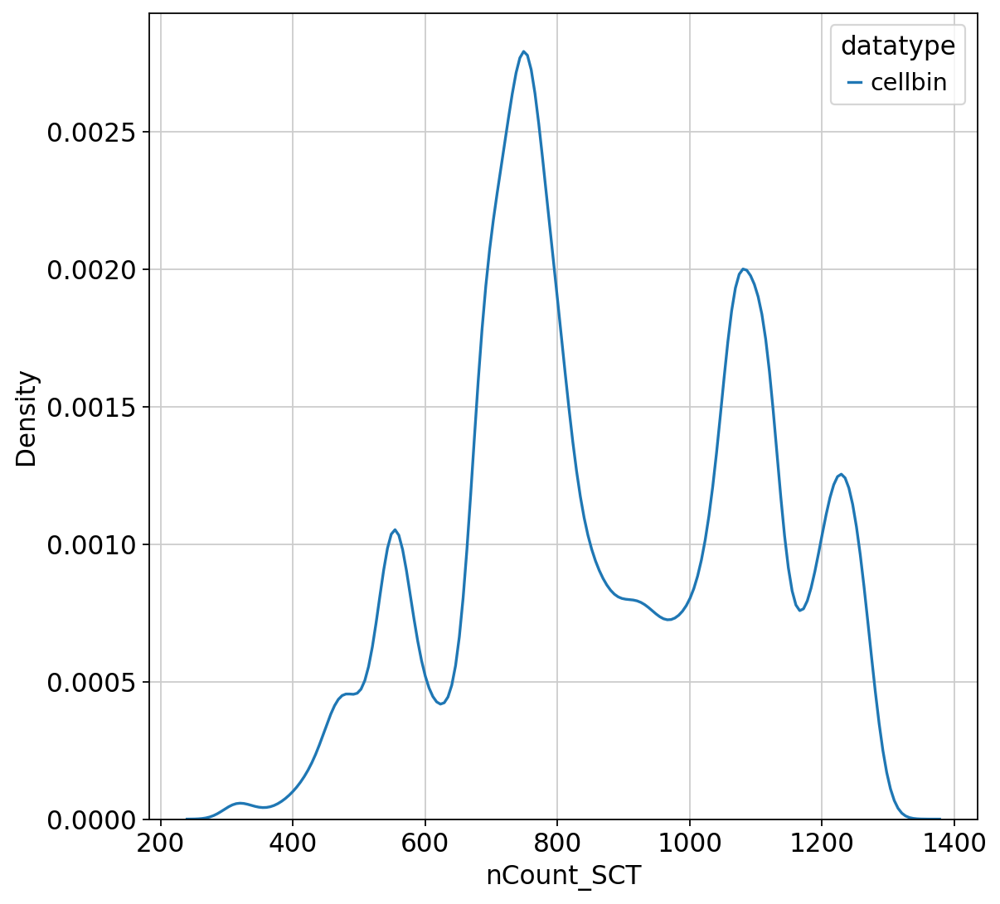

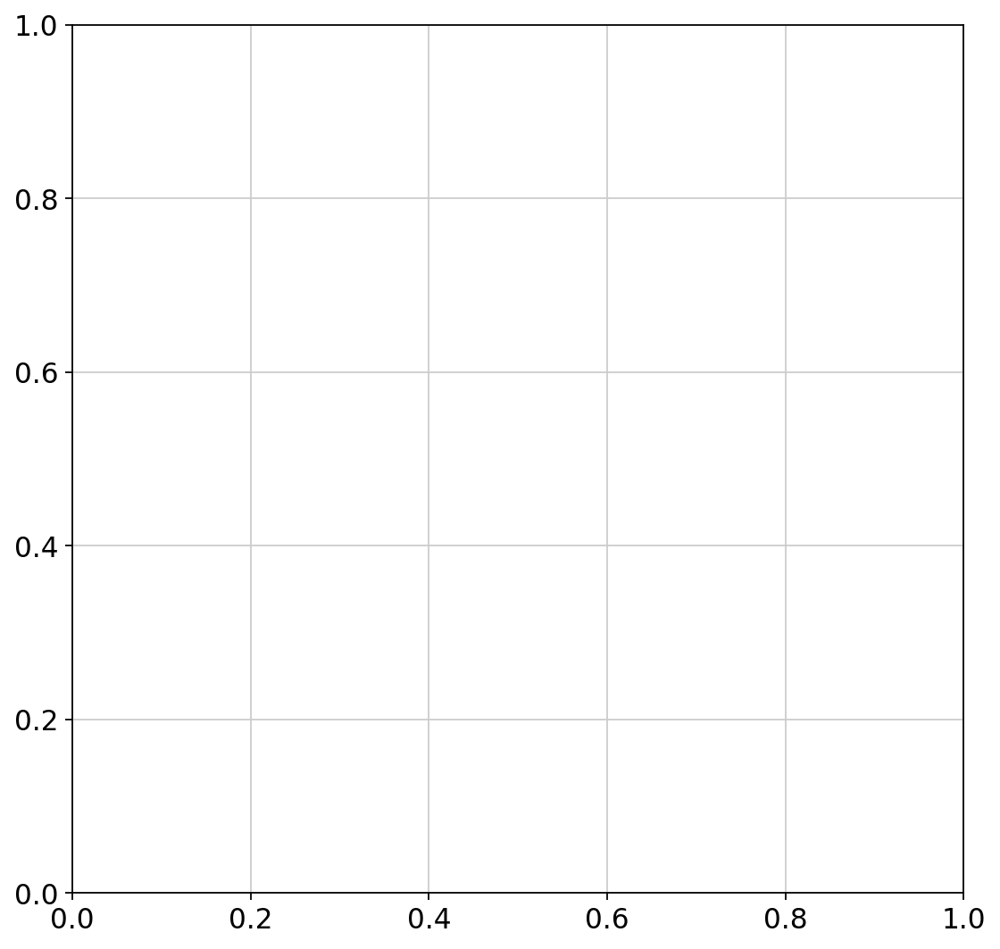

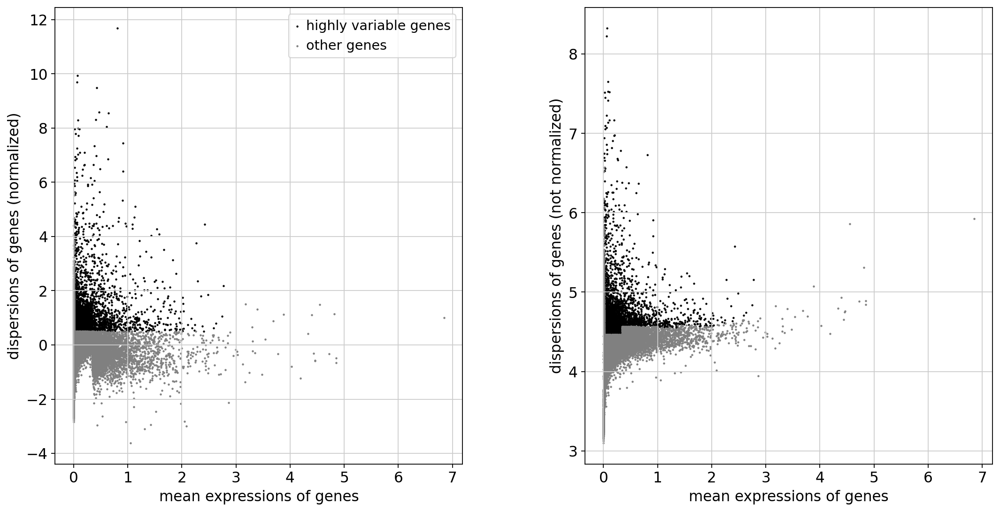

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:52:56)
computing PCA
    with n_comps=50
    finished (0:03:15)


2024-08-28 17:24:08,975 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 17:24:08,975 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 17:24:49,657 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 17:24:49,657 - INFO - sklearn.KMeans initialization complete.
2024-08-28 17:24:51,132 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 17:24:51,132 - INFO - Iteration 1 of 10
2024-08-28 17:27:24,114 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 17:27:24,114 - INFO - Iteration 2 of 10
2024-08-28 17:29:56,312 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 17:29:56,312 - INFO - Iteration 3 of 10
2024-08-28 17:31:59,673 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 17:31:59,673 - INFO - Iteration 4 of 10
2024-08-28 17:32:46,275 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 17:32:46,275 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:59)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:29)
Error: HZ6M02-name 'cm' is not defined
Error: HZ6M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6M03 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


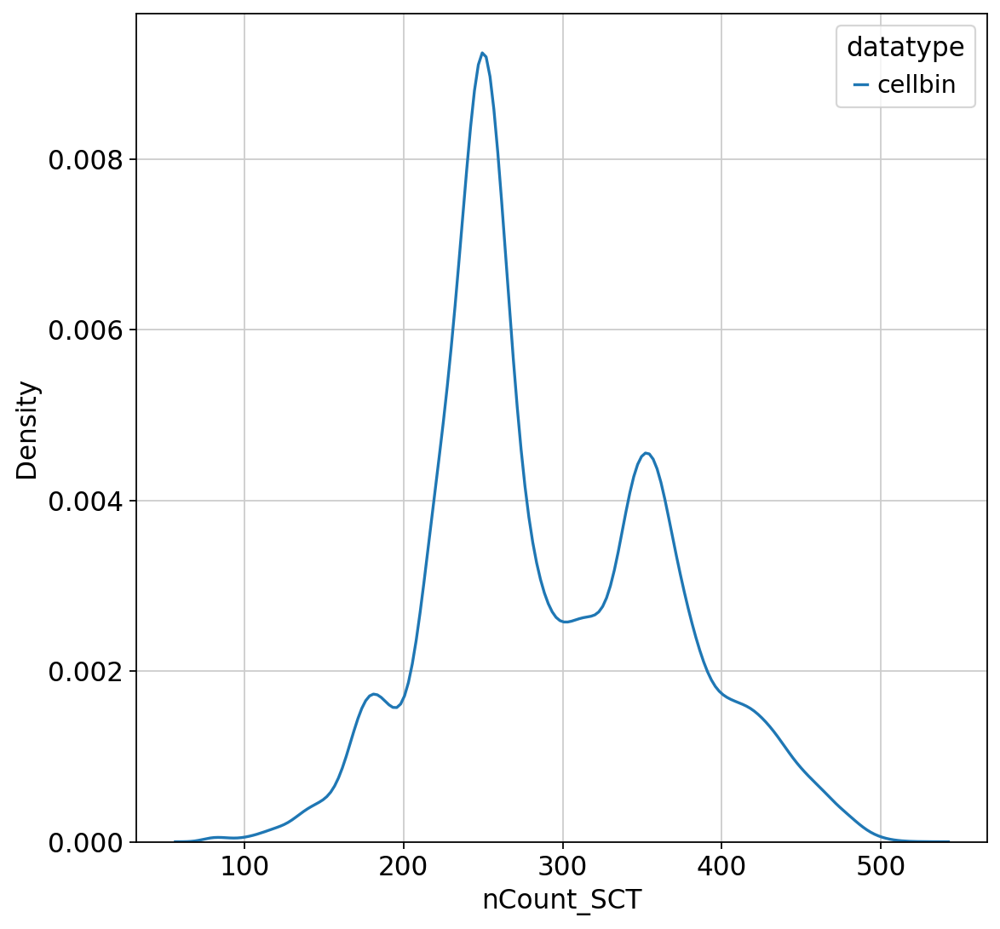

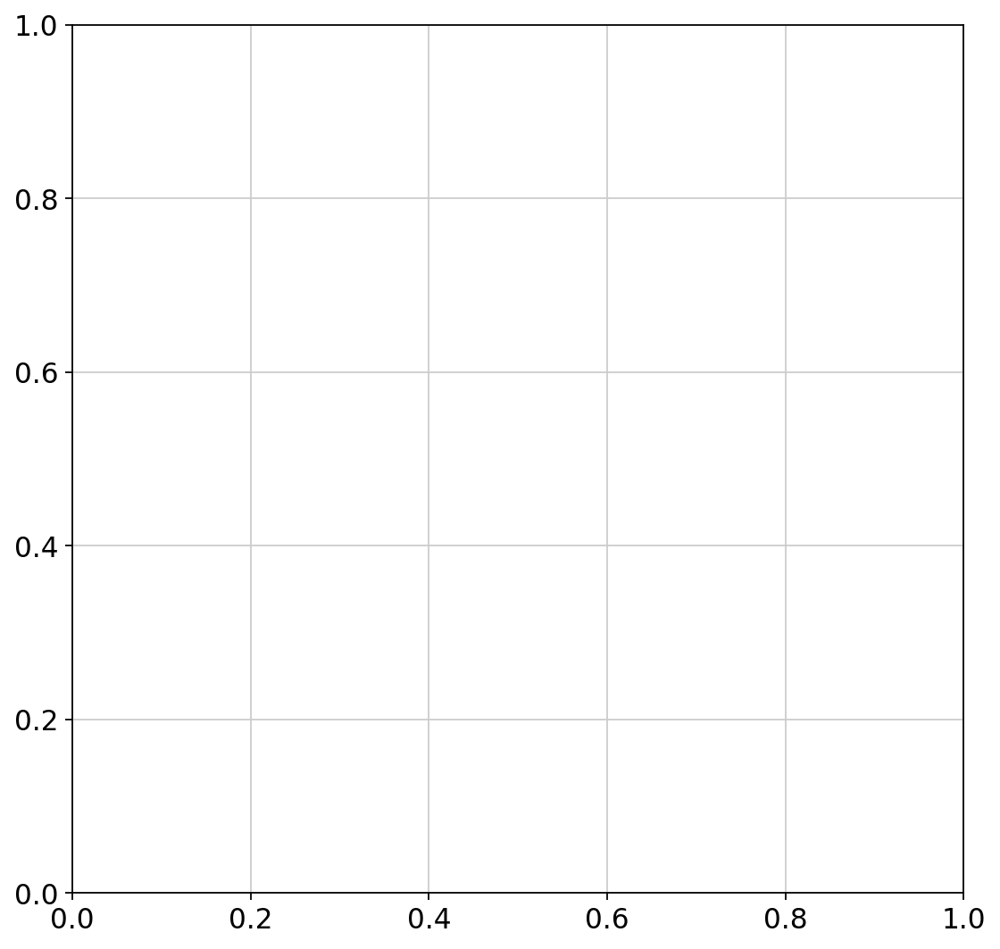

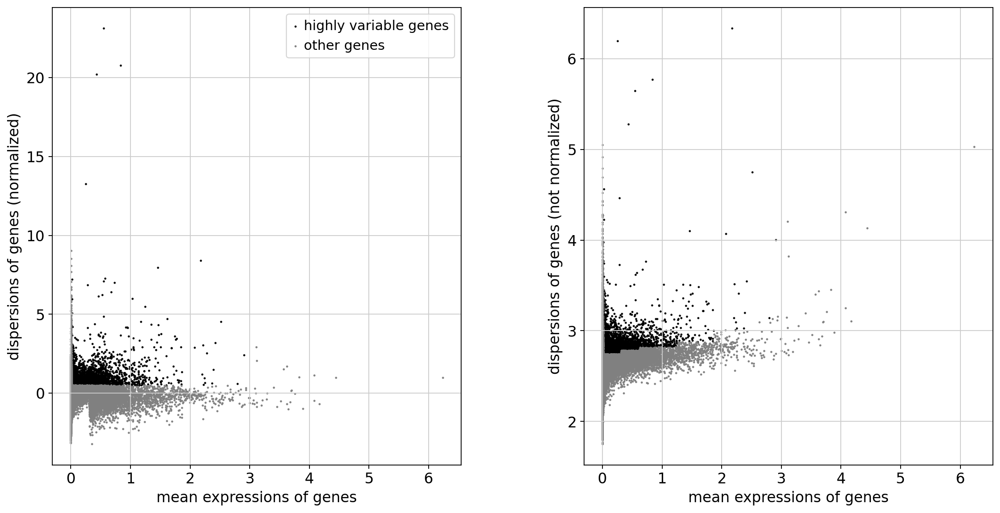

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:30:19)
computing PCA
    with n_comps=50
    finished (0:02:26)


2024-08-28 18:13:50,257 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 18:13:50,257 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 18:14:25,829 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 18:14:25,829 - INFO - sklearn.KMeans initialization complete.
2024-08-28 18:14:27,428 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 18:14:27,428 - INFO - Iteration 1 of 10
2024-08-28 18:16:56,419 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 18:16:56,419 - INFO - Iteration 2 of 10
2024-08-28 18:19:22,355 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 18:19:22,355 - INFO - Iteration 3 of 10
2024-08-28 18:21:43,392 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 18:21:43,392 - INFO - Iteration 4 of 10
2024-08-28 18:22:24,147 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 18:22:24,147 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:45)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:41)
Error: HZ6M03-name 'cm' is not defined
Error: HZ6M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


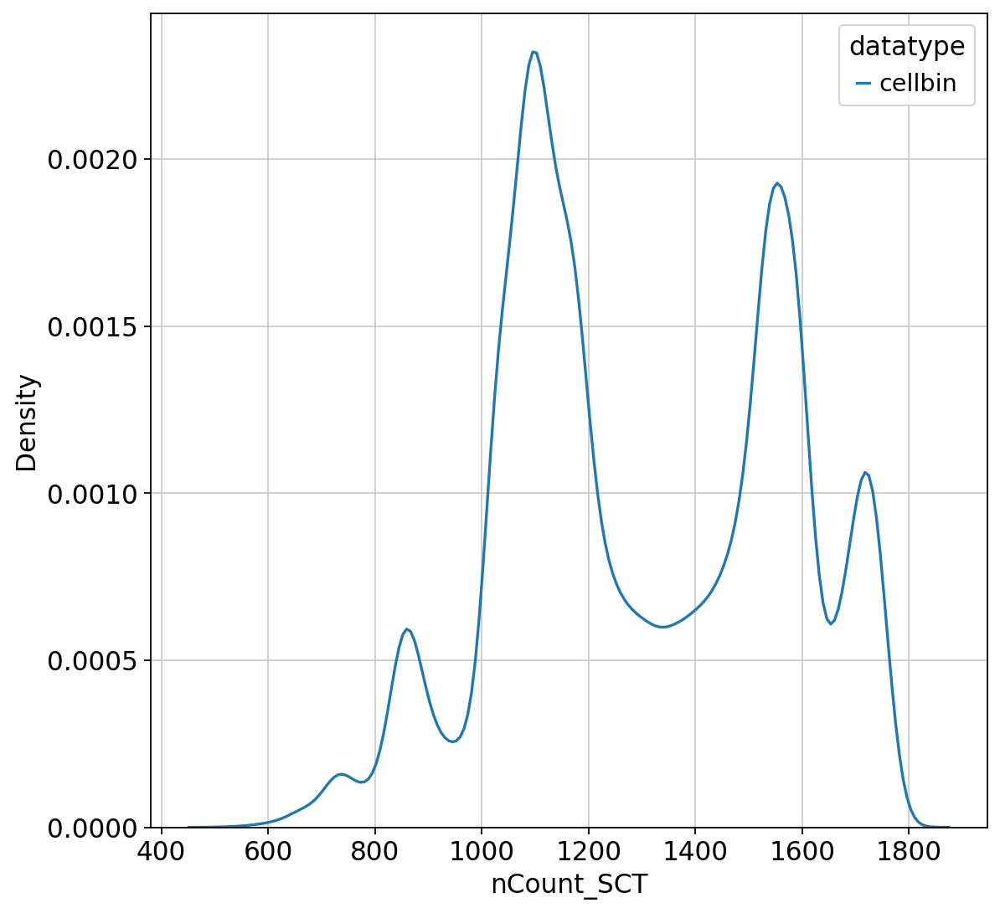

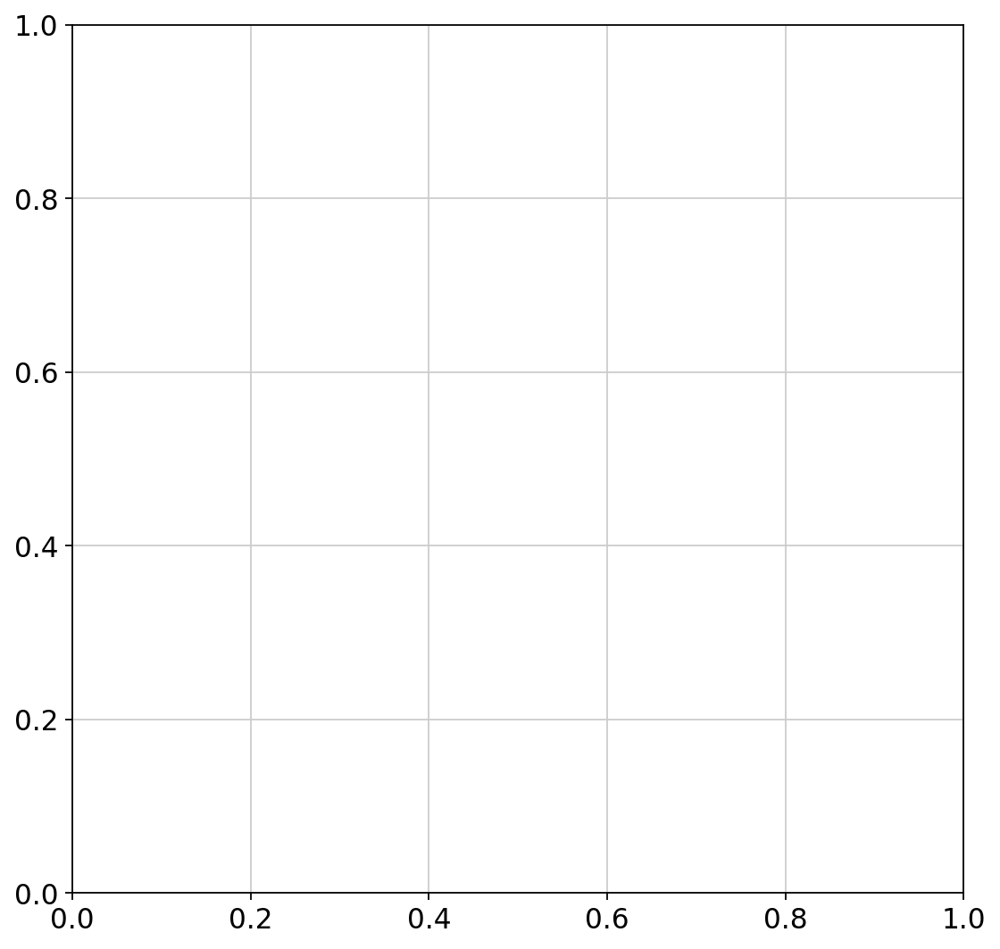

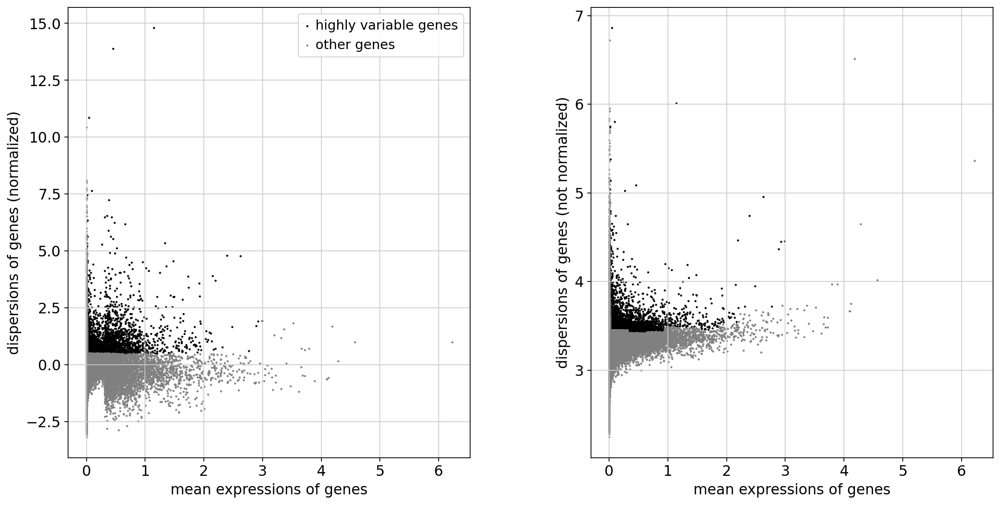

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:52:44)
computing PCA
    with n_comps=50
    finished (0:03:41)


2024-08-28 19:26:10,828 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 19:26:10,828 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 19:27:06,518 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 19:27:06,518 - INFO - sklearn.KMeans initialization complete.
2024-08-28 19:27:10,208 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 19:27:10,208 - INFO - Iteration 1 of 10
2024-08-28 19:31:56,847 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 19:31:56,847 - INFO - Iteration 2 of 10
2024-08-28 19:36:06,096 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 19:36:06,096 - INFO - Iteration 3 of 10
2024-08-28 19:40:21,943 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 19:40:21,943 - INFO - Iteration 4 of 10
2024-08-28 19:41:34,528 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 19:41:34,528 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:30)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:37)
Error: HZ6M04-name 'cm' is not defined
Error: HZ6M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6M05 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


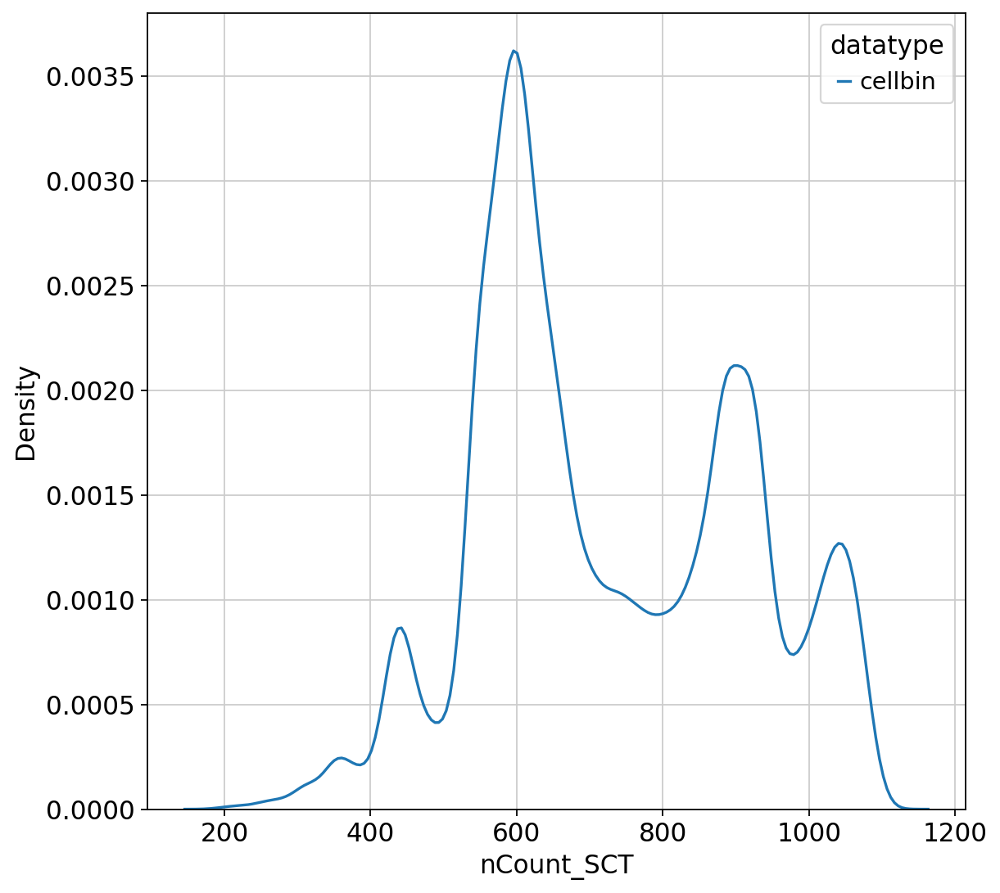

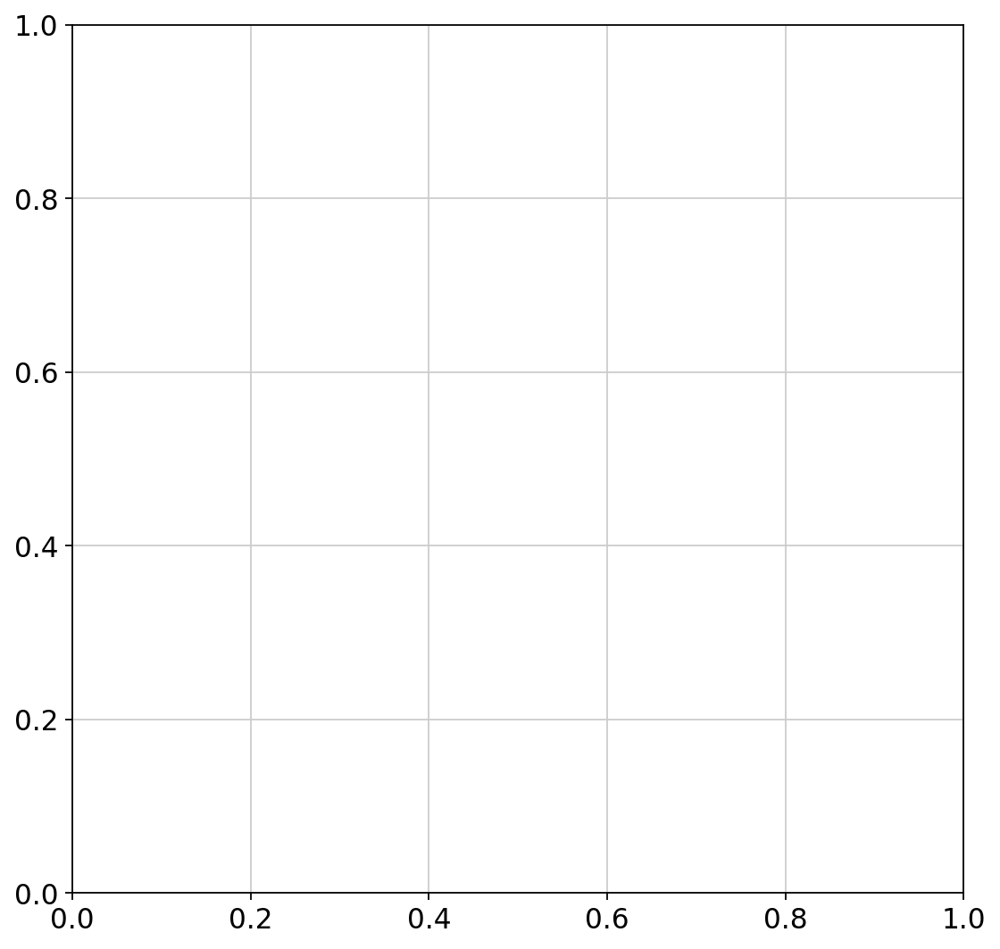

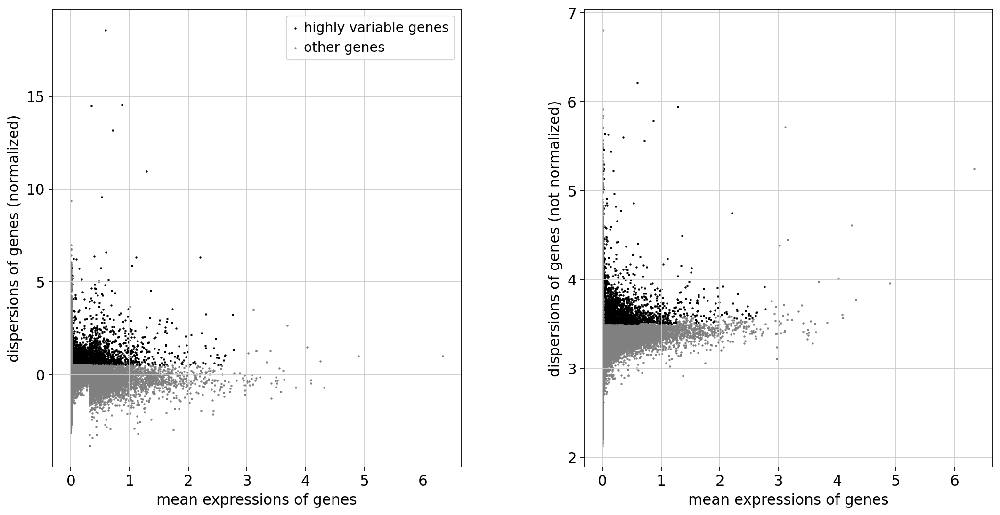

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:48:08)
computing PCA
    with n_comps=50
    finished (0:03:12)


2024-08-28 20:45:05,919 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 20:45:05,919 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 20:45:52,041 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 20:45:52,041 - INFO - sklearn.KMeans initialization complete.
2024-08-28 20:45:54,714 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 20:45:54,714 - INFO - Iteration 1 of 10
2024-08-28 20:49:45,938 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 20:49:45,938 - INFO - Iteration 2 of 10
2024-08-28 20:53:04,998 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 20:53:04,998 - INFO - Iteration 3 of 10
2024-08-28 20:54:13,685 - harmonypy - INFO - Converged after 3 iterations
2024-08-28 20:54:13,685 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:39)
Error: HZ6M05-name 'cm' is not defined
Error: HZ6M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


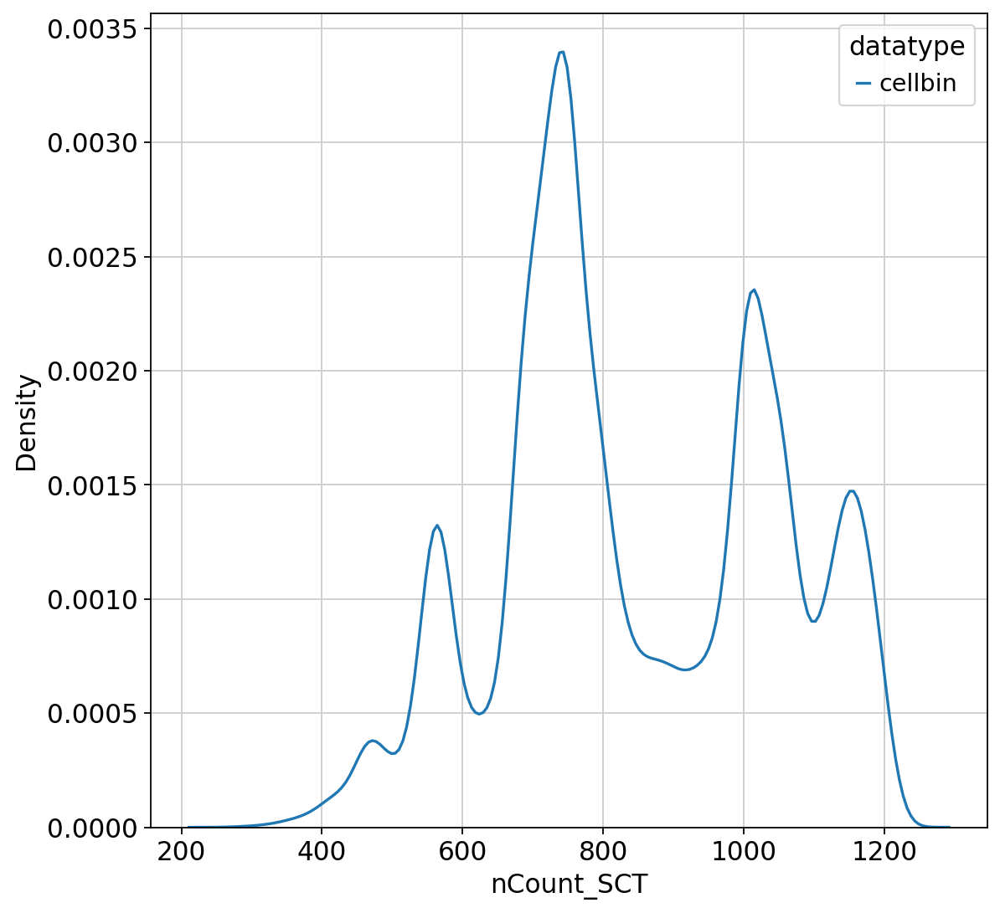

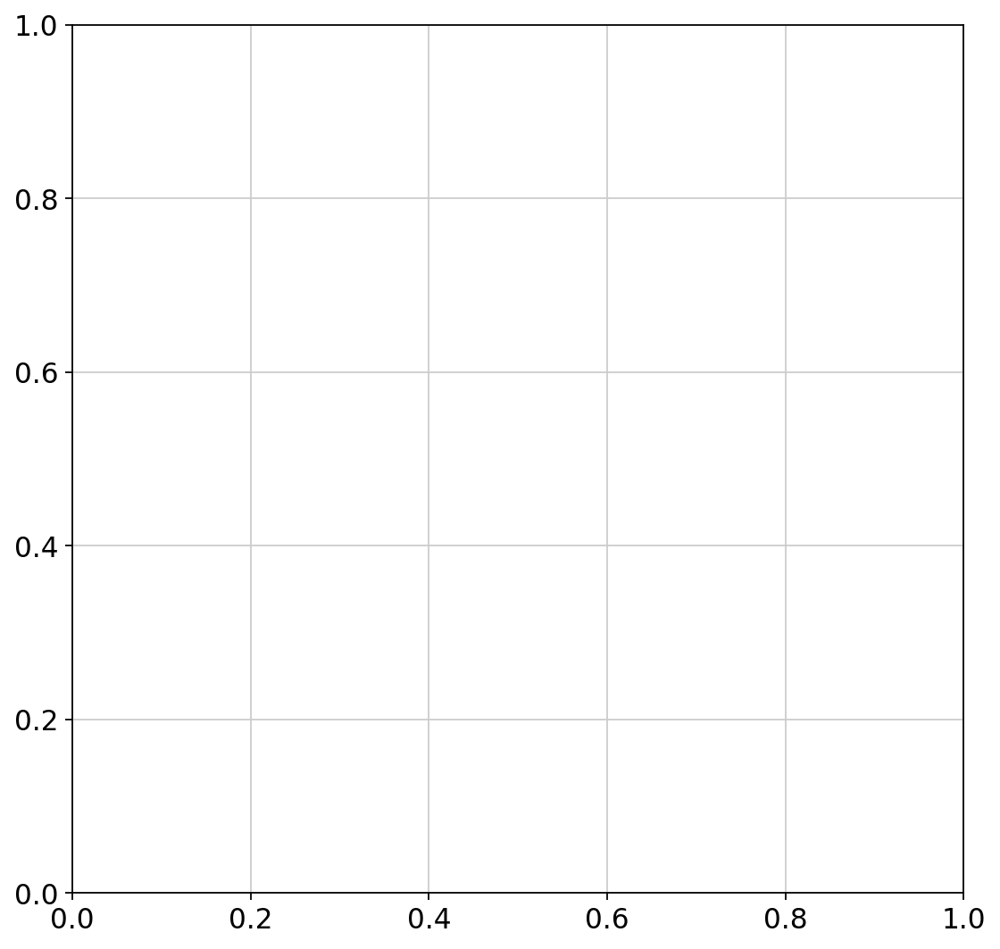

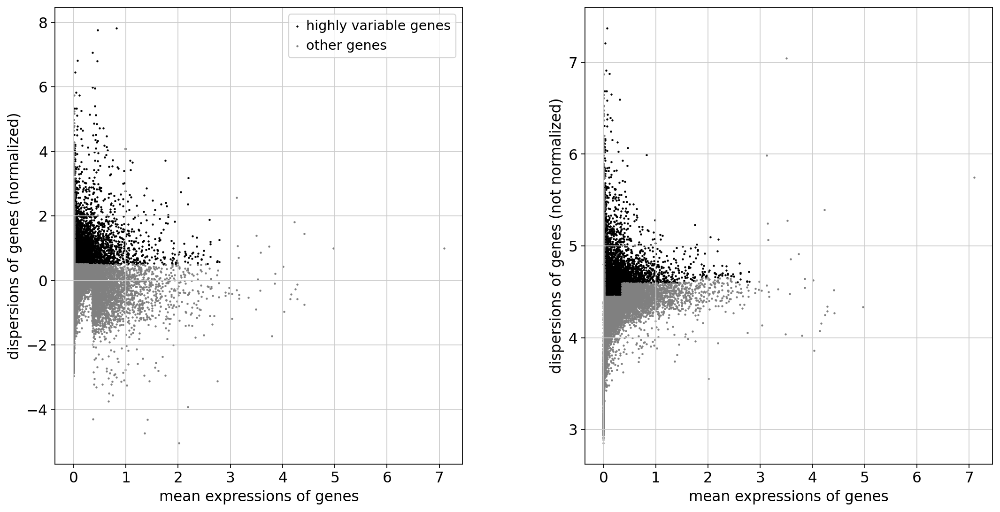

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:16:46)
computing PCA
    with n_comps=50
    finished (0:04:50)


2024-08-28 22:25:39,262 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 22:25:39,262 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-28 22:26:27,648 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-28 22:26:27,648 - INFO - sklearn.KMeans initialization complete.
2024-08-28 22:26:30,973 - harmonypy - INFO - Iteration 1 of 10
2024-08-28 22:26:30,973 - INFO - Iteration 1 of 10
2024-08-28 22:30:47,687 - harmonypy - INFO - Iteration 2 of 10
2024-08-28 22:30:47,687 - INFO - Iteration 2 of 10
2024-08-28 22:34:23,500 - harmonypy - INFO - Iteration 3 of 10
2024-08-28 22:34:23,500 - INFO - Iteration 3 of 10
2024-08-28 22:38:16,458 - harmonypy - INFO - Iteration 4 of 10
2024-08-28 22:38:16,458 - INFO - Iteration 4 of 10
2024-08-28 22:39:19,169 - harmonypy - INFO - Converged after 4 iterations
2024-08-28 22:39:19,169 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:17)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:44)
Error: HZ6M06-name 'cm' is not defined
Error: HZ6M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6MP101 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:04)
extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


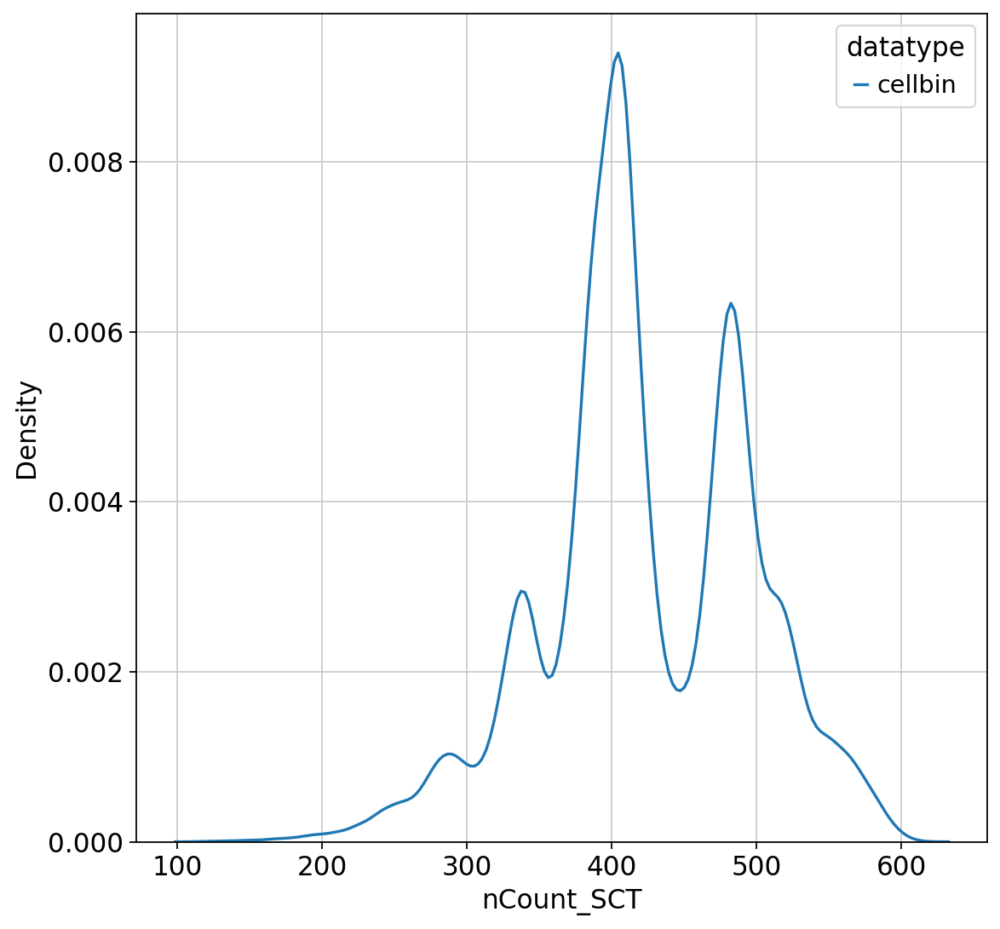

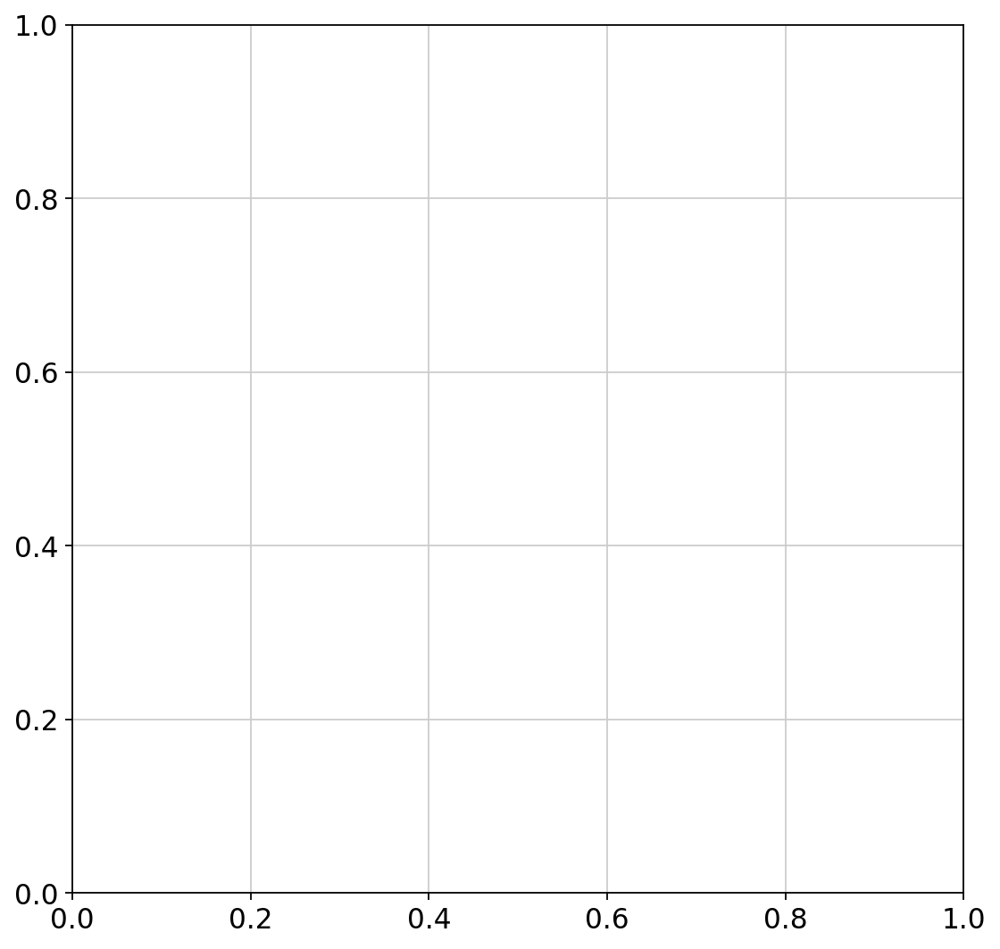

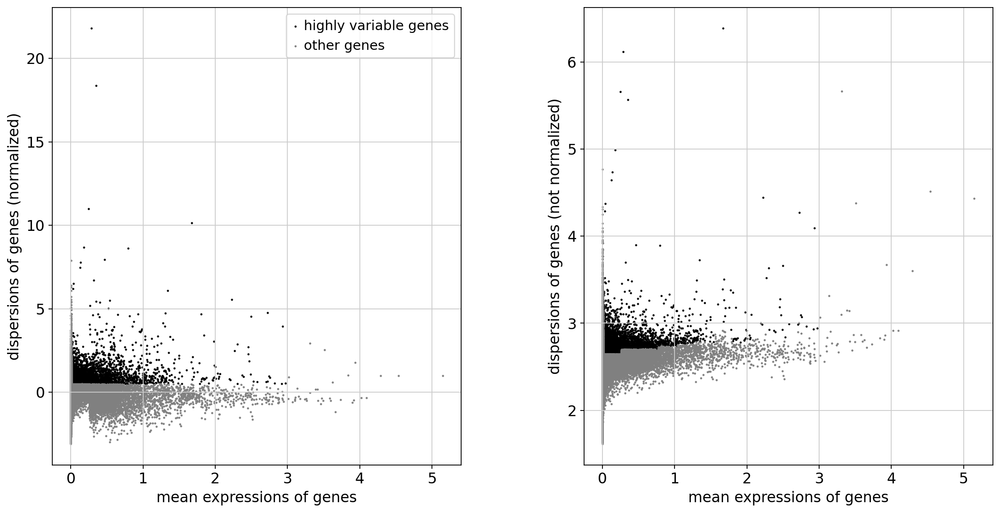

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:07:02)
computing PCA
    with n_comps=50
    finished (0:03:22)


2024-08-29 00:01:34,952 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 00:01:34,952 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 00:02:27,212 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 00:02:27,212 - INFO - sklearn.KMeans initialization complete.
2024-08-29 00:02:30,535 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 00:02:30,535 - INFO - Iteration 1 of 10
2024-08-29 00:07:13,480 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 00:07:13,480 - INFO - Iteration 2 of 10
2024-08-29 00:11:19,997 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 00:11:19,997 - INFO - Iteration 3 of 10
IOStream.flush timed out
IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:22)
Error: HZ6MP101-name 'cm' is not defined
Error: HZ6MP101-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6MP102 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:05)
extracting highly variable genes
    finished (0:00:12)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


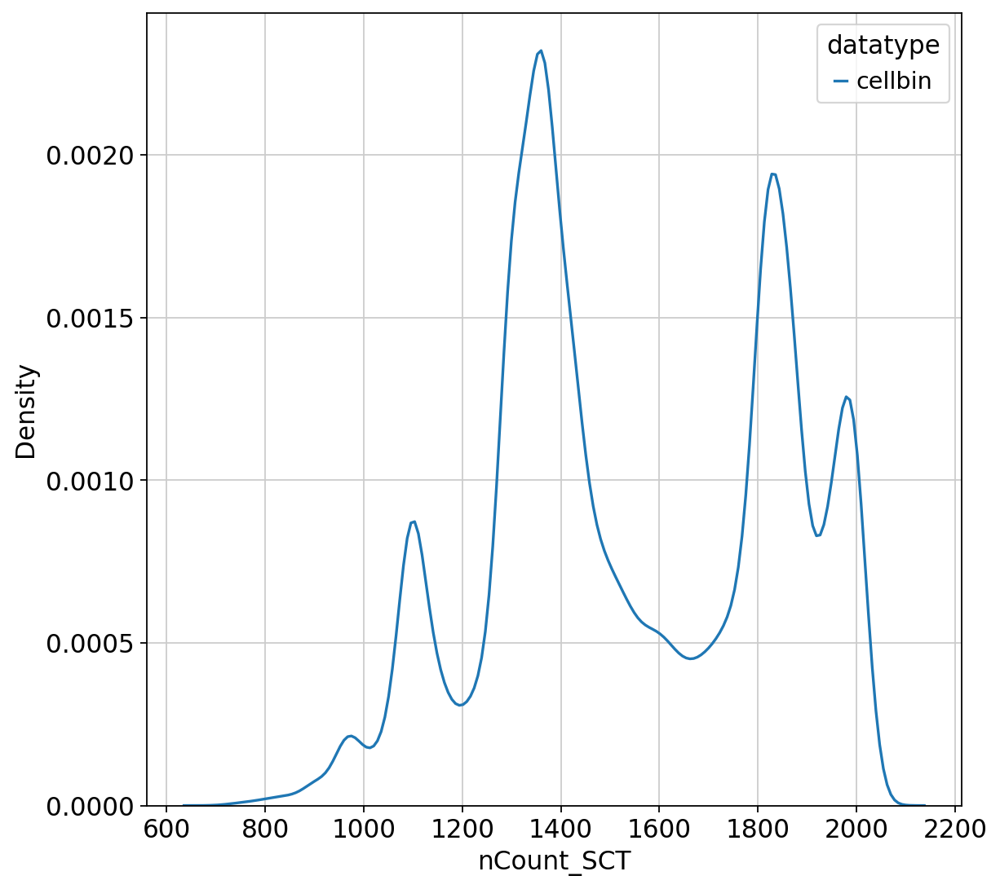

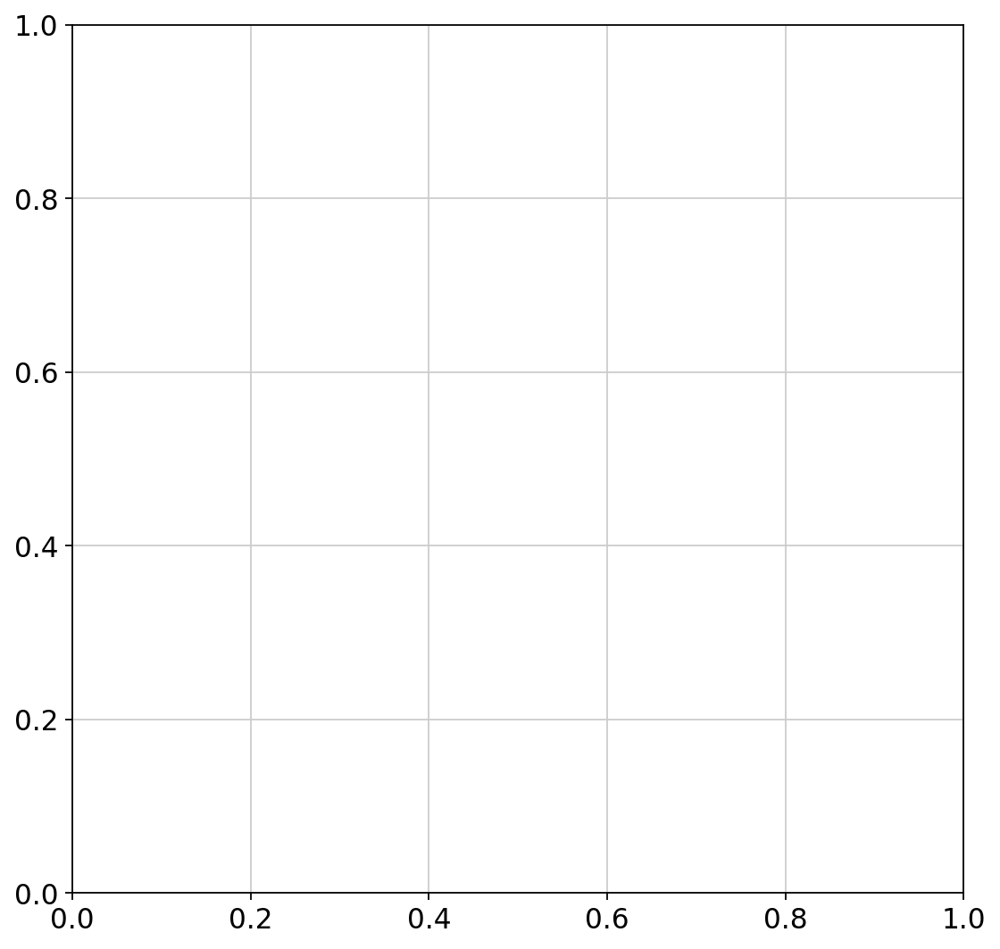

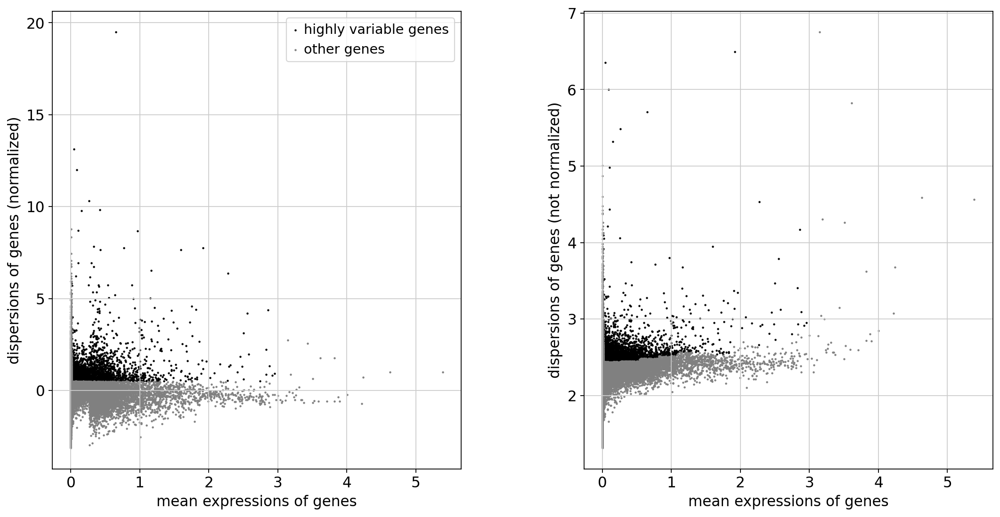

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:51:13)
computing PCA
    with n_comps=50
    finished (0:01:59)


2024-08-29 01:19:38,741 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 01:19:38,741 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 01:20:29,310 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 01:20:29,310 - INFO - sklearn.KMeans initialization complete.
2024-08-29 01:20:33,004 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 01:20:33,004 - INFO - Iteration 1 of 10
2024-08-29 01:25:22,102 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 01:25:22,102 - INFO - Iteration 2 of 10
2024-08-29 01:28:43,538 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 01:28:43,538 - INFO - Iteration 3 of 10
2024-08-29 01:31:05,049 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 01:31:05,049 - INFO - Iteration 4 of 10
2024-08-29 01:32:06,928 - harmonypy - INFO - Converged after 4 iterations
2024-08-29 01:32:06,928 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:29)
Error: HZ6MP102-name 'cm' is not defined
Error: HZ6MP102-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ6MP202 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:05)
extracting highly variable genes
    finished (0:00:10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


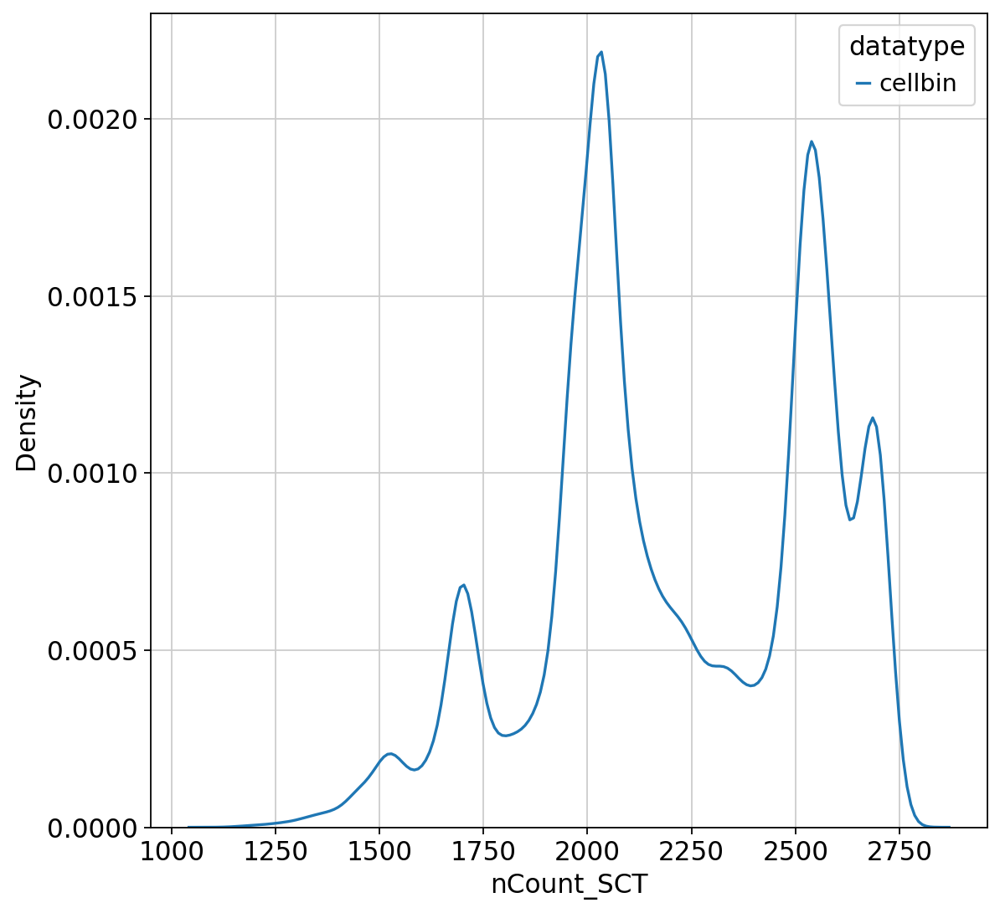

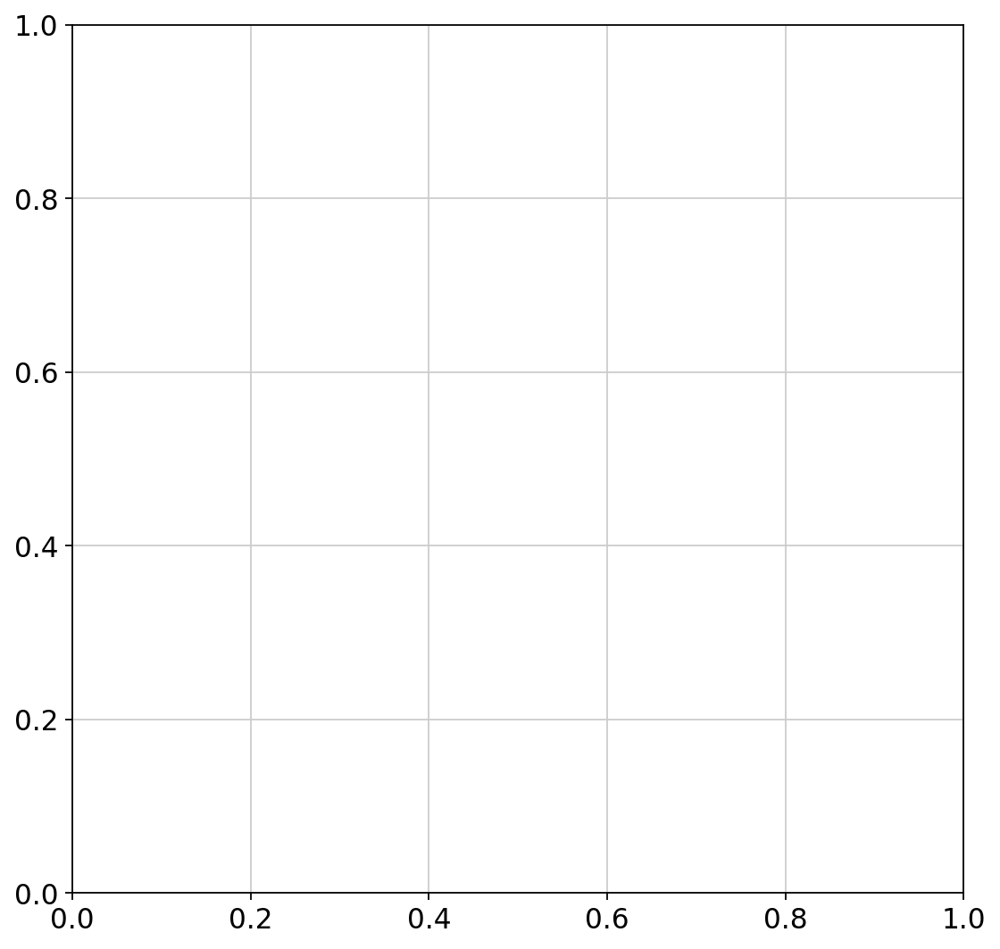

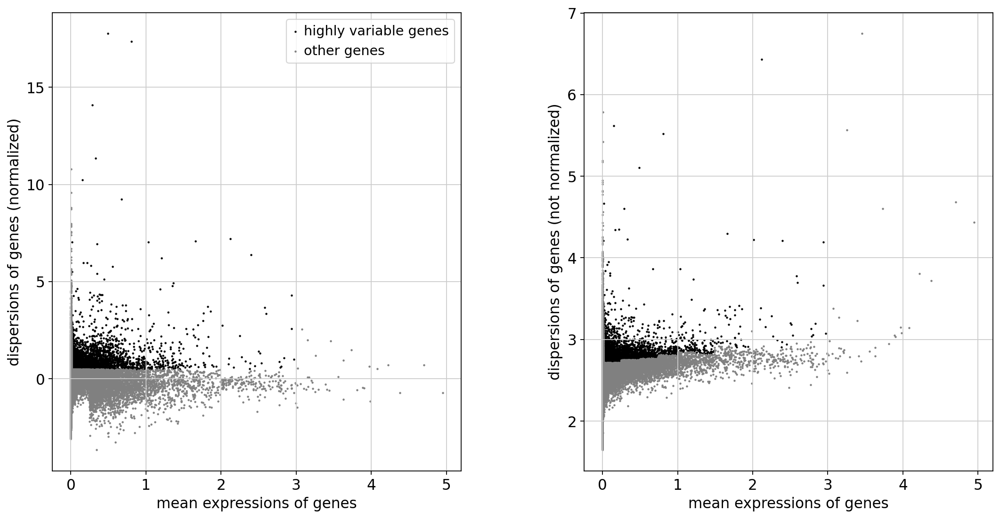

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:58:23)
computing PCA
    with n_comps=50
    finished (0:03:32)


2024-08-29 02:44:19,840 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 02:44:19,840 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 02:45:07,259 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 02:45:07,259 - INFO - sklearn.KMeans initialization complete.
2024-08-29 02:45:11,045 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 02:45:11,045 - INFO - Iteration 1 of 10
2024-08-29 02:51:06,135 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 02:51:06,135 - INFO - Iteration 2 of 10
2024-08-29 02:55:25,019 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 02:55:25,019 - INFO - Iteration 3 of 10
2024-08-29 02:57:03,389 - harmonypy - INFO - Converged after 3 iterations
2024-08-29 02:57:03,389 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:19)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:49)
Error: HZ6MP202-name 'cm' is not defined
Error: HZ6MP202-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


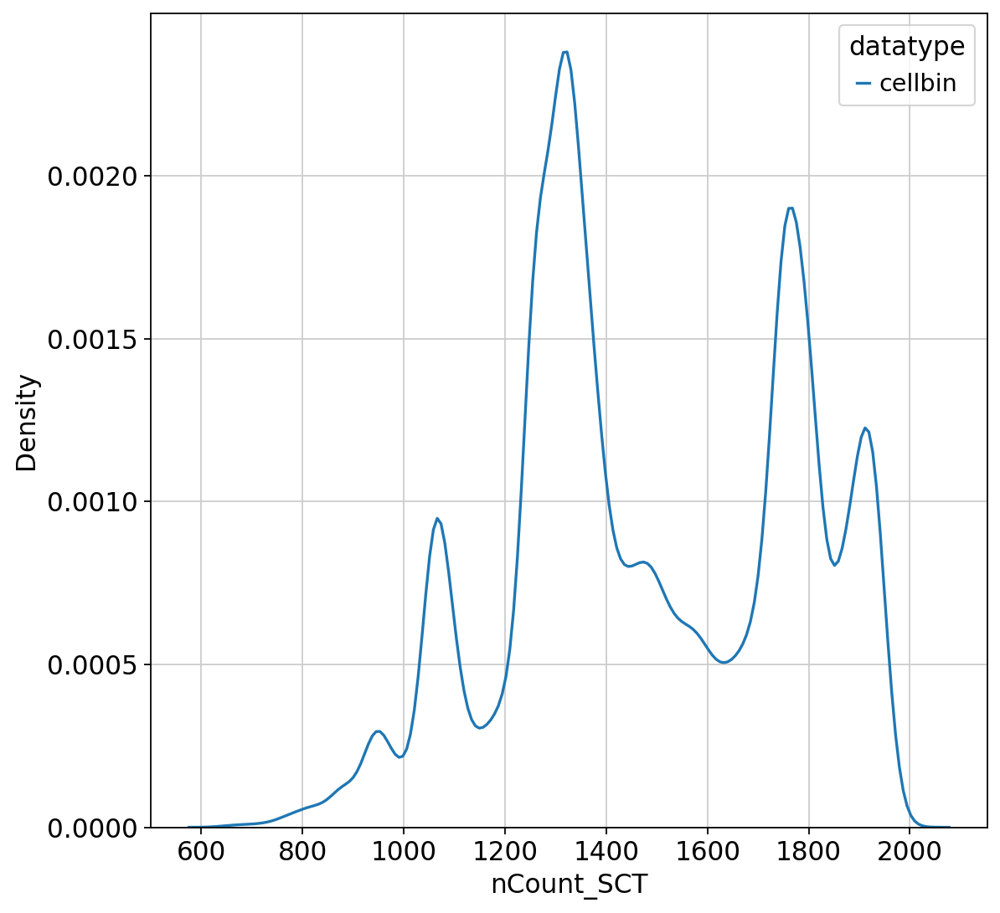

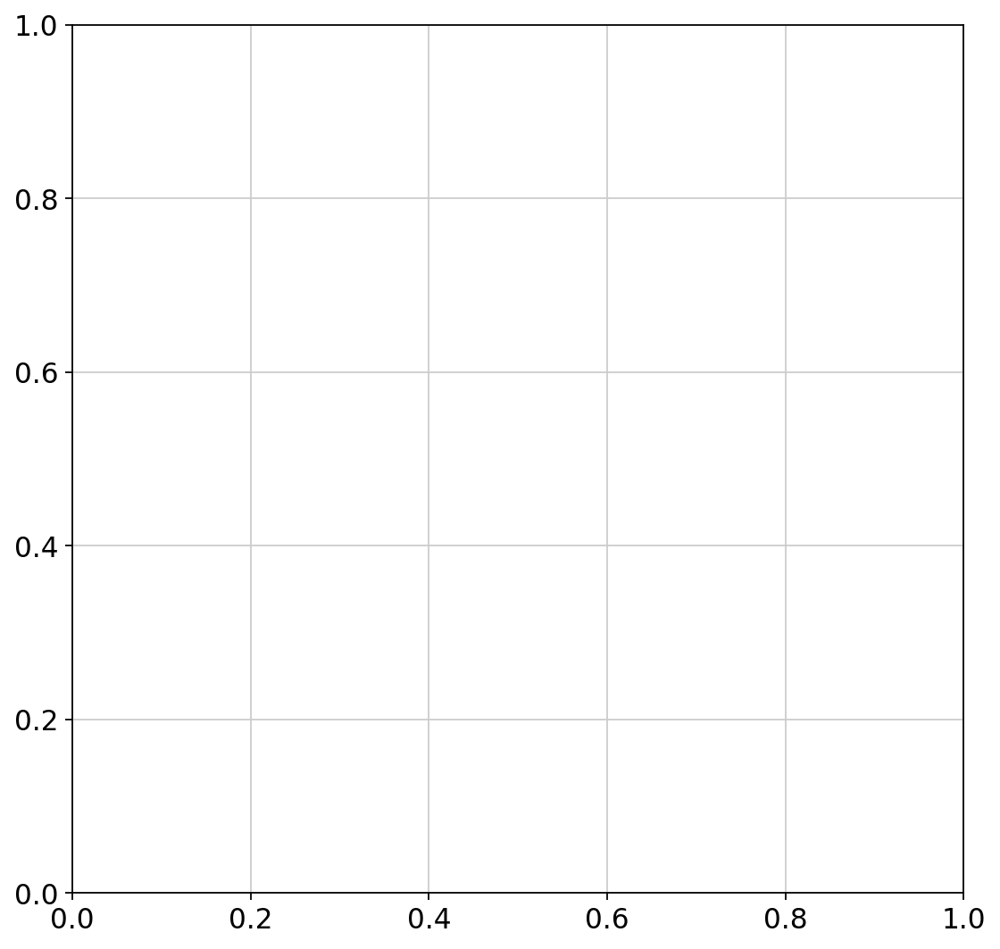

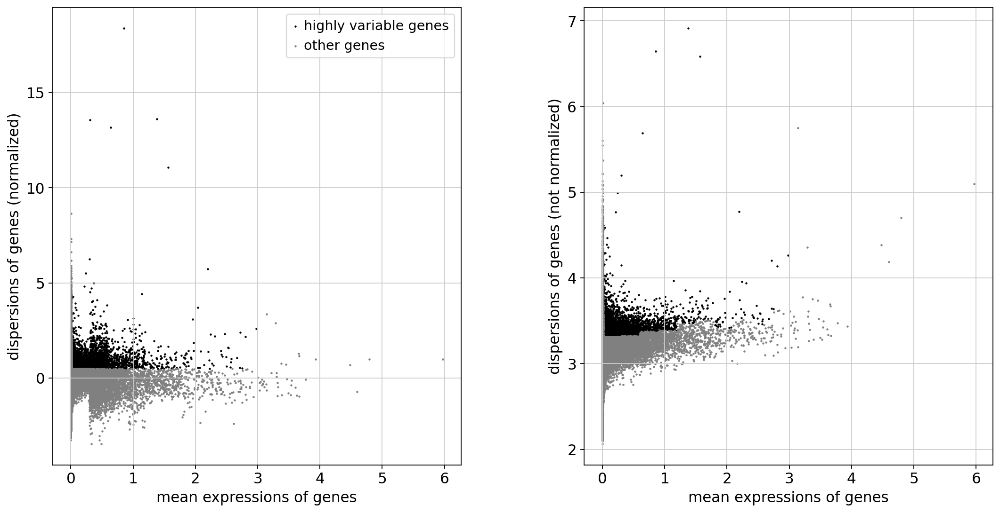

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:55:22)
computing PCA
    with n_comps=50
    finished (0:03:26)


2024-08-29 04:07:25,400 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 04:07:25,400 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 04:08:11,667 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 04:08:11,667 - INFO - sklearn.KMeans initialization complete.
2024-08-29 04:08:13,405 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 04:08:13,405 - INFO - Iteration 1 of 10
2024-08-29 04:11:19,706 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 04:11:19,706 - INFO - Iteration 2 of 10
2024-08-29 04:14:06,316 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 04:14:06,316 - INFO - Iteration 3 of 10
2024-08-29 04:15:28,129 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 04:15:28,129 - INFO - Iteration 4 of 10
2024-08-29 04:16:18,856 - harmonypy - INFO - Converged after 4 iterations
2024-08-29 04:16:18,856 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:31)
Error: HZ8M01-name 'cm' is not defined
Error: HZ8M01-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


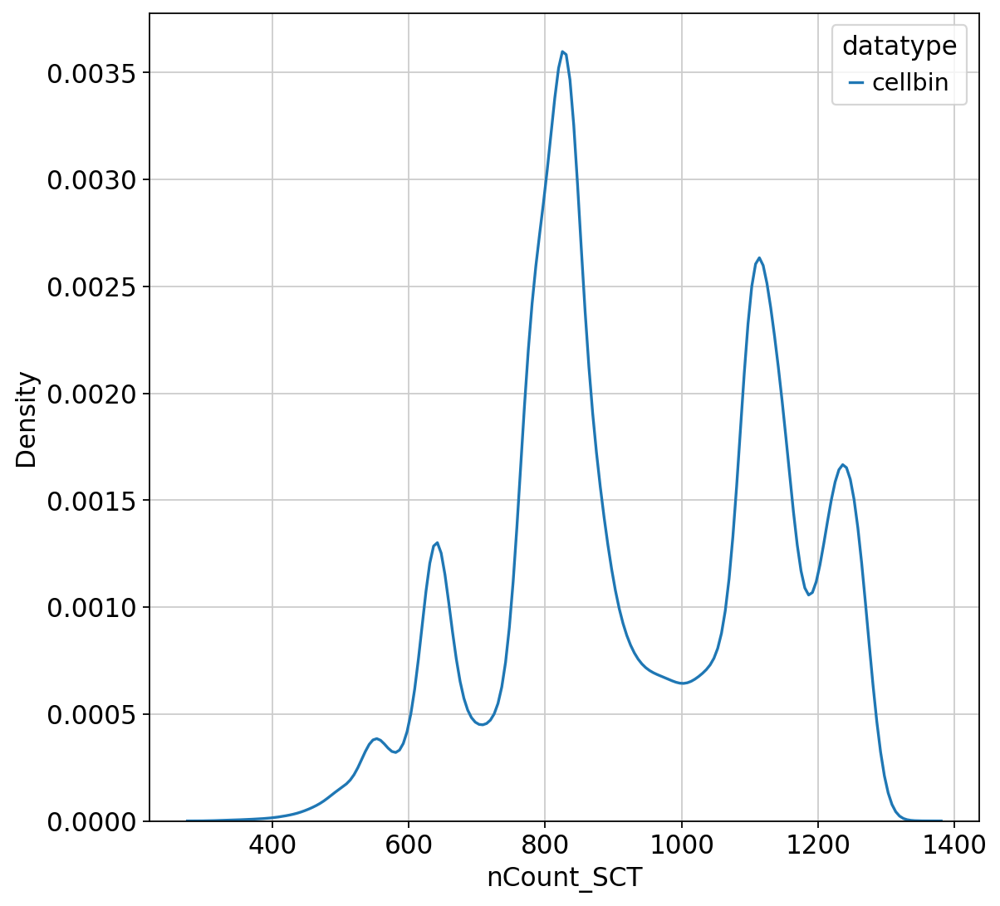

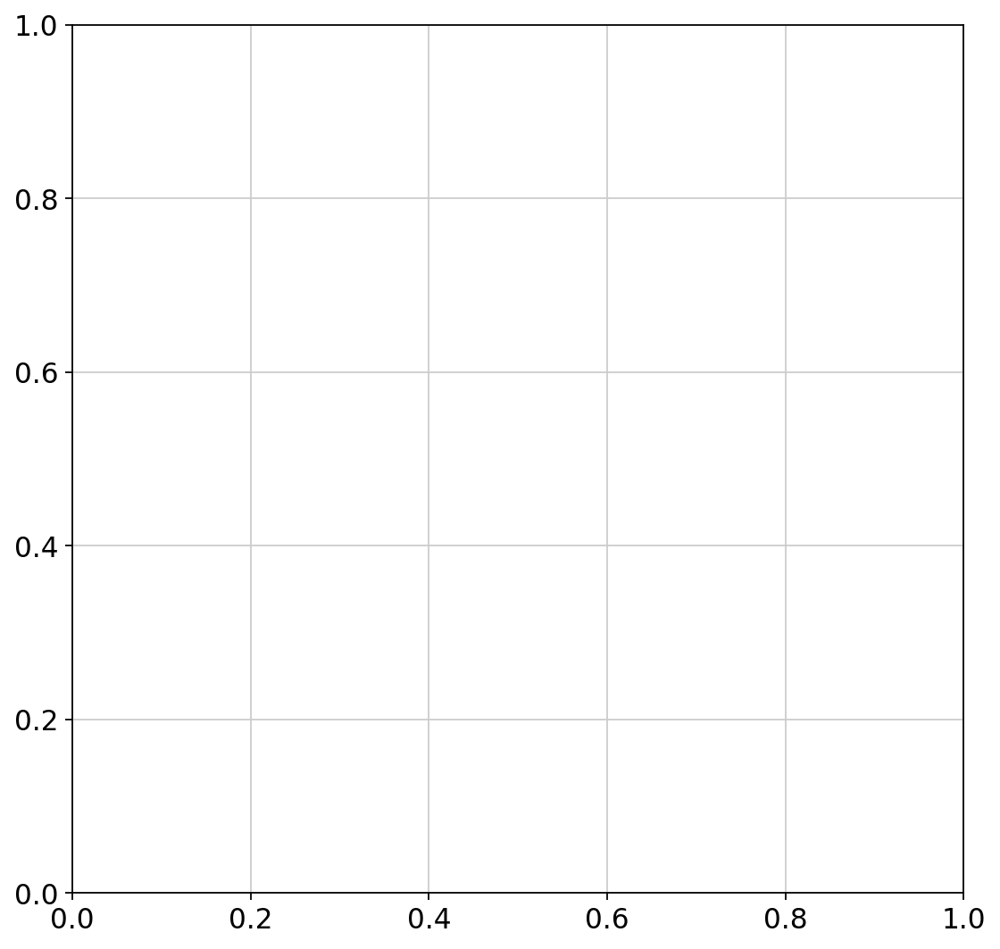

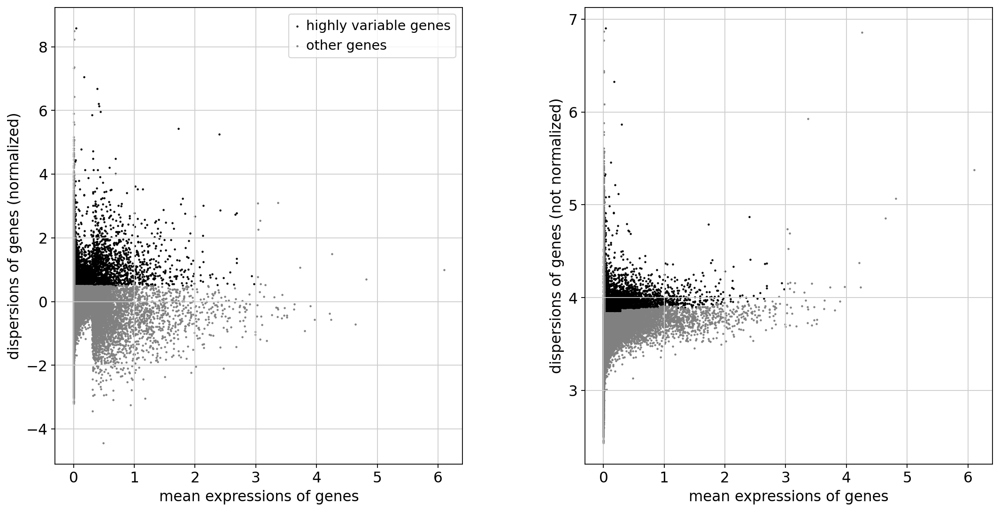

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:16:50)
computing PCA
    with n_comps=50
    finished (0:04:57)


2024-08-29 05:48:05,074 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 05:48:05,074 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 05:49:07,787 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 05:49:07,787 - INFO - sklearn.KMeans initialization complete.
2024-08-29 05:49:12,501 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 05:49:12,501 - INFO - Iteration 1 of 10
2024-08-29 05:54:17,371 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 05:54:17,371 - INFO - Iteration 2 of 10
2024-08-29 05:59:06,354 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 05:59:06,354 - INFO - Iteration 3 of 10
2024-08-29 06:01:53,843 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 06:01:53,843 - INFO - Iteration 4 of 10
2024-08-29 06:03:16,074 - harmonypy - INFO - Converged after 4 iterations
2024-08-29 06:03:16,074 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:47)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:10:46)
Error: HZ8M02-name 'cm' is not defined
Error: HZ8M02-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


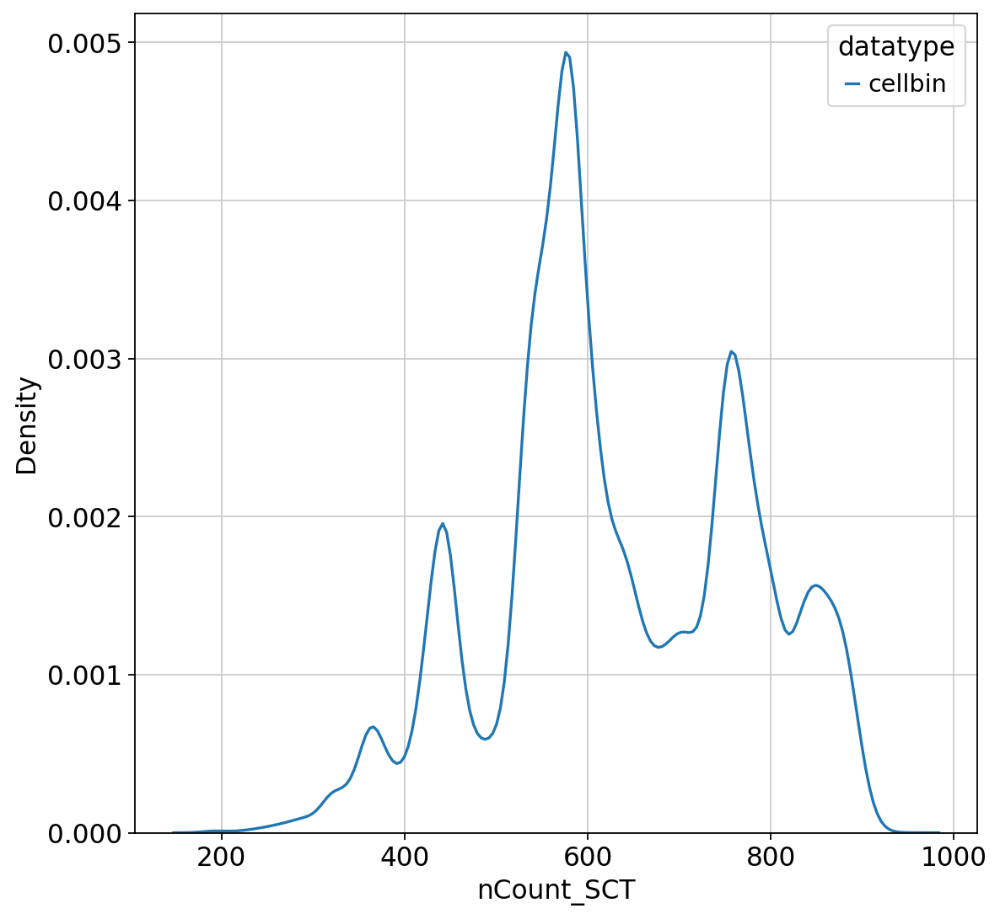

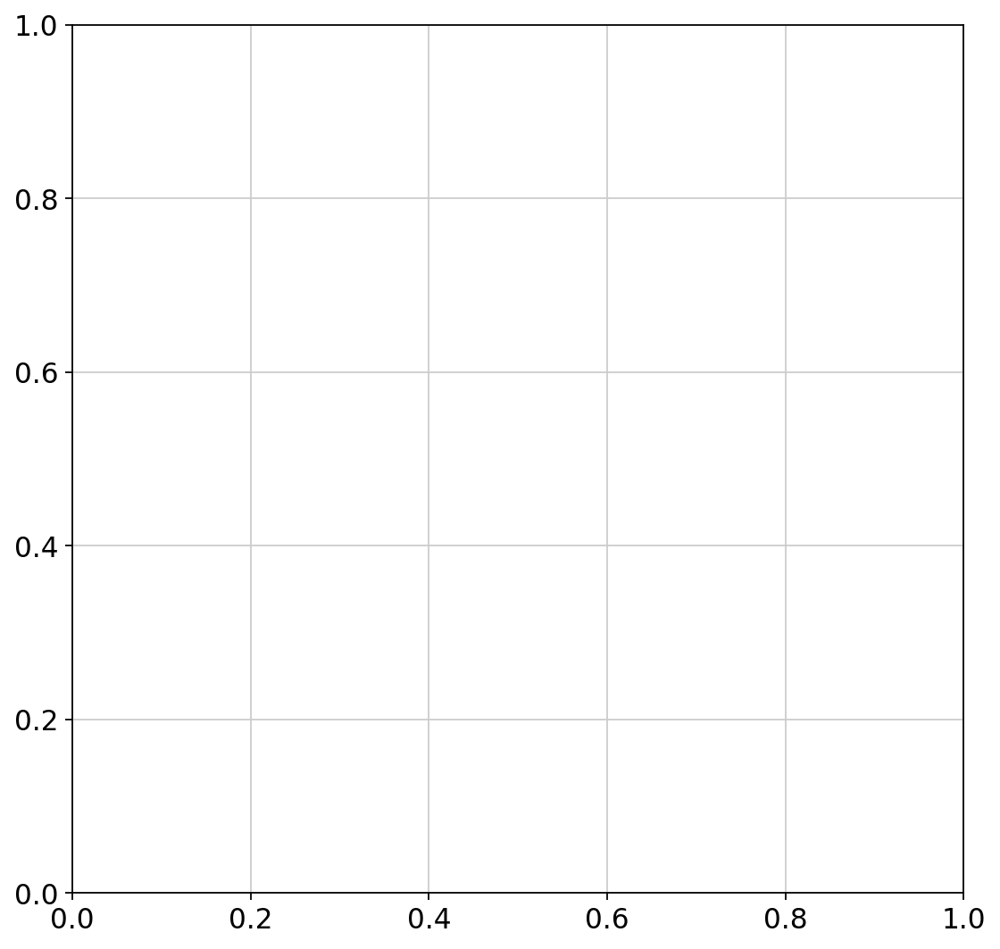

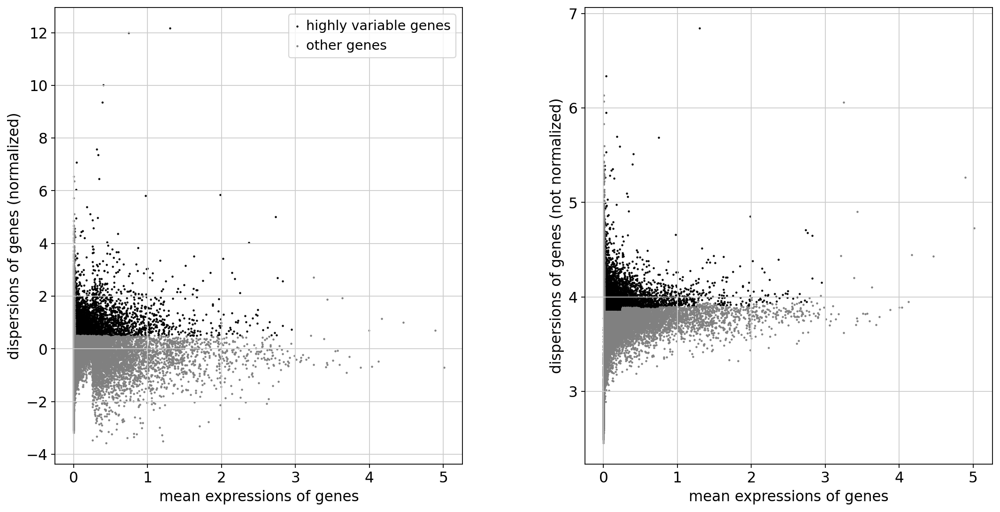

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:01:49)
computing PCA
    with n_comps=50
    finished (0:03:53)


2024-08-29 07:23:55,657 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 07:23:55,657 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 07:24:39,806 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 07:24:39,806 - INFO - sklearn.KMeans initialization complete.
2024-08-29 07:24:42,137 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 07:24:42,137 - INFO - Iteration 1 of 10
2024-08-29 07:27:49,975 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 07:27:49,975 - INFO - Iteration 2 of 10
2024-08-29 07:31:04,195 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 07:31:04,195 - INFO - Iteration 3 of 10
2024-08-29 07:34:03,903 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 07:34:03,903 - INFO - Iteration 4 of 10
2024-08-29 07:36:37,435 - harmonypy - INFO - Iteration 5 of 10
2024-08-29 07:36:37,435 - INFO - Iteration 5 of 10
2024-08-29 07:37:29,143 - harmonypy - INFO - Converged after 5 iterations
2024-08-29 07:37:2

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:42)
Error: HZ8M03-name 'cm' is not defined
Error: HZ8M03-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


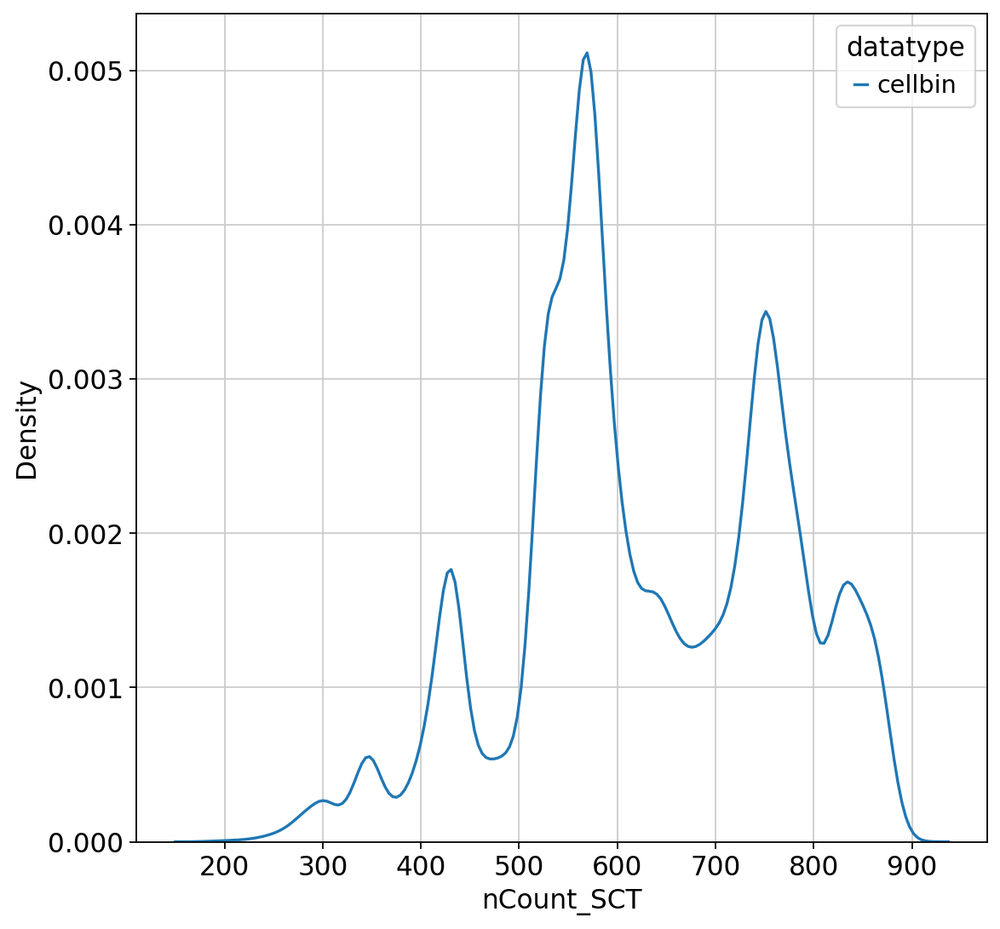

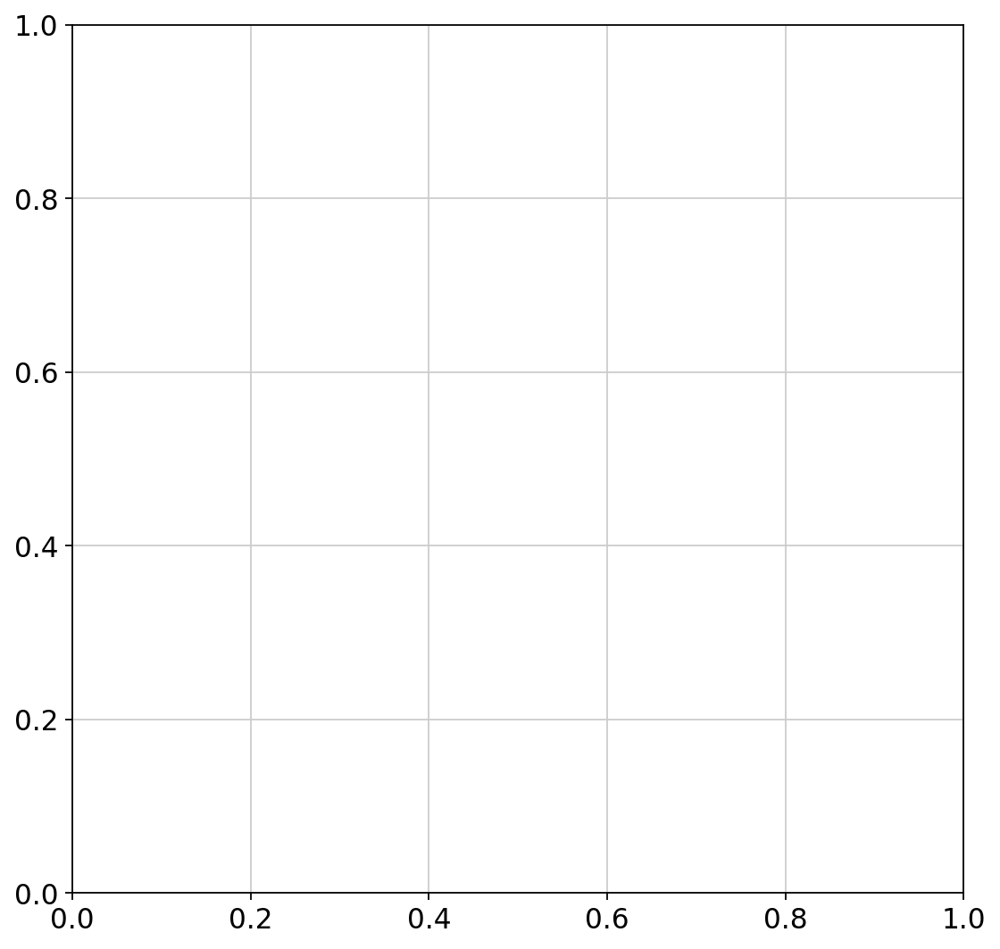

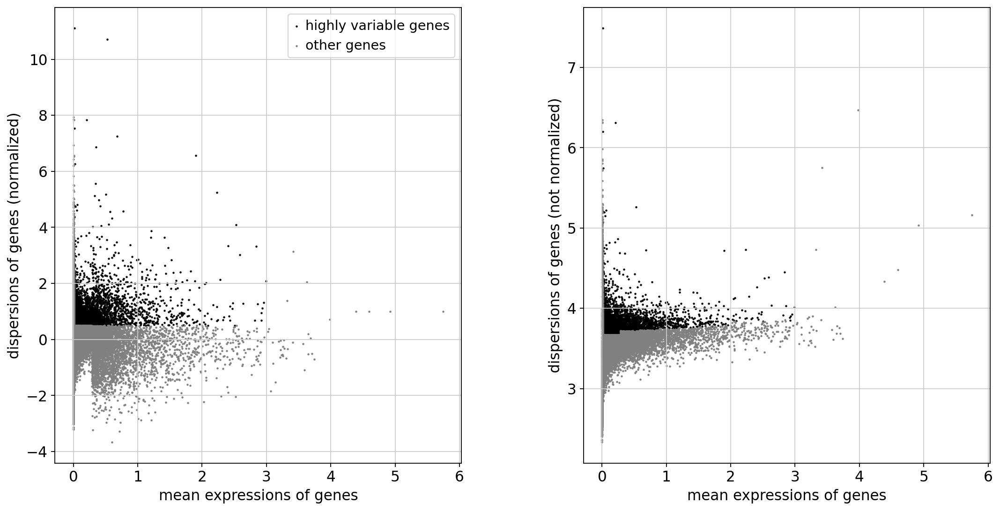

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:06:16)
computing PCA
    with n_comps=50
    finished (0:04:23)


2024-08-29 08:58:17,467 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 08:58:17,467 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 08:59:11,779 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 08:59:11,779 - INFO - sklearn.KMeans initialization complete.
2024-08-29 08:59:13,948 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 08:59:13,948 - INFO - Iteration 1 of 10
2024-08-29 09:03:13,090 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 09:03:13,090 - INFO - Iteration 2 of 10
2024-08-29 09:06:42,801 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 09:06:42,801 - INFO - Iteration 3 of 10
2024-08-29 09:09:24,517 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 09:09:24,517 - INFO - Iteration 4 of 10
2024-08-29 09:10:27,044 - harmonypy - INFO - Converged after 4 iterations
2024-08-29 09:10:27,044 - INFO - Converged after 4 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:38)
Error: HZ8M04-name 'cm' is not defined
Error: HZ8M04-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


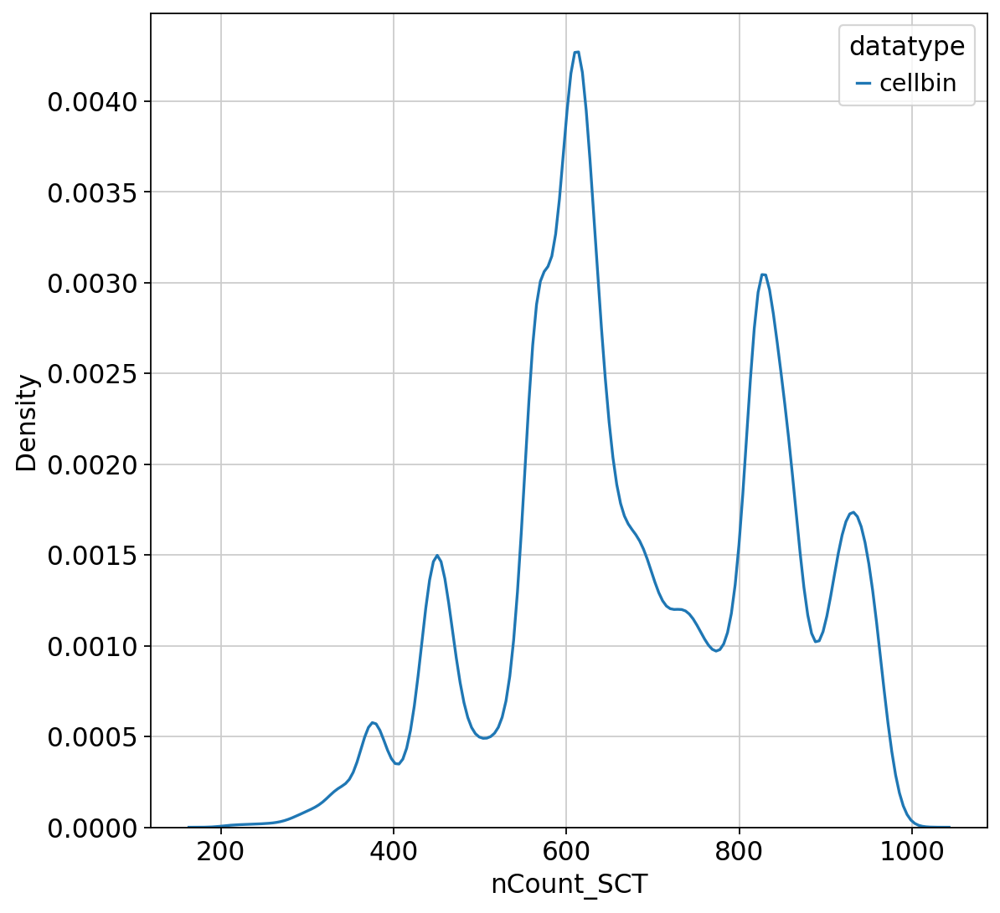

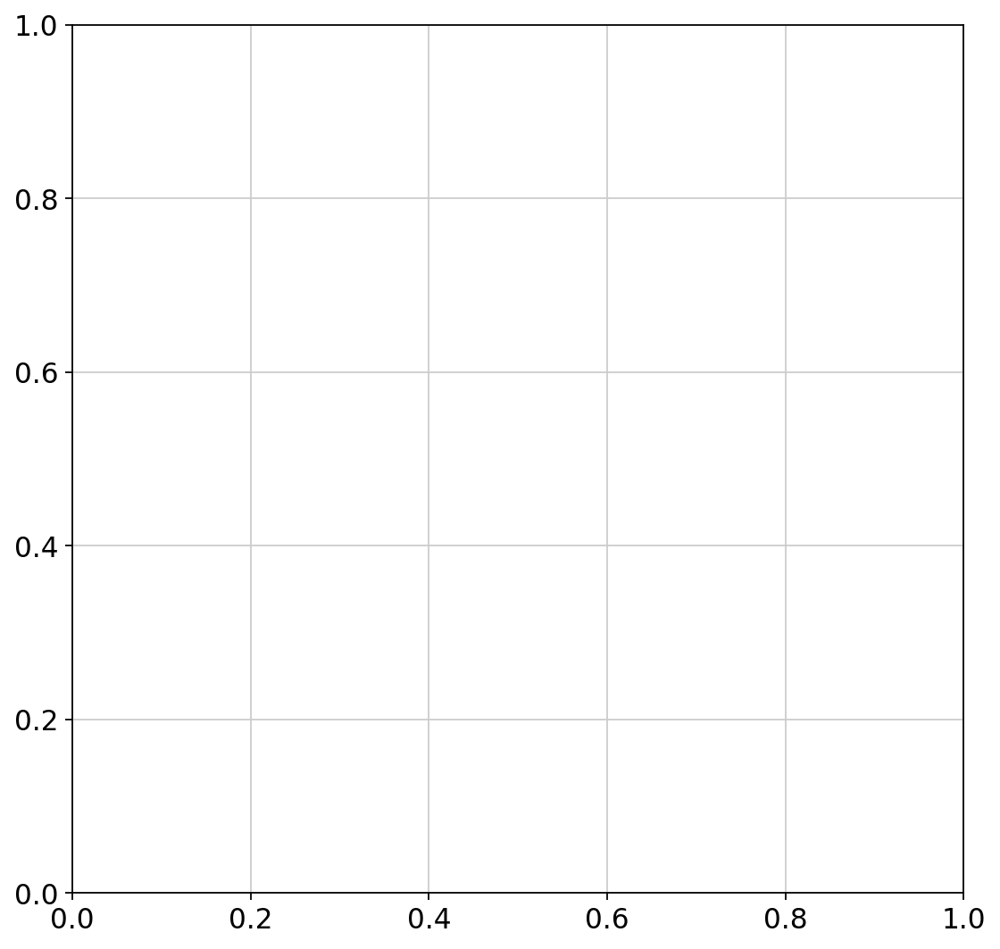

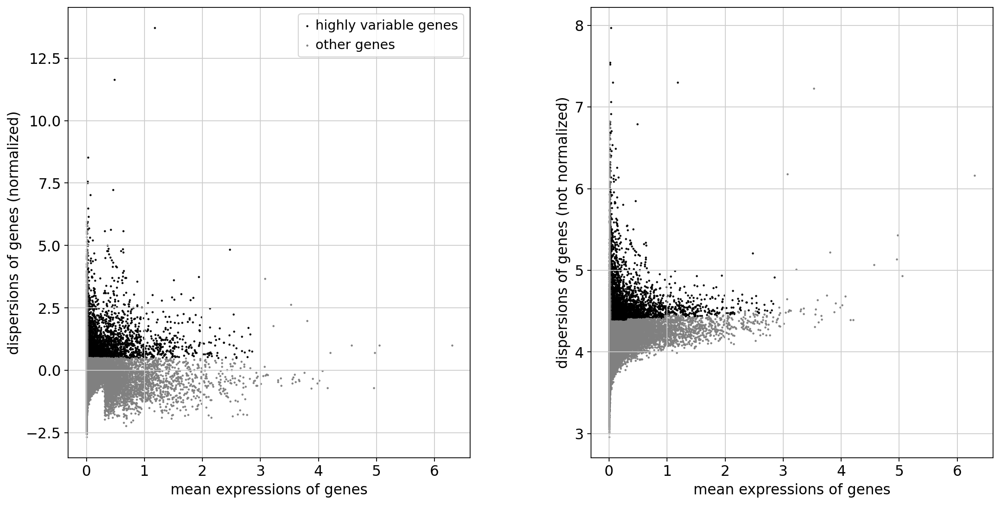

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (0:52:55)
computing PCA
    with n_comps=50
    finished (0:04:14)


2024-08-29 10:18:34,020 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 10:18:34,020 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 10:19:28,138 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 10:19:28,138 - INFO - sklearn.KMeans initialization complete.
2024-08-29 10:19:31,669 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 10:19:31,669 - INFO - Iteration 1 of 10
2024-08-29 10:23:18,383 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 10:23:18,383 - INFO - Iteration 2 of 10
2024-08-29 10:27:04,931 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 10:27:04,931 - INFO - Iteration 3 of 10
2024-08-29 10:30:53,828 - harmonypy - INFO - Iteration 4 of 10
2024-08-29 10:30:53,828 - INFO - Iteration 4 of 10
2024-08-29 10:33:31,902 - harmonypy - INFO - Iteration 5 of 10
2024-08-29 10:33:31,902 - INFO - Iteration 5 of 10
2024-08-29 10:34:41,981 - harmonypy - INFO - Converged after 5 iterations
2024-08-29 10:34:4

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:03)
Error: HZ8M05-name 'cm' is not defined
Error: HZ8M05-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing HZ8M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


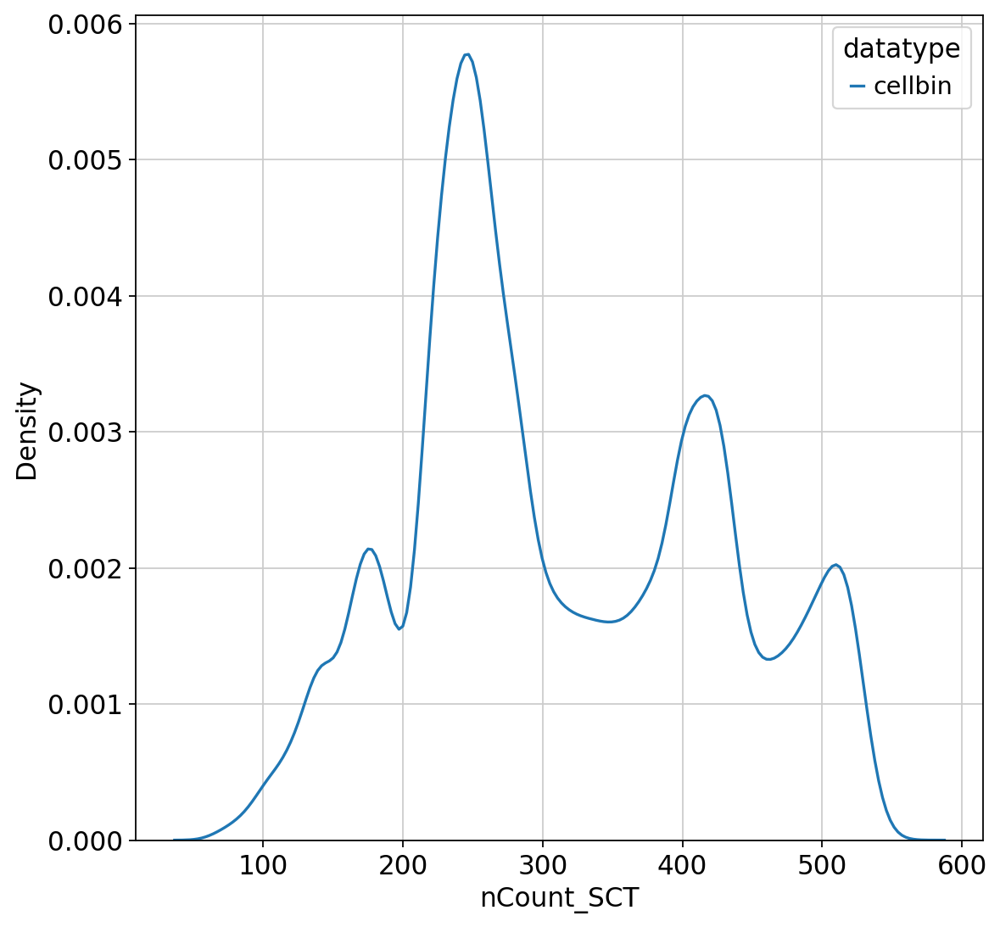

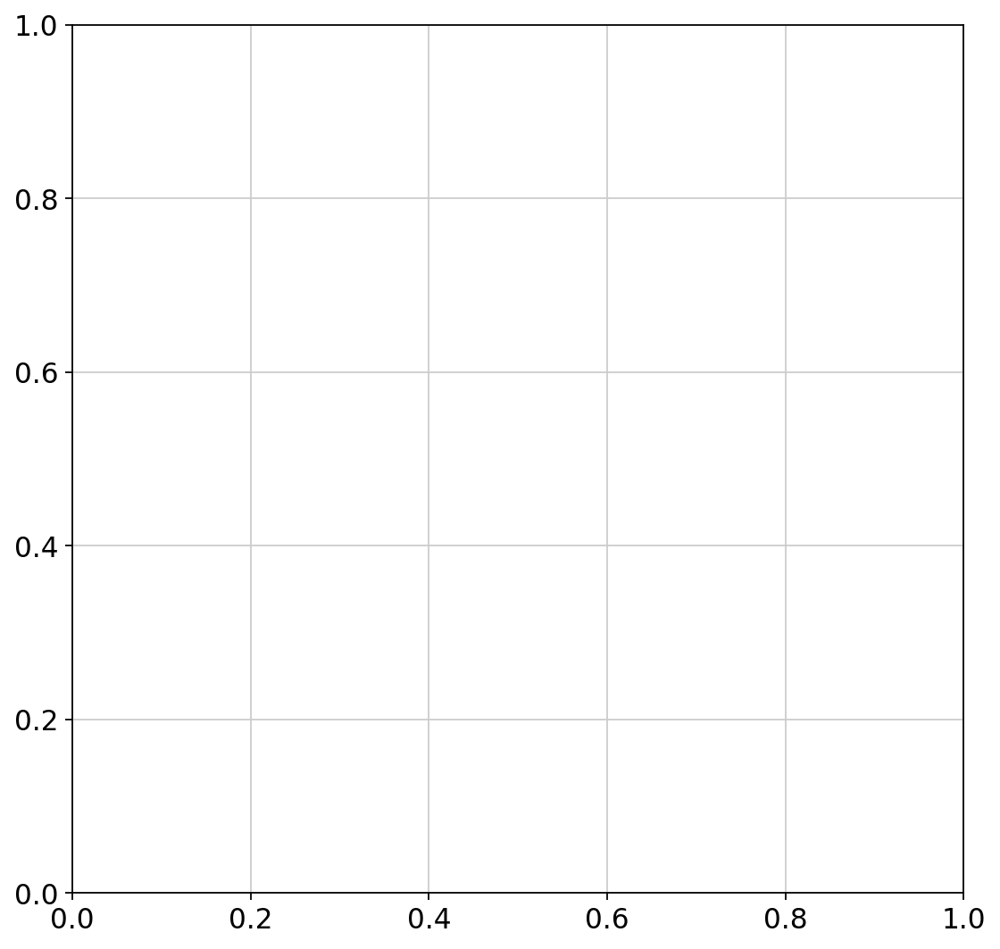

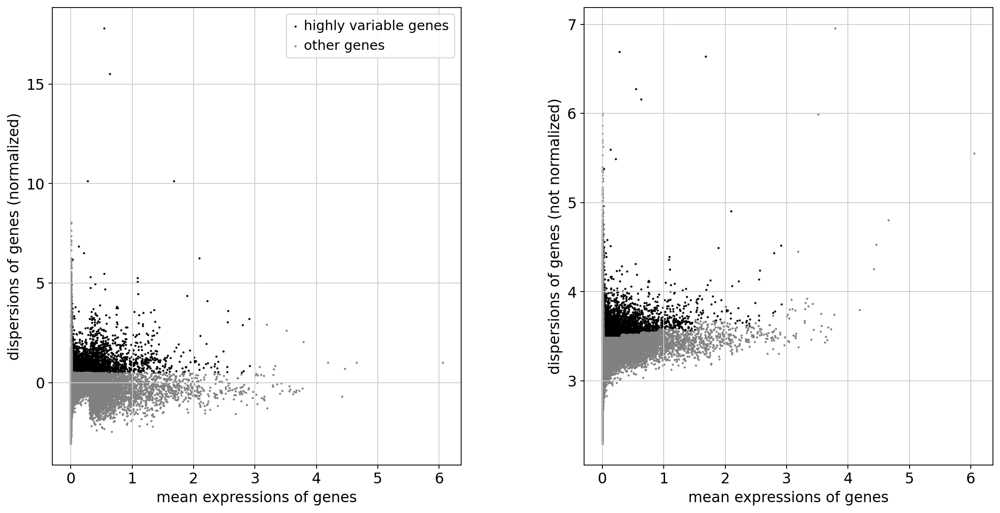

regressing out ['nCount_SCT']


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'celltype' as categorical
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
... storing 'datatype' as categorical


    sparse input is densified and may lead to high memory use
    finished (1:05:38)
computing PCA
    with n_comps=50
    finished (0:03:38)


2024-08-29 11:55:39,424 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 11:55:39,424 - INFO - Computing initial centroids with sklearn.KMeans...
2024-08-29 11:56:44,041 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-29 11:56:44,041 - INFO - sklearn.KMeans initialization complete.
2024-08-29 11:56:49,035 - harmonypy - INFO - Iteration 1 of 10
2024-08-29 11:56:49,035 - INFO - Iteration 1 of 10
2024-08-29 12:01:55,444 - harmonypy - INFO - Iteration 2 of 10
2024-08-29 12:01:55,444 - INFO - Iteration 2 of 10
2024-08-29 12:05:35,410 - harmonypy - INFO - Iteration 3 of 10
2024-08-29 12:05:35,410 - INFO - Iteration 3 of 10
2024-08-29 12:06:53,817 - harmonypy - INFO - Converged after 3 iterations
2024-08-29 12:06:53,817 - INFO - Converged after 3 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:33)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:09:22)
Error: HZ8M06-name 'cm' is not defined
Error: HZ8M06-name 'cell_type' is not defined


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Processing WT12M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


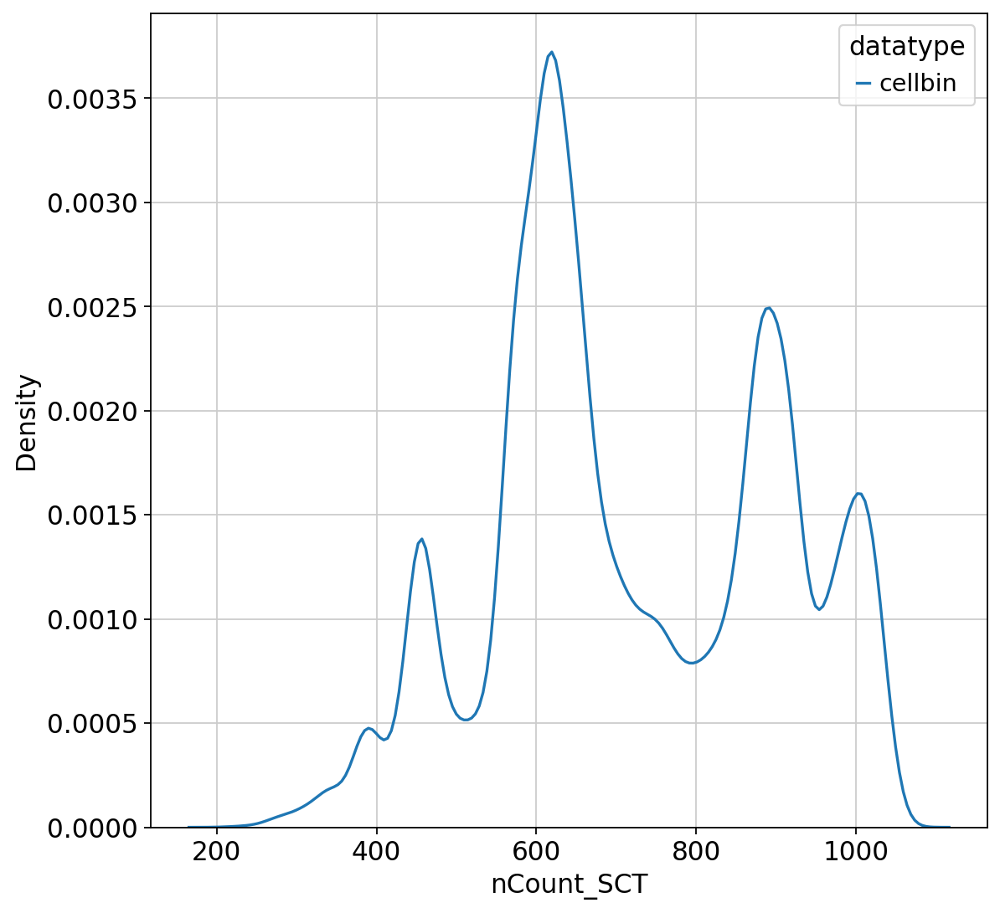

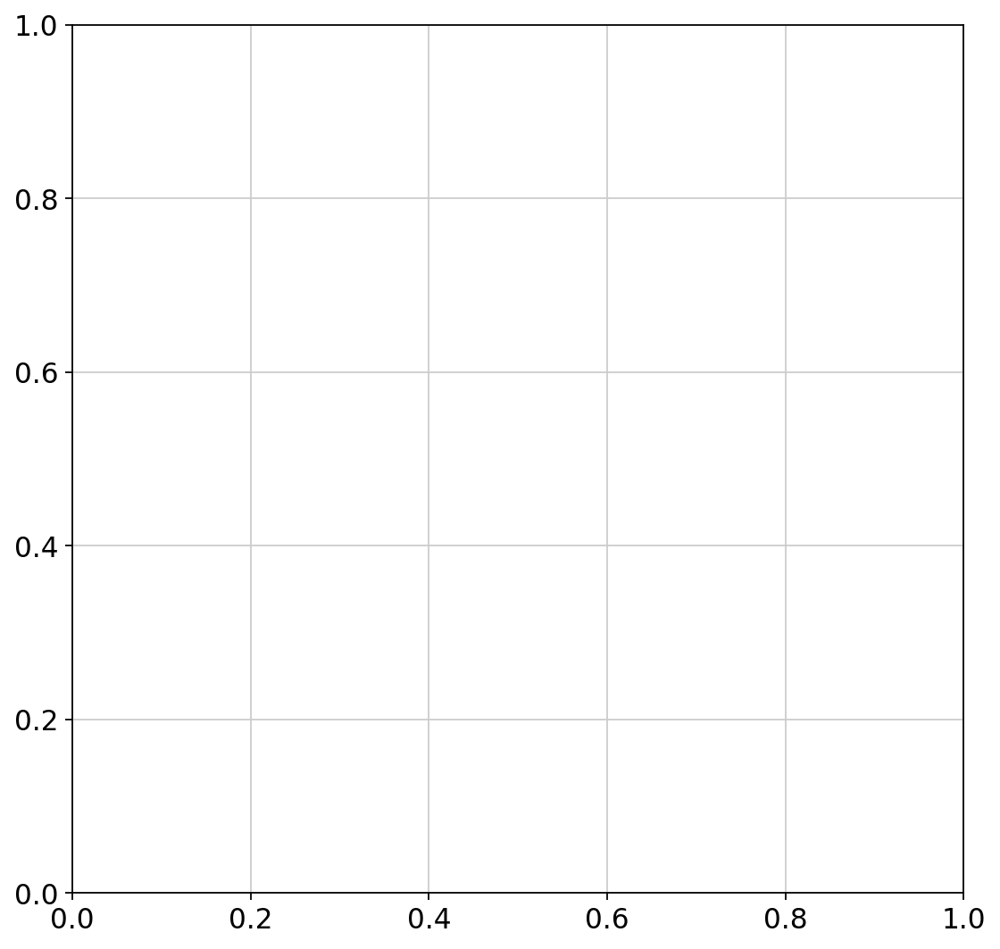

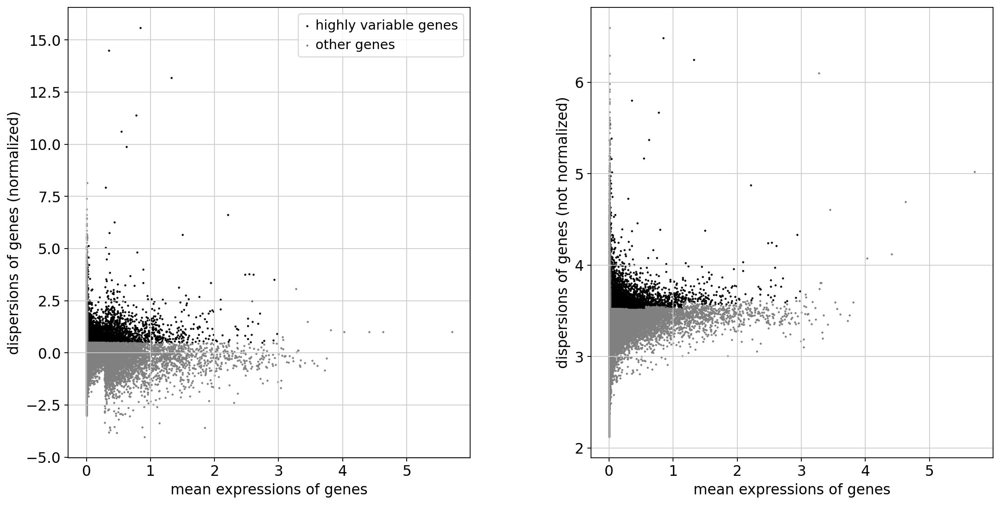

WT12M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT12M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


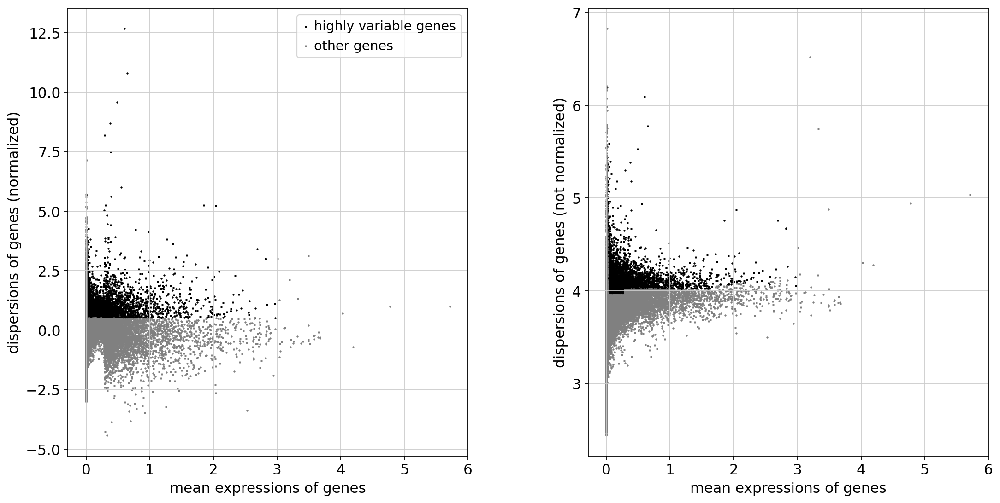

WT12M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT12M03 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


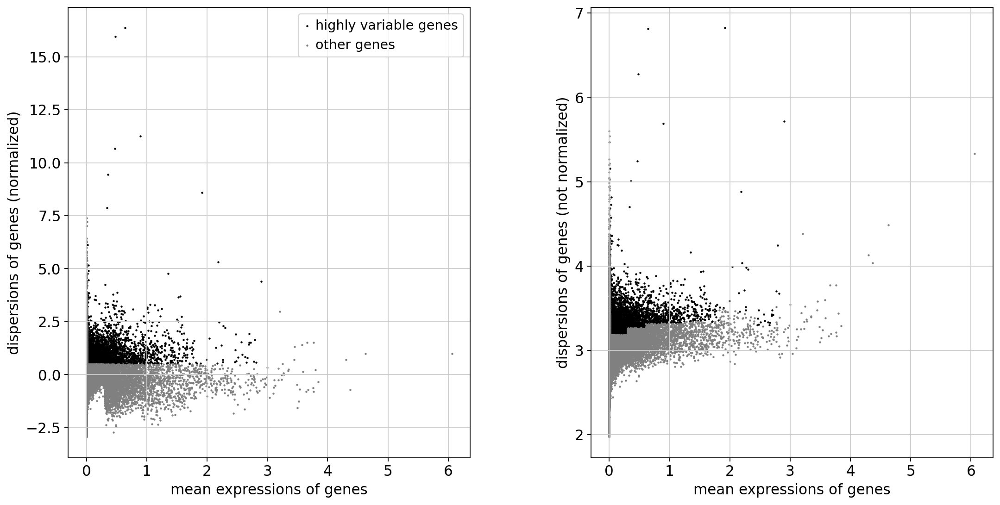

WT12M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT12M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


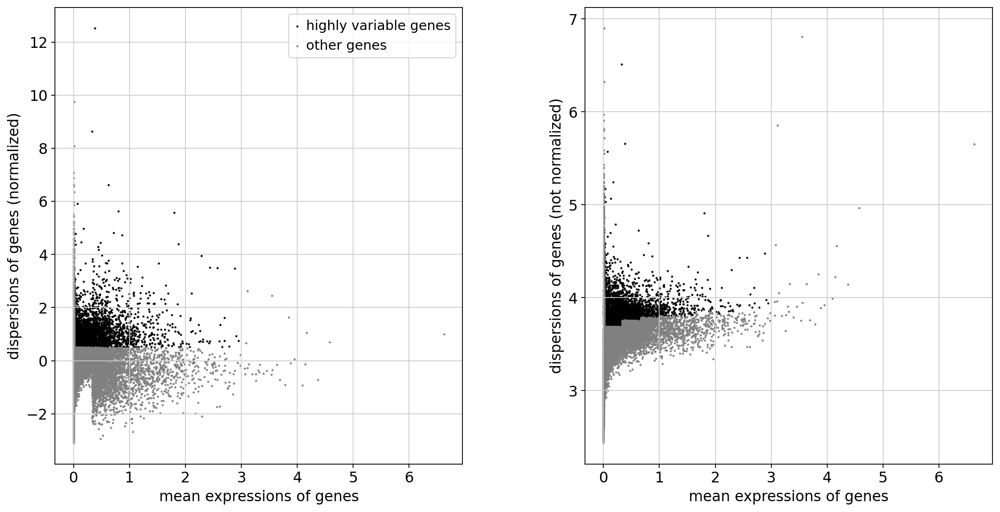

WT12M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT12M05 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


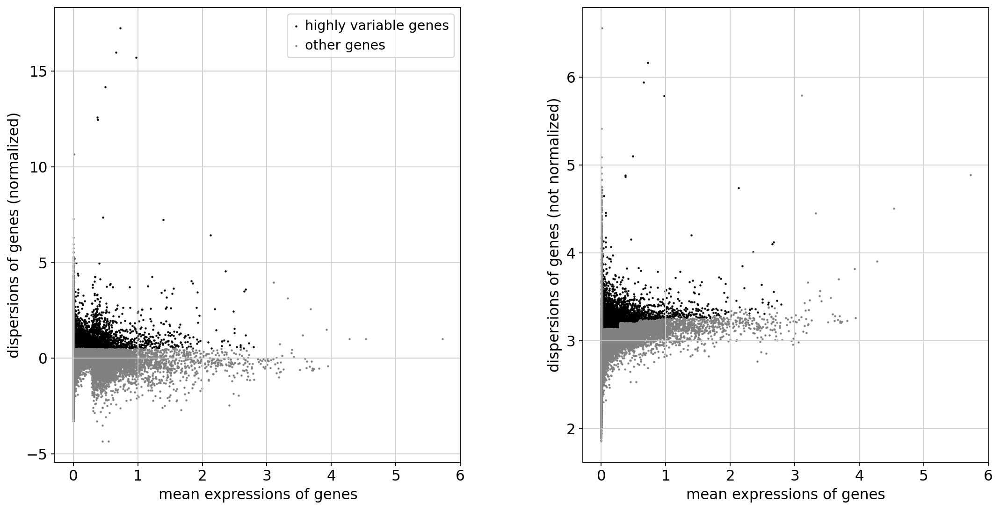

WT12M05: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT12M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


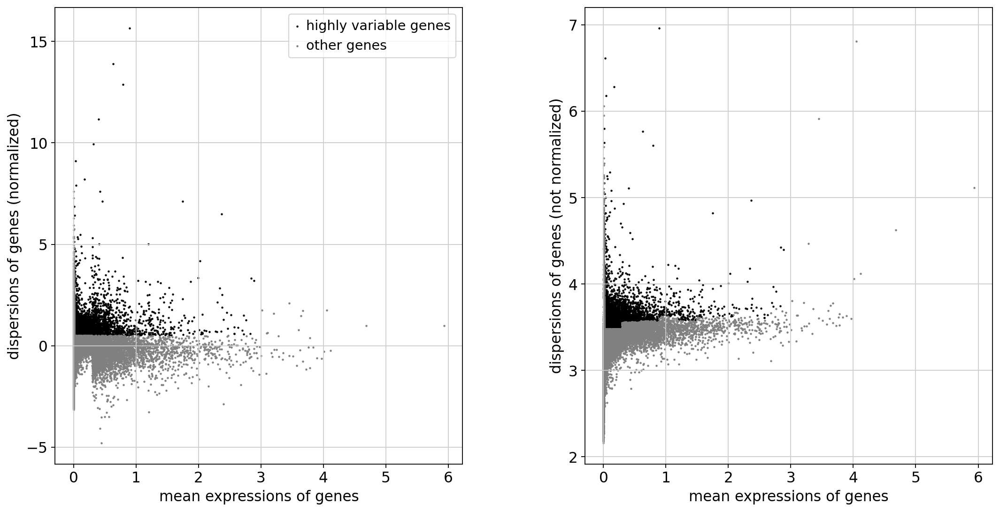

WT12M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


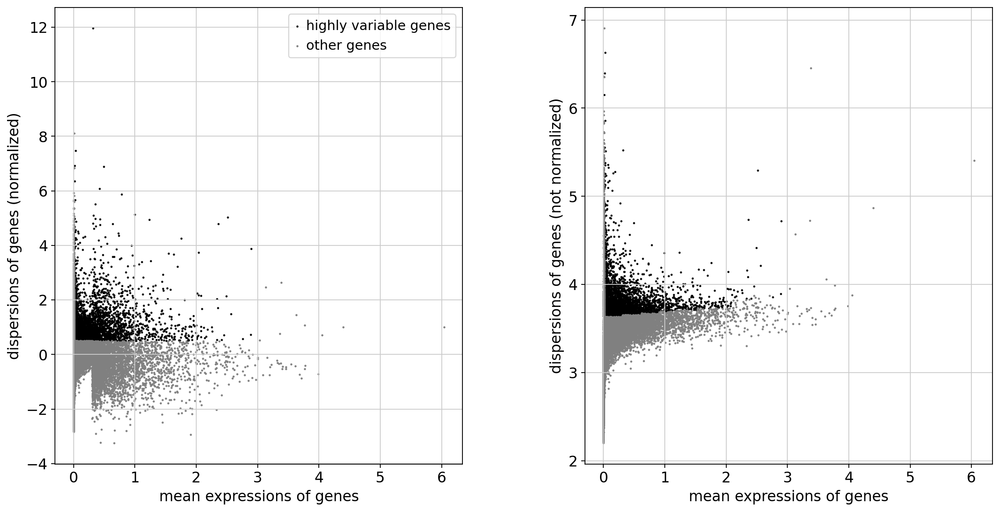

WT2M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


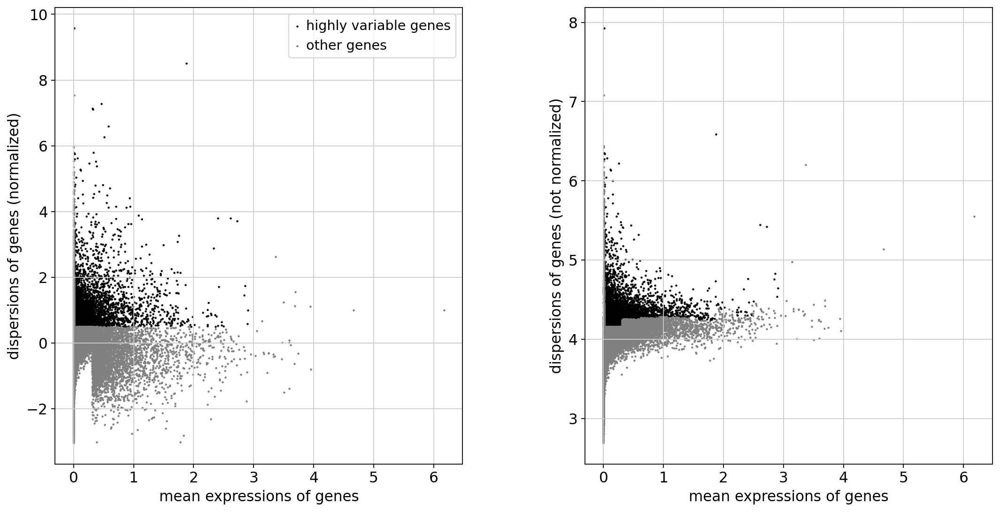

WT2M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M03 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


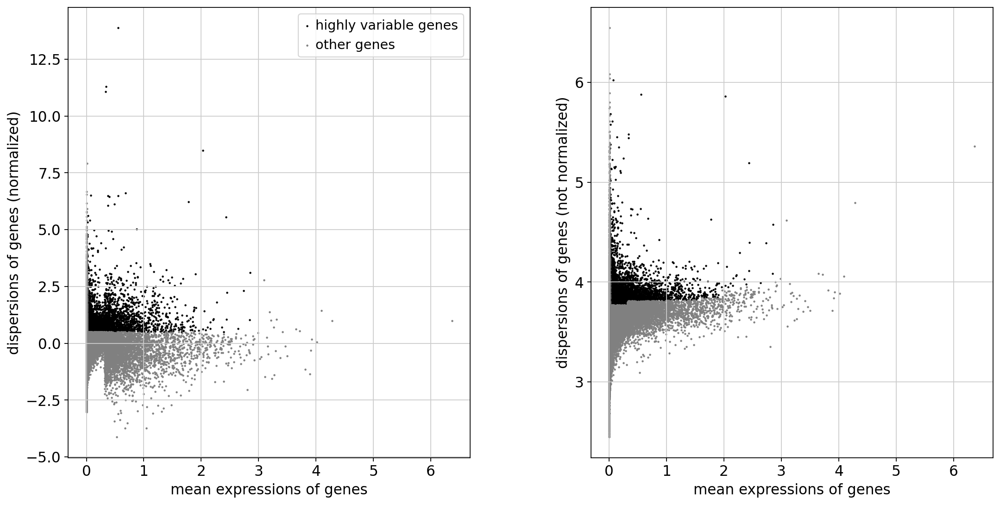

WT2M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


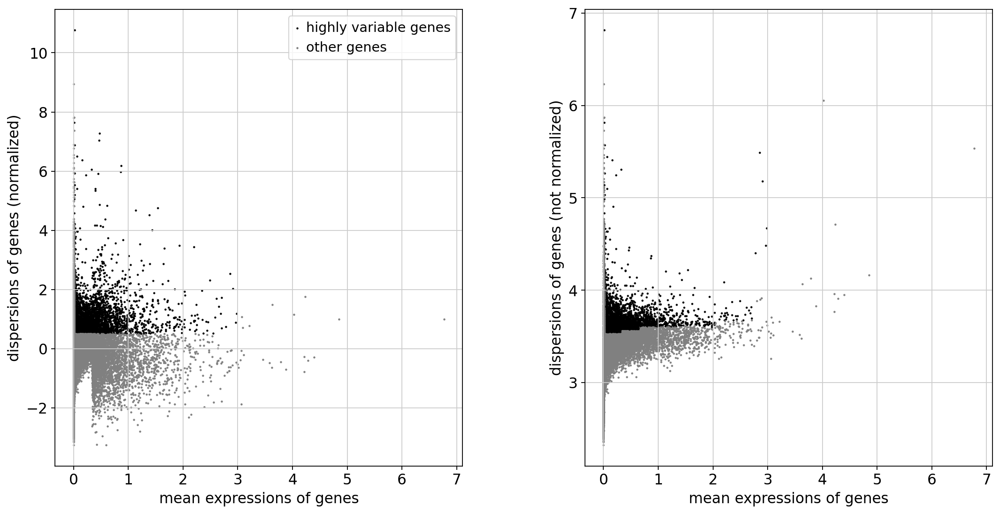

WT2M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M05 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


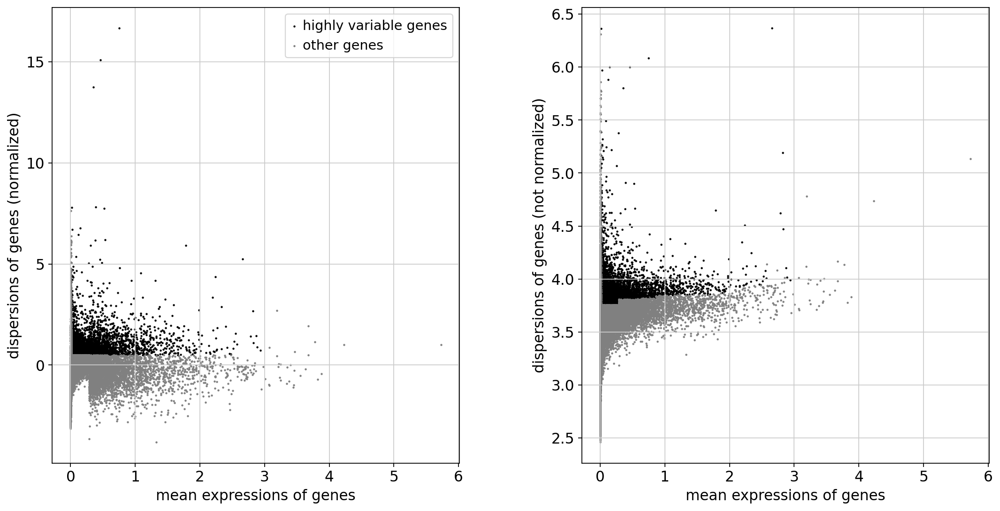

WT2M05: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT2M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:03)
extracting highly variable genes
    finished (0:00:07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


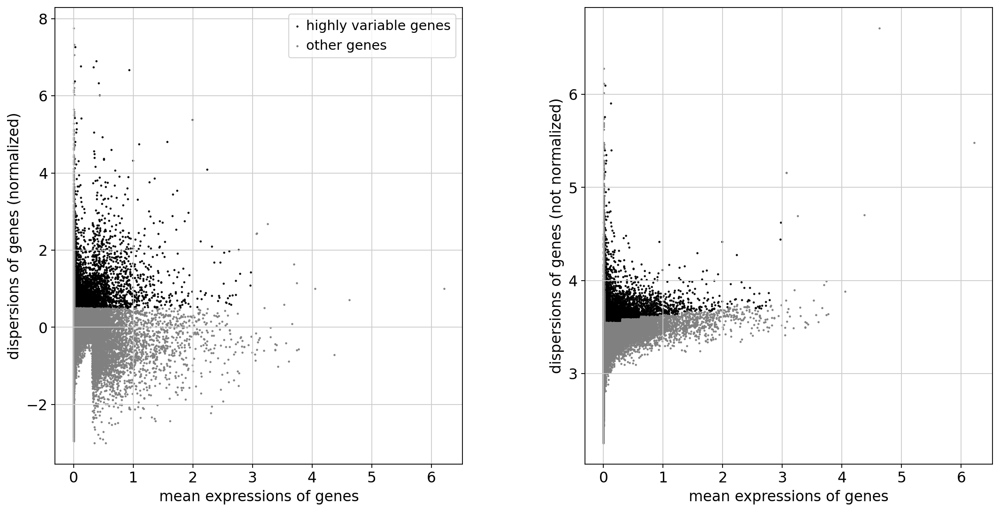

WT2M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M01 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


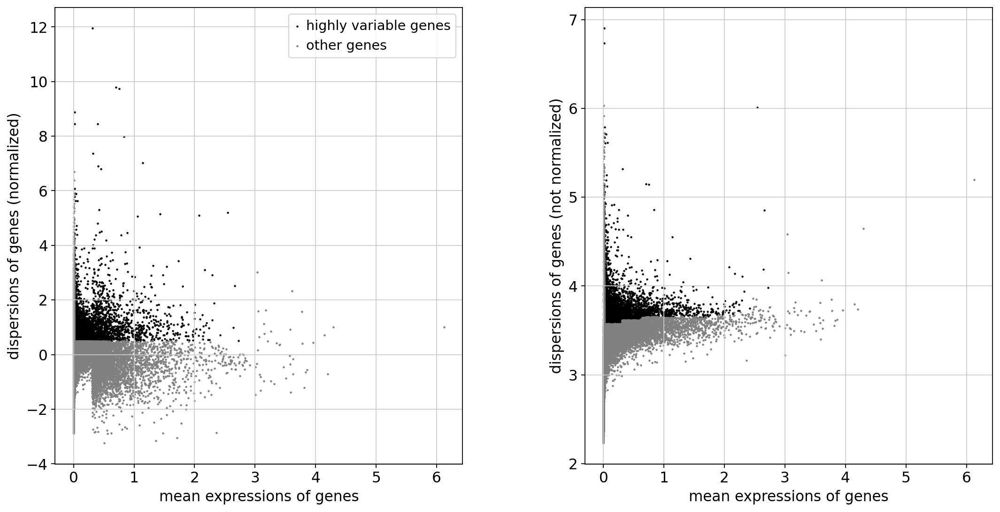

WT3M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


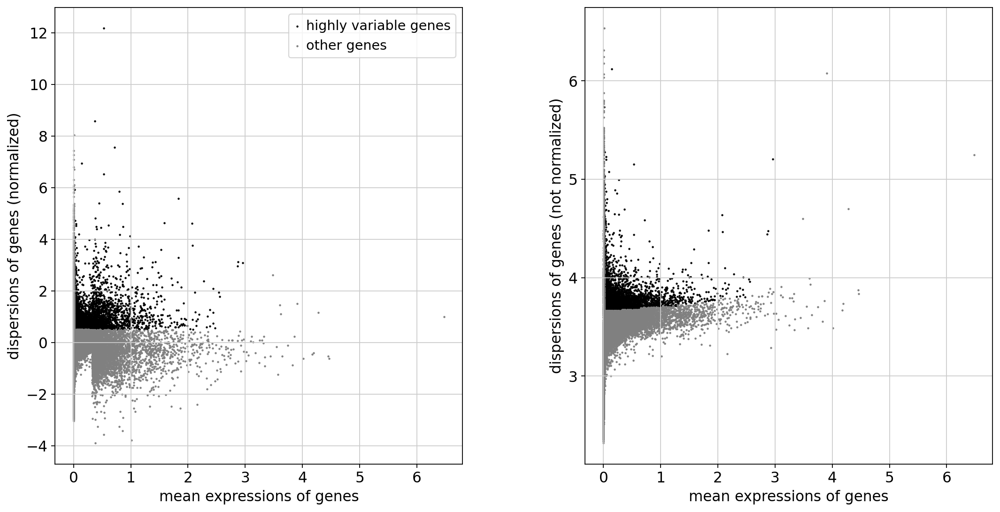

WT3M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


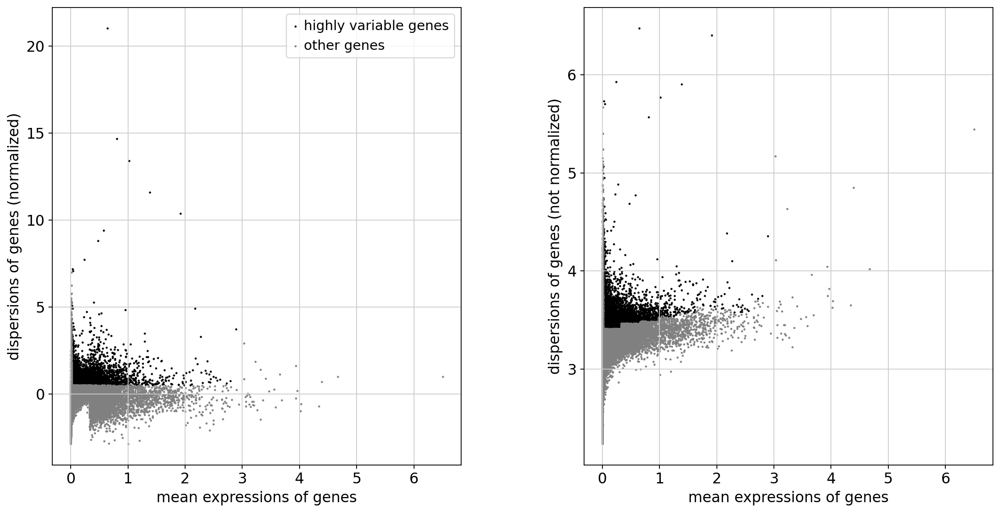

WT3M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


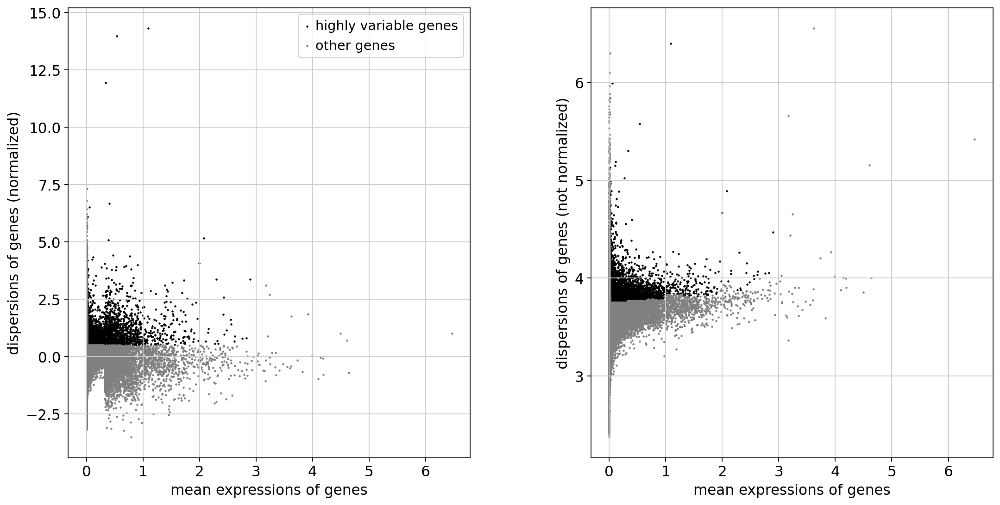

WT3M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


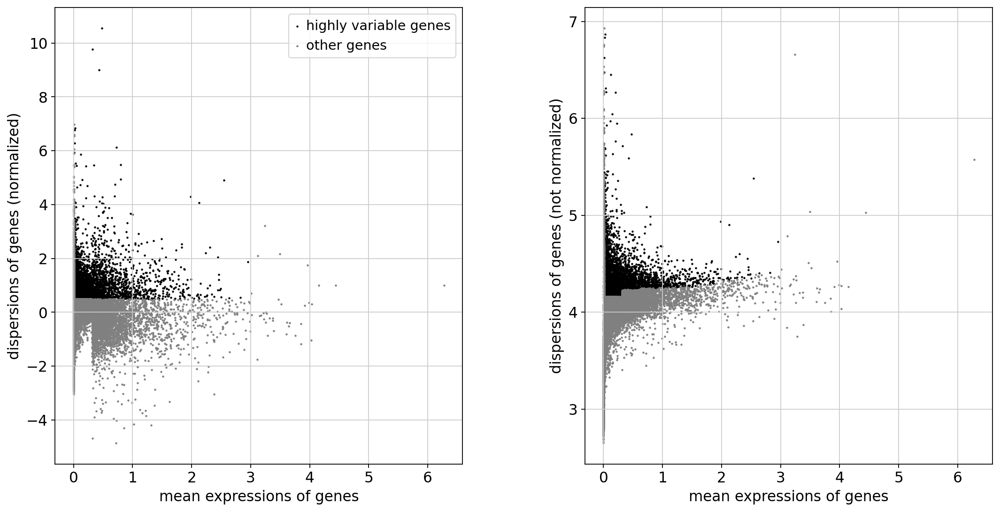

WT3M05: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT3M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


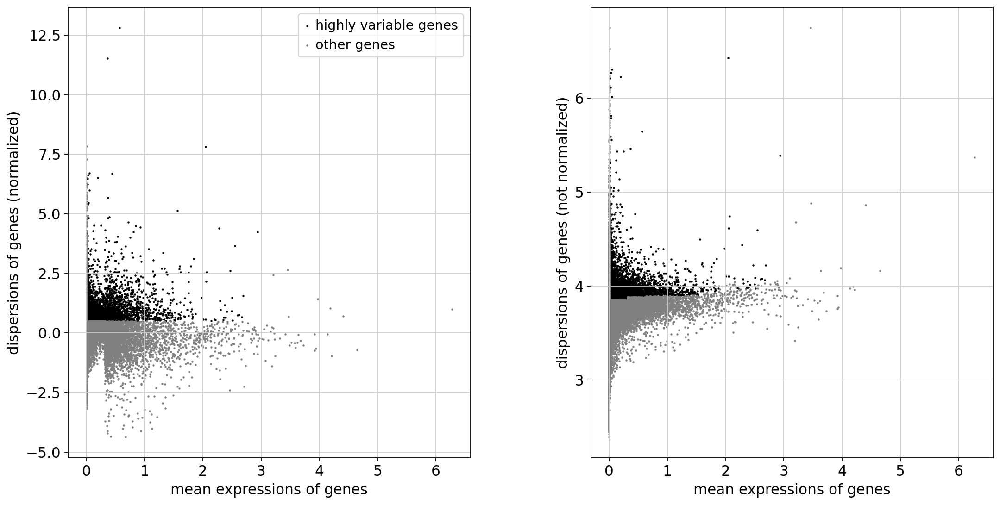

WT3M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT4M01 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


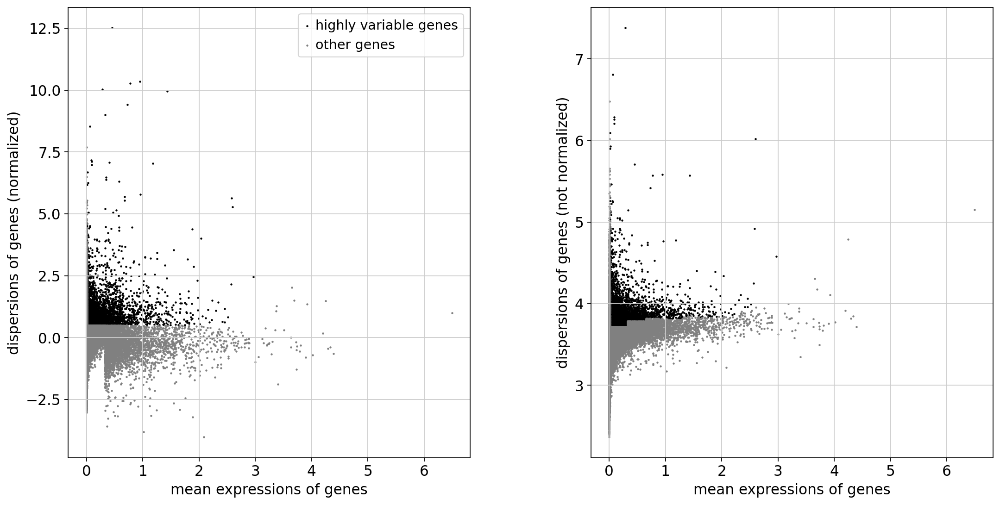

WT4M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT4M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


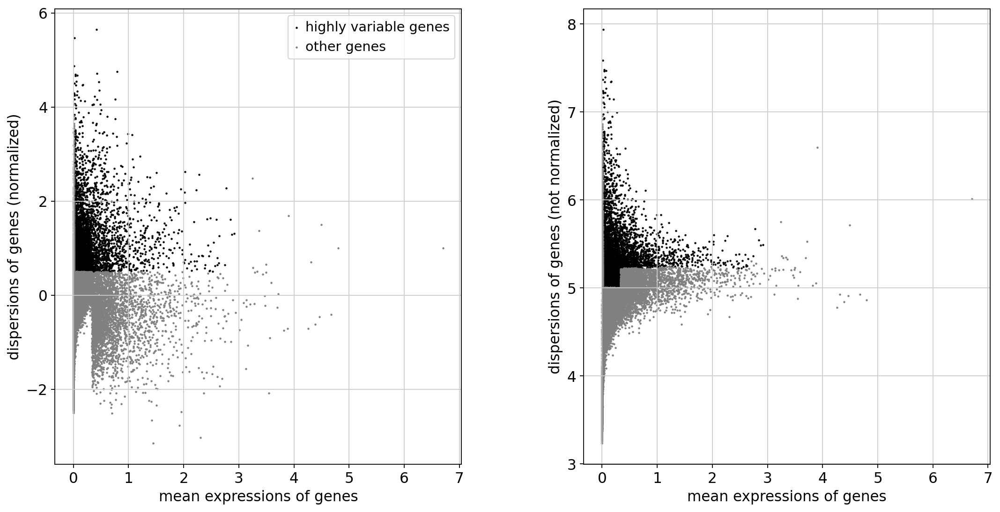

WT4M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT4M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


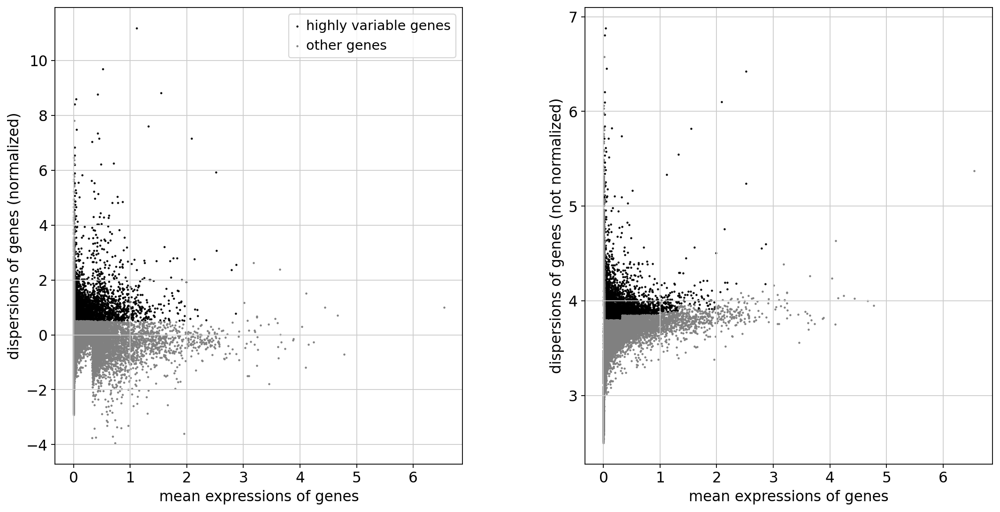

WT4M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT4M04 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


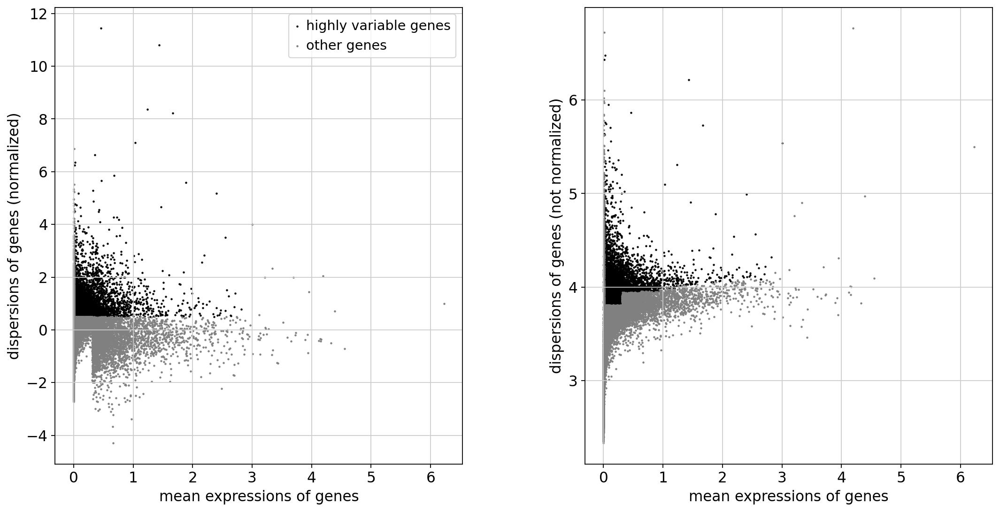

WT4M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT4M06 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


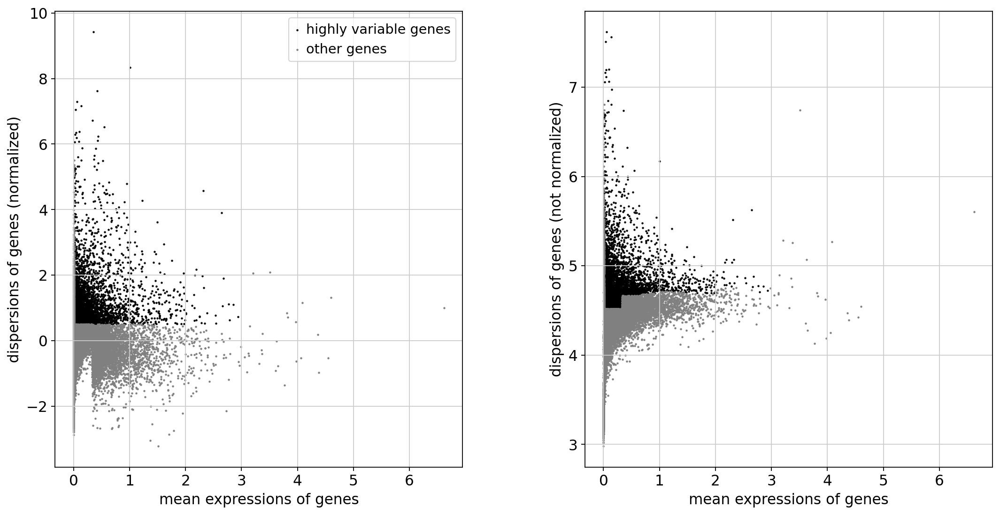

WT4M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:03)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


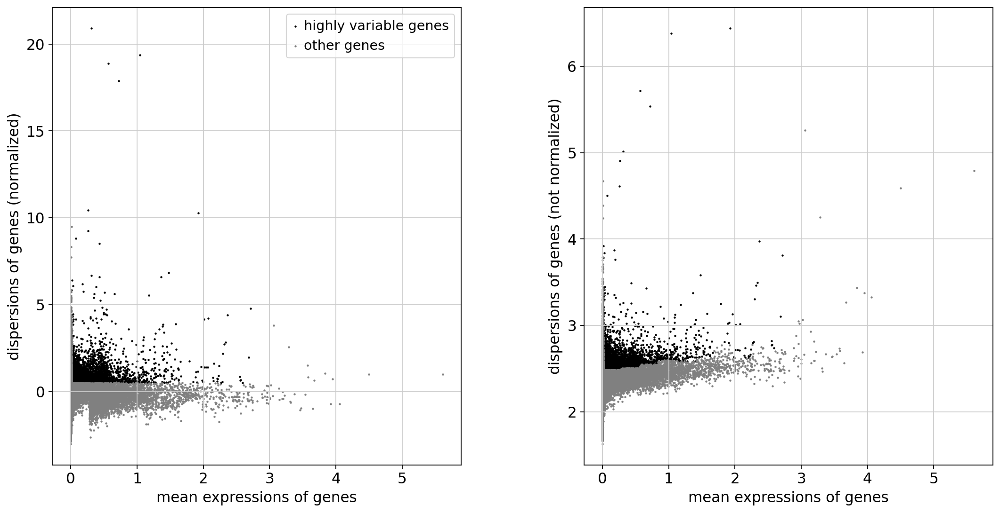

WT5M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


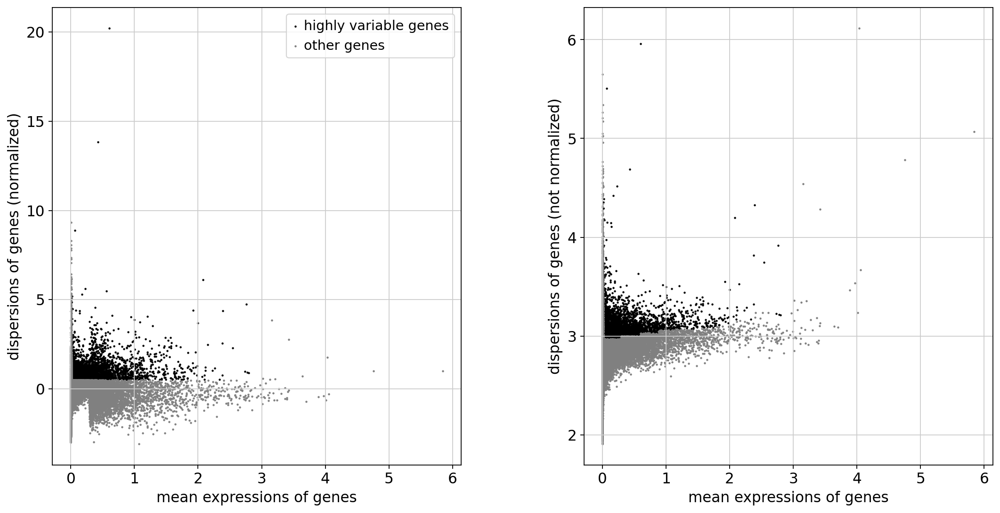

WT5M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M03 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


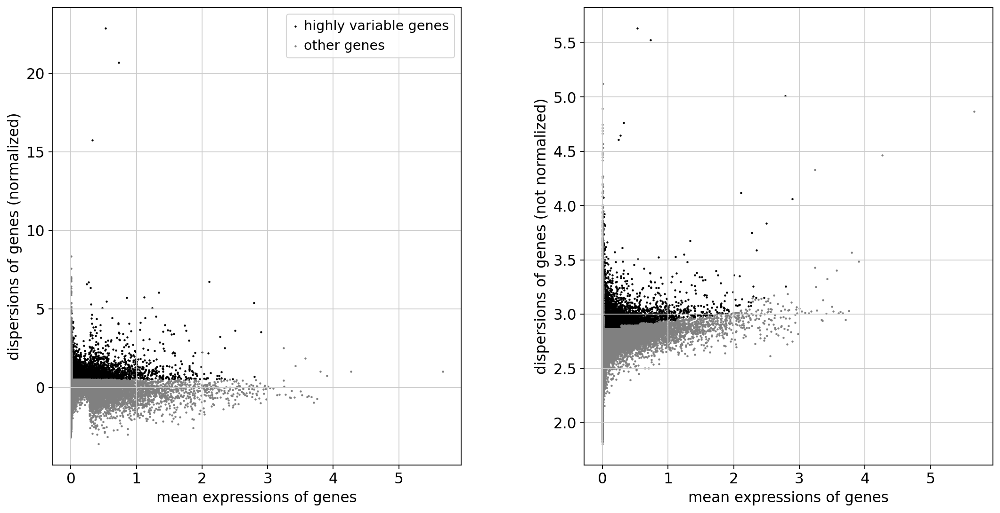

WT5M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M04 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


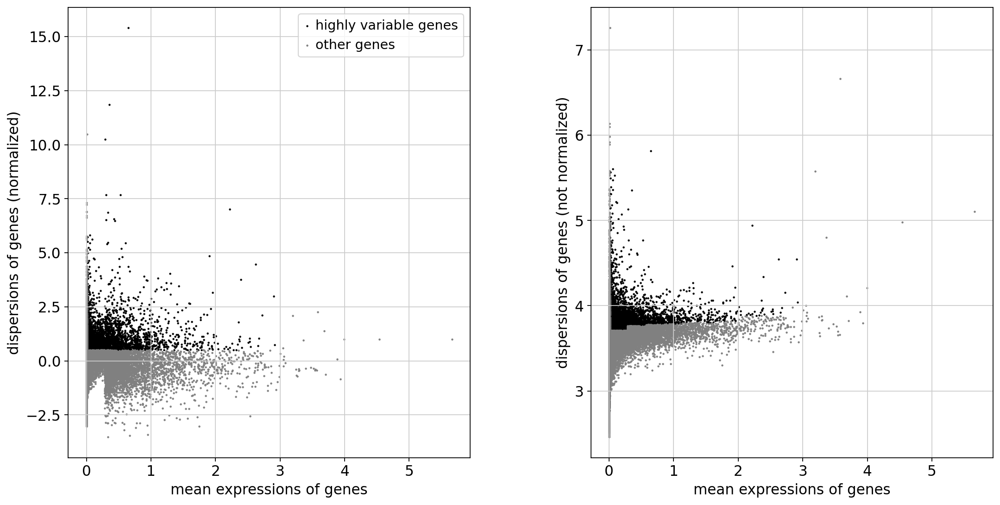

WT5M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M05 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


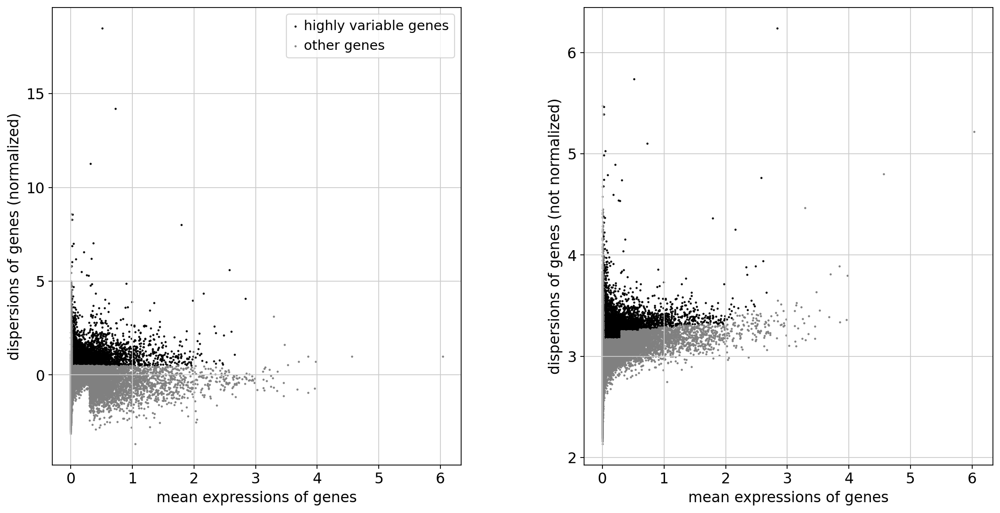

WT5M05: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT5M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


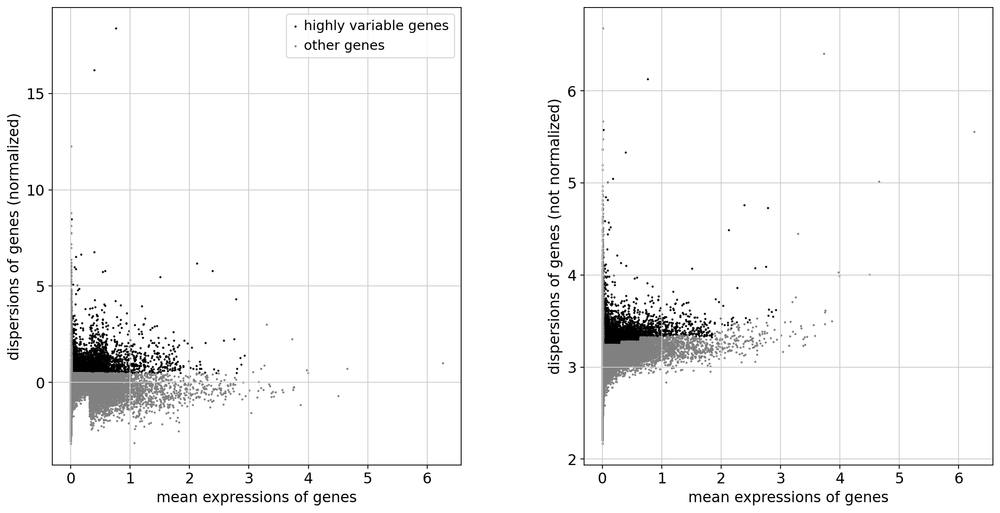

WT5M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


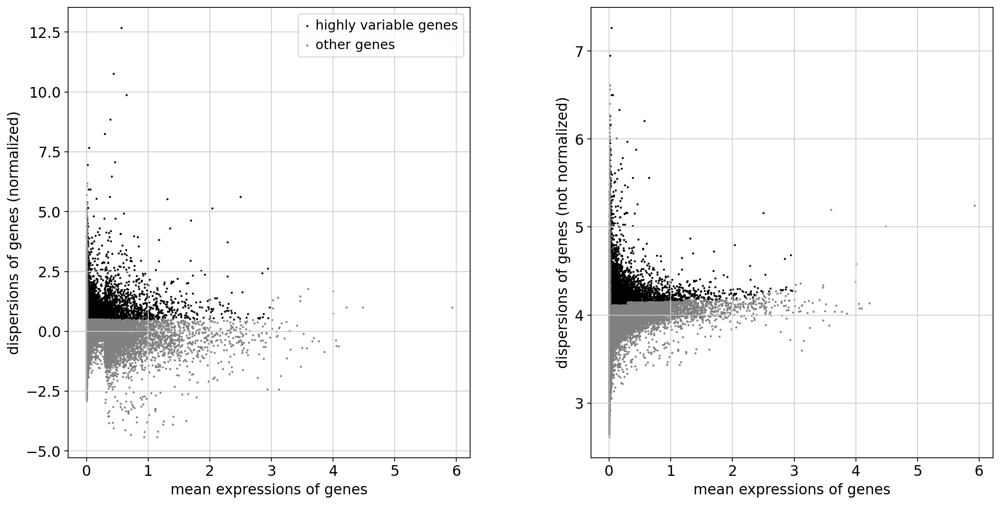

WT6M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6M02 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


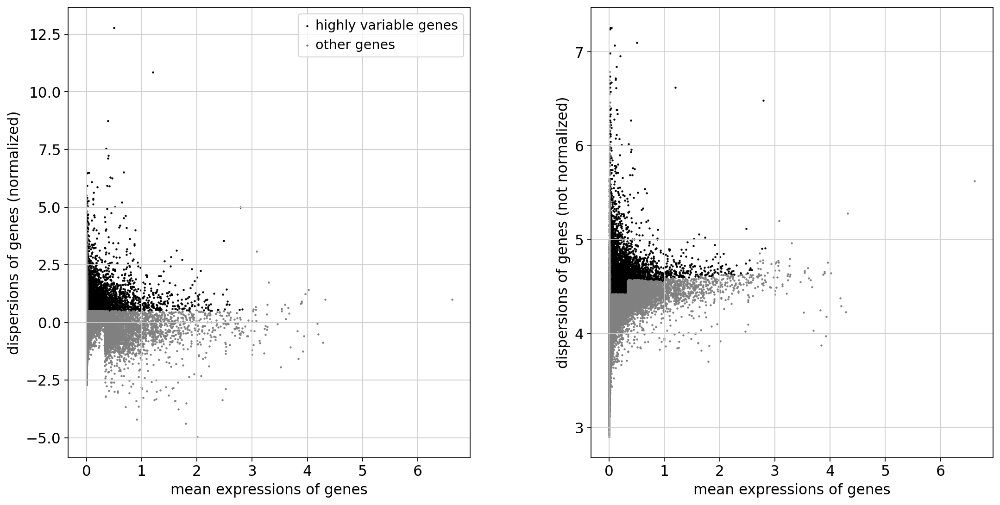

WT6M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


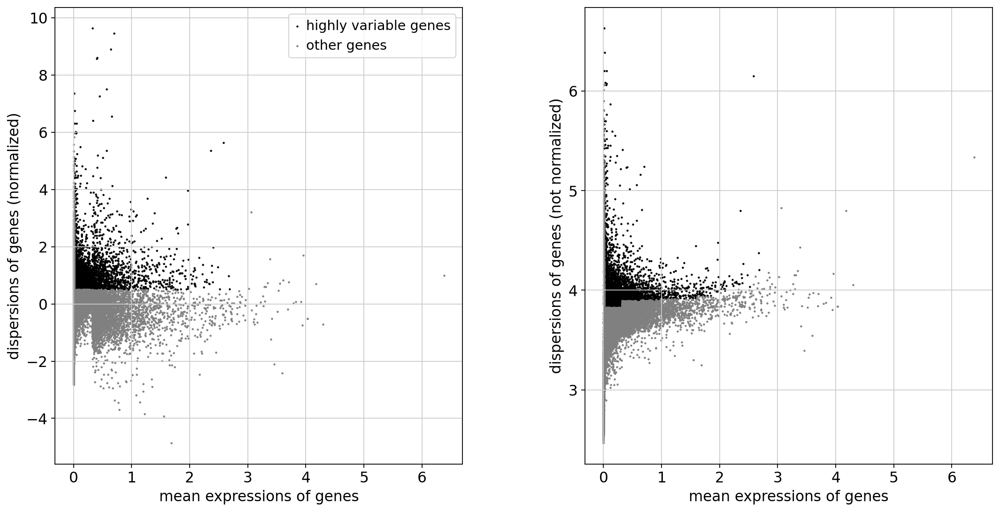

WT6M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6M04 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


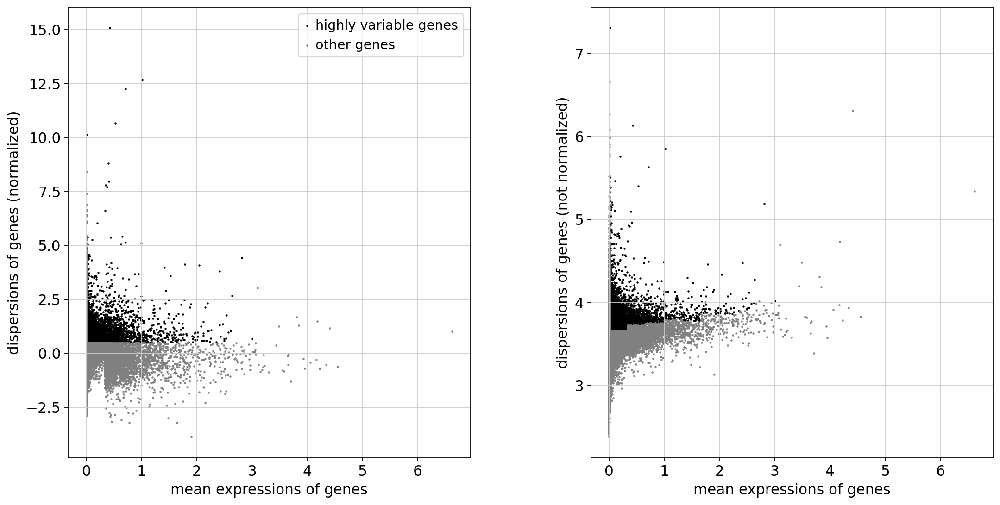

WT6M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6MP302 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:04)
extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


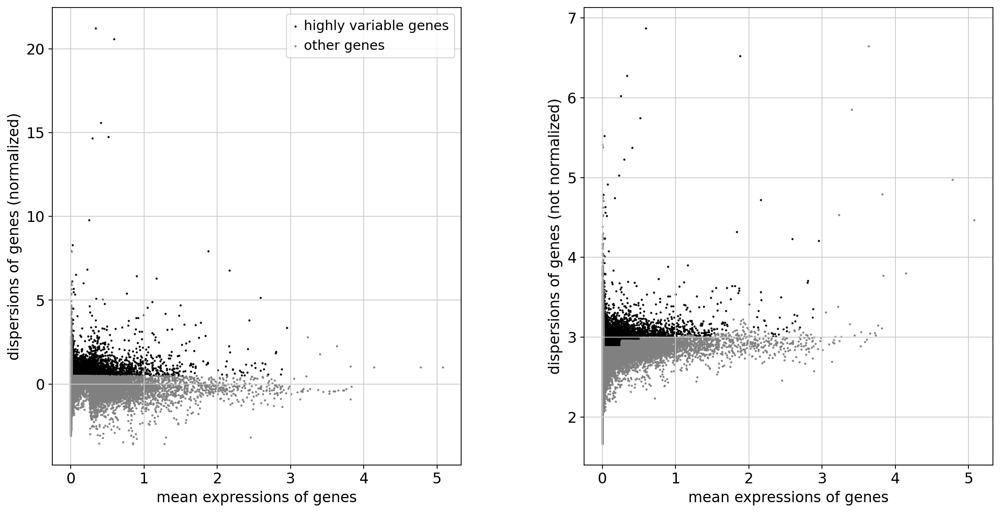

WT6MP302: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT6MP402 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:03)
extracting highly variable genes
    finished (0:00:08)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


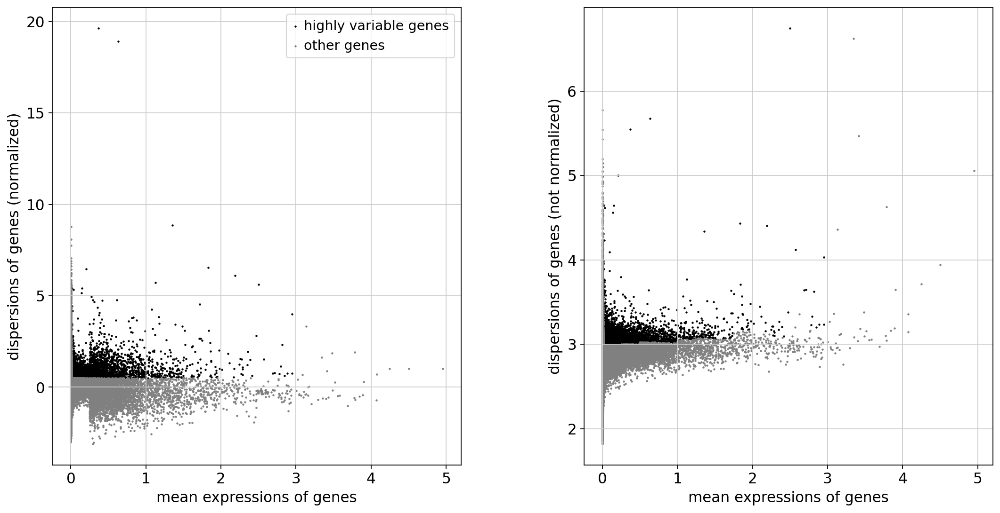

WT6MP402: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M01 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


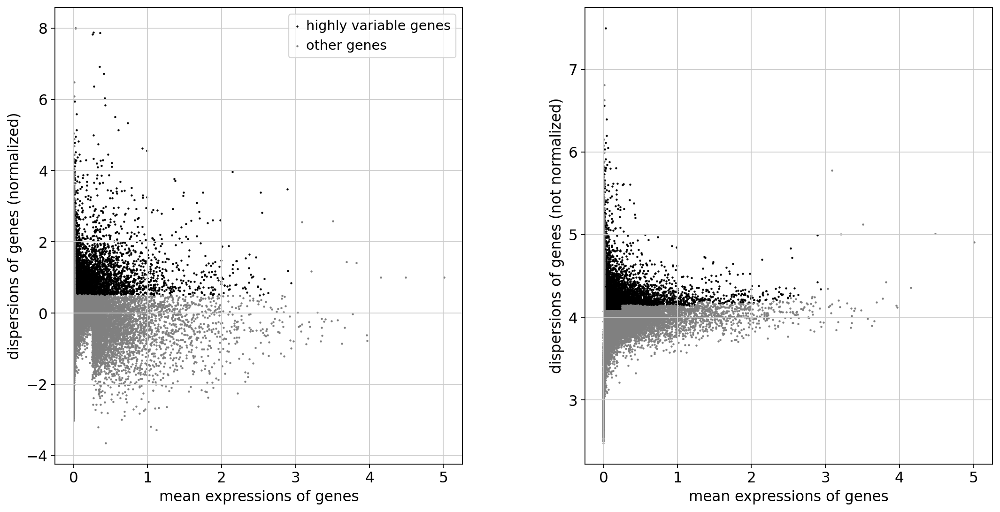

WT8M01: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M02 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


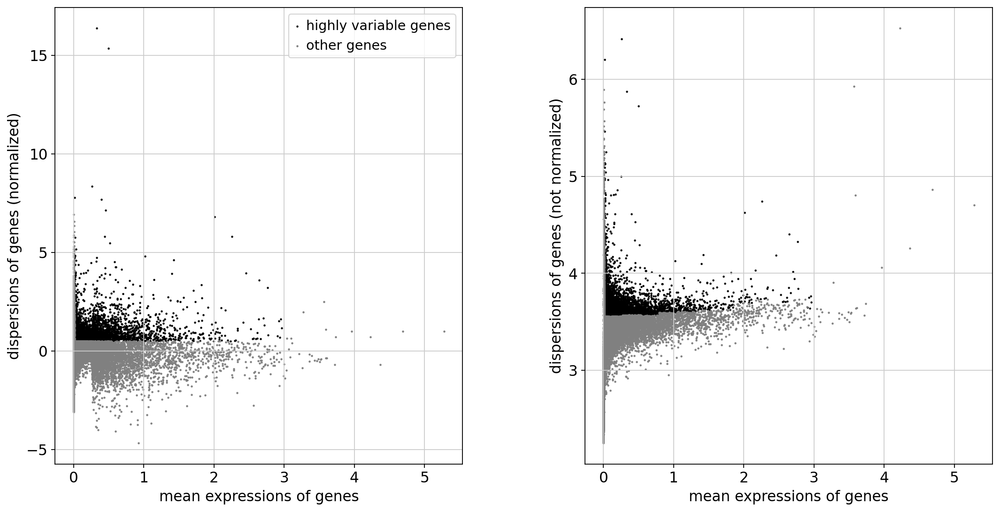

WT8M02: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M03 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


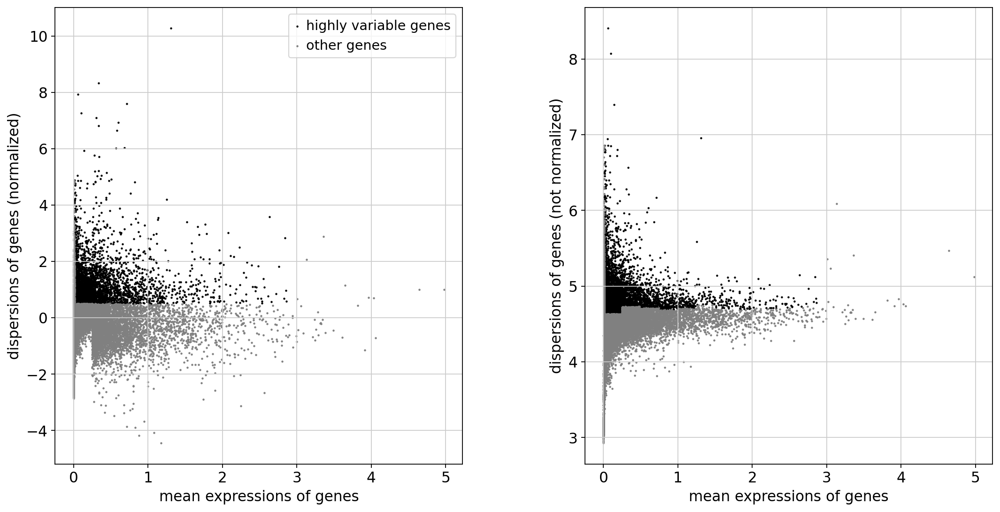

WT8M03: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M04 sample
normalizing counts per cell


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:00:01)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


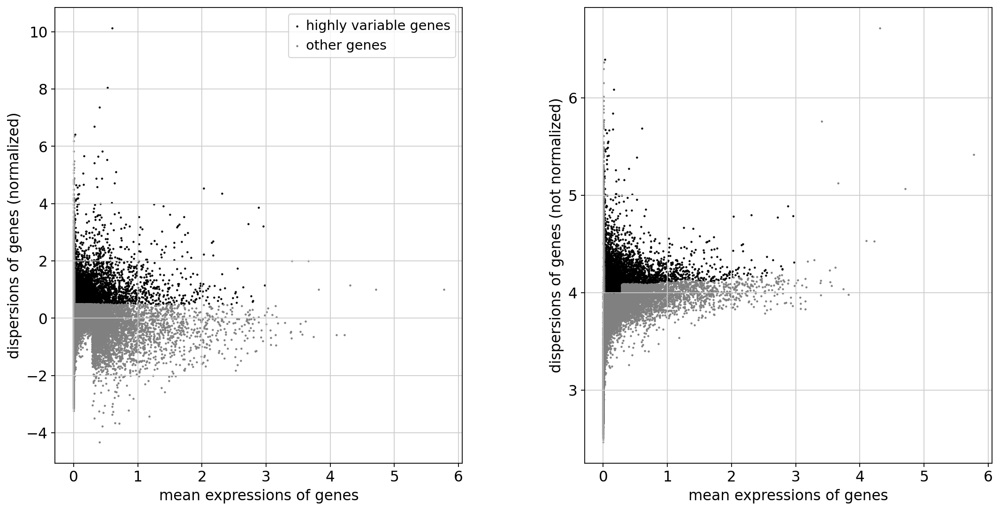

WT8M04: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M05 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


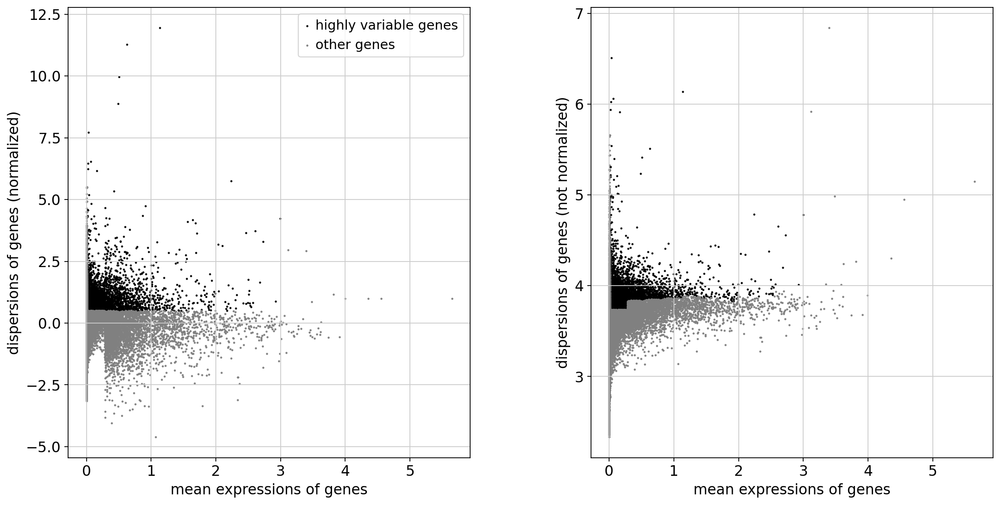

WT8M05: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.
Processing WT8M06 sample


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


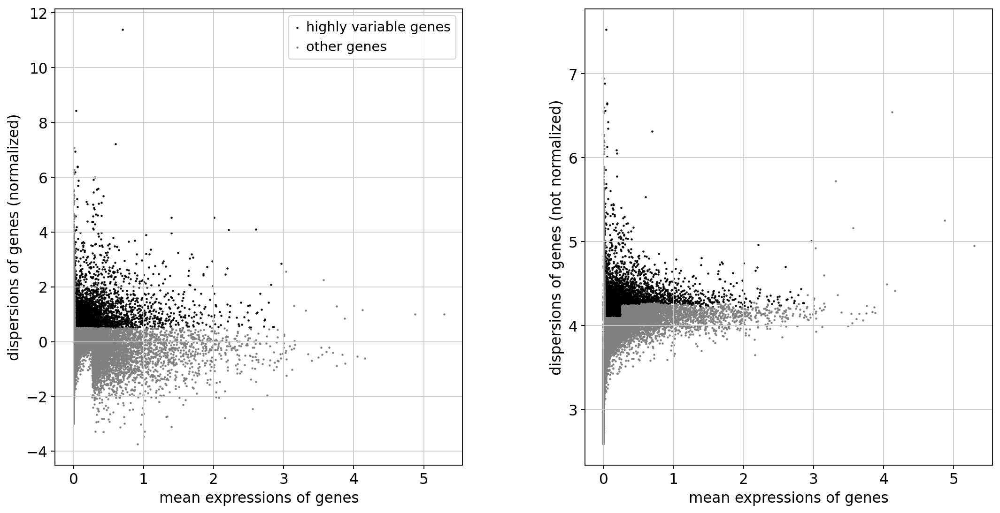

WT8M06: Could not interpret value `nCount_SCT` for `x`. An entry with this name does not appear in `data`.


In [7]:



ref_pfc = sc.read_h5ad("/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/true_sn_ref.h5ad")


ref_pfc.obs["datatype"] = "sn"

for key, adata_sample in cellbin_data.items():
    try:
        print(f"Processing {key} sample")
        adata_pdf = adata_sample.raw.to_adata()
        if len(adata_pdf) < 50: # Make sure that the cellbin data is present
            continue
        merge_adata = concatenate_and_intersect([adata_pdf, adata_pdf])
        merge_adata.layers["counts"] = merge_adata.X
        merge_adata.obs["celltype"] = merge_adata.obs["fine"].str.split("-").str[0]
        
        #  Preprocessing
        sc.pp.normalize_total(merge_adata, target_sum=1e4)
        sc.pp.log1p(merge_adata)
        sc.pp.highly_variable_genes(merge_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
        sc.pl.highly_variable_genes(merge_adata)
        merge_adata.raw = merge_adata
        merge_adata = merge_adata[:, merge_adata.var.highly_variable]
        sns.kdeplot(data = merge_adata.obs, x = "nCount_SCT", hue = "datatype")
        
        # Start regress
        sc.pp.regress_out(merge_adata, ["nCount_SCT"])
        sc.pp.scale(merge_adata, max_value=10)
        sc.tl.pca(merge_adata, svd_solver="arpack")
        
        # Harmony
        sc.external.pp.harmony_integrate(merge_adata, key="datatype")
        # Plot
        sc.pp.neighbors(merge_adata, n_neighbors=10, n_pcs=40, use_rep="X_pca_harmony")
        sc.tl.umap(merge_adata)
        merge_adata.obsm["X_harmony_umap"] = merge_adata.obsm["X_umap"]
        try:
            fig, ax = plt.subplots()
            sc.pl.umap(merge_adata, color="celltype", palette=cm.palettes.general_type_colors, ax=ax, show=False)
            plt.savefig(f"/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/regress_harmony/figure/{key}_correct_whole_celltype.png")
            plt.close(fig)  # Close the figure to free up memory
        except Exception as exc:
            print(f"Error: {key}-{exc}")
        
        try:
            mask = (merge_adata.obs["celltype"] == cell_type) & (merge_adata.obs["datatype"] == 'cellbin')
            fig, ax = plt.subplots()
            sc.pl.umap(merge_adata[mask], color="fine", palette=cm.palettes.cell_type_colors, ax=ax, show=False)
            plt.savefig(f"/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/regress_harmony/figure/{key}_correct_whole_fine_cellbin.png")
            plt.close(fig)  # Close the figure to free up memory
        except Exception as exc:
            print(f"Error: {key}-{exc}")
    
    
 
    
    

        # Convert non-string columns to strings in the `obs` data frame=                                                            
        mask = merge_adata.obs["datatype"] == 'cellbin'
        merge_adata = merge_adata[mask].copy()
        df = merge_adata.obs
        for column in df.select_dtypes(include=['object']).columns:
            df[column] = df[column].astype(str).replace('nan', 'NA')
        merge_adata.obs = df
        # Now try writing the AnnData object again
        merge_adata.write(f"/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/regress_harmony/{key}_whole_regress_harmony_cellbin.h5ad")
    except Exception as exc:
        print(f"{key}: {exc}")